# IMPORTS

In [1]:
#OS
import os

# Tensorflow imports
import tensorflow as tf
from tensorflow.keras import layers 
from tensorflow.keras.layers import MultiHeadAttention
from tensorflow import keras

# Other tensorflow compliments
import tensorflow_hub as hub
import tensorflow_text as text
import tensorflow_datasets as tfds
from tensorboard.plugins import projector

# Other python libraries
import numpy as np
import math
import random

import time
import datetime

import re
import textwrap
import json

from matplotlib import pyplot as plt
from tqdm import tqdm as tqdm

from PIL import Image
import csv

# Pandas
import pandas as pd


# Local libraries
from preprocess.pipelinesV2 import build_pipeline, build_coco_pipeline



/home/jupyter/MedClip/src/venv/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# MODEL BUILDING

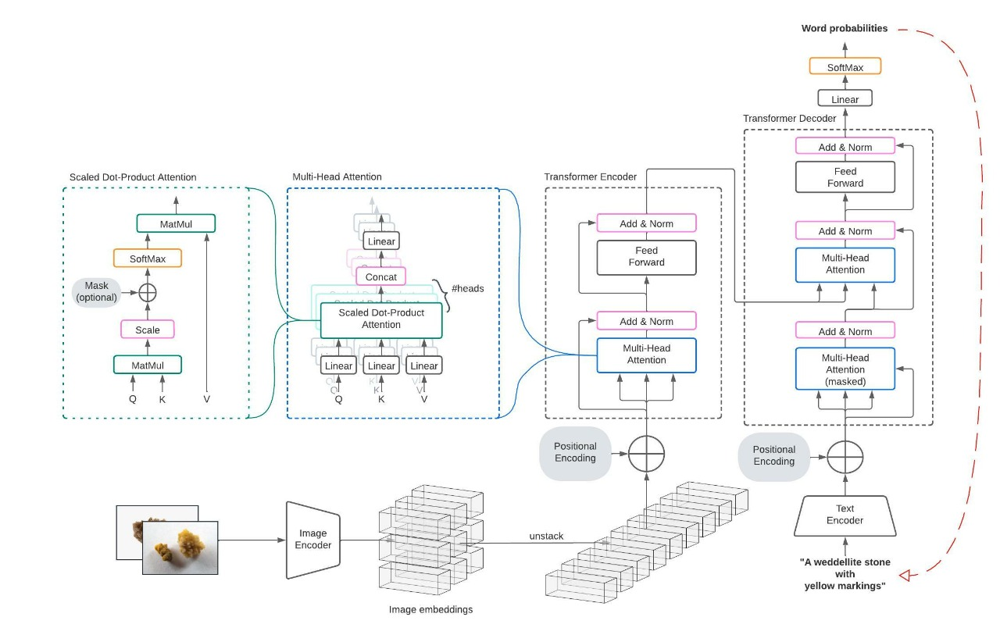

## Image encoder (model)

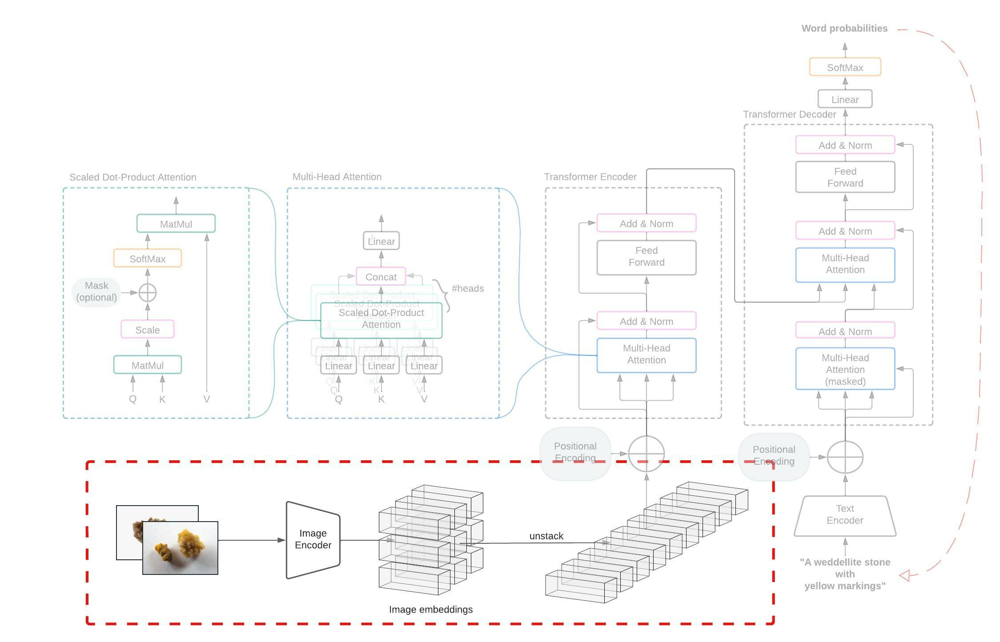

The input is a 299 by 299 image batch and the output are the image features corresponding to the last layer but they are flattened. 

In [2]:
def make_image_encoder(IMAGE_SIZE=(299,299), backbone='efficientnetb0',trainable=False):
    
    inputs=tf.keras.Input(shape=(*IMAGE_SIZE,3))

    if backbone=='efficientnetb0':
    # Notice that the images must be in float formate (299,299,3) and go from 0 to 255
        print('input images must be floats from 0 to 255 and have (299,299,3) format.') 
        base_model = tf.keras.applications.efficientnet.EfficientNetB0(input_shape=(*IMAGE_SIZE, 3), 
                                                                       include_top=False, 
                                                                       weights="imagenet",)
    if backbone=='resnet50':
    # Special preprocessing needed
     
        base_model=tf.keras.applications.resnet50.ResNet50(input_shape=(*IMAGE_SIZE, 3), 
                                                           include_top=False, 
                                                           weights="imagenet",)
    
    base_model.trainable = trainable
    base_model_out = base_model.output
    base_model_out = tf.keras.layers.Reshape((-1, base_model_out.shape[-1]))(base_model_out)
    cnn_model = tf.keras.models.Model(base_model.input, base_model_out, name='image_encoder')
    return cnn_model


In [6]:
img_encoder=make_image_encoder()


input images must be floats from 0 to 255 and have (299,299,3) format.


2023-01-25 07:05:01.176546: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 07:05:01.219959: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 07:05:01.221901: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 07:05:01.225573: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

In [ ]:
for i in 

## Transformer Encoder Block (Layer )

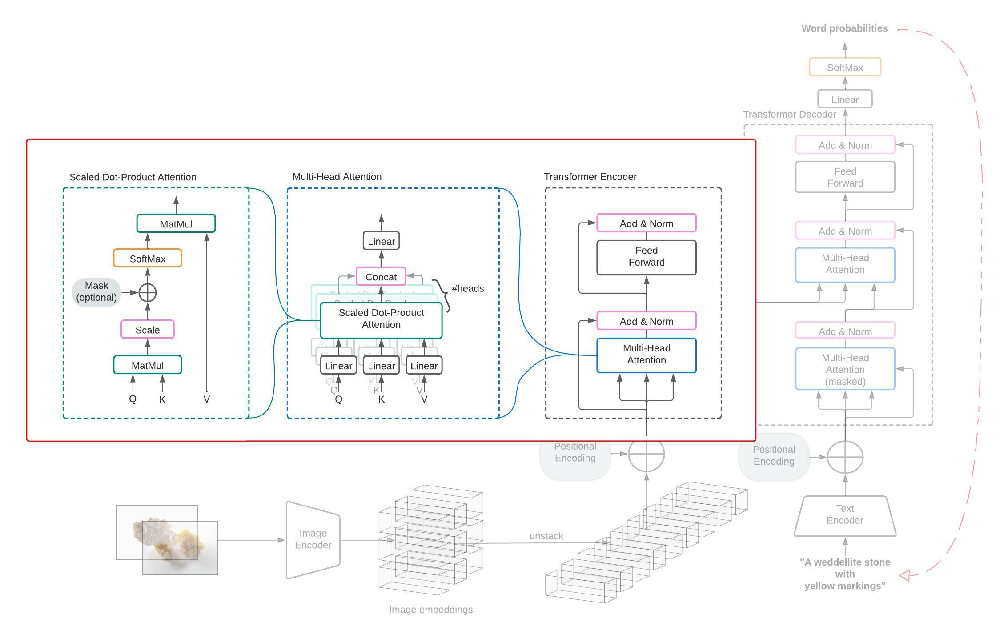

This encoder block will take convolutional vectors corresponding to different areas of the image and transform them into a sequence of values for text queries. It follows the transformer architecture: 







In [3]:
class TransformerEncoder(tf.keras.layers.Layer):
    
    def __init__(self, seq_len, embedding_dim, num_heads,dropout,**kwargs):
        super().__init__(**kwargs)
            

        self.mha = MultiHeadAttention(num_heads=num_heads,
                                      key_dim=embedding_dim,
                                      dropout=dropout)
        # Mha Q:(T,k_dim), K: (S,key_dim), V (S, v_dim)
        # T=Sequence length of query, S=Number of values to attend to. 
        # notice that there  is one key per value to attend to, meaning 
        # there are S values and S keys. 
        # The operation QxT'xV is performed, which yields dimensions
        # (T x k_dim) x (k_dim x v_dim) = T x v_dim
        # however then the result is projected 
        # back to k_dim size to yield (T x k_dim) result.  
        self.ffn = tf.keras.Sequential([tf.keras.layers.Dense(embedding_dim, activation='relu'),  # (batch_size, seq_len, dff)
                                        tf.keras.layers.Dense(embedding_dim)])                    # (batch_size, seq_len, d_model)
      
        self.norm_input = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

        self.dropout1 = tf.keras.layers.Dropout(dropout)
        self.dropout2 = tf.keras.layers.Dropout(dropout)

    def call(self, x, training=True, mask=None):

        x=self.norm_input(x)
        attn_output, att = self.mha(query=x, 
                                    value=x, 
                                    key=x, 
                                    return_attention_scores=True)  # (batch_size, input_seq_len, d_model)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)

        ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
        ffn_output = self.dropout2(ffn_output, training=training)
        out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
        
        output_dict={'embeddings':out2,'attentions':att}
        return output_dict



## Text encoder (layer within class) Abstract
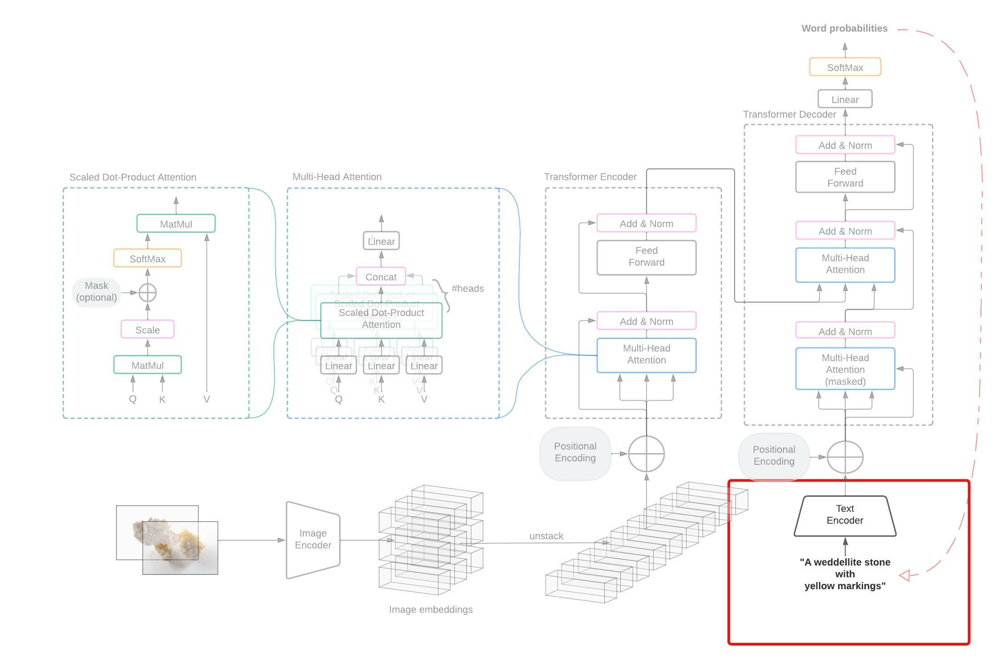









We opted to implement a class to gain access to the specific tokenizer of the text encoder (which is different for bert, clinical_bert, etc as well as the masking function). The class template must have the following methods: 
1. .mask(tokens)
2. .tokenize(text)
3. .encode(tokens)
The core layer: 
    This layer takes a string and returns vectorized string. There are several options for this one. 

In [4]:
class TextEncoder(object):
    """A text encoder and associated objects for modular implementations.

    The class is to be used within larger architectures such as the clip
    pretraining module or the captioning transformer. The class includes
    the tokenizer as well as encoding functions. 
    
    Usage: 
        encoder=TextEncoder()
        tokens=encoder.tokenizer(df)
        embeddings=encoder.encode(tokens)

    Attributes:
        
        seq_len (int): The sequence length for the outputs. 
        embedding_dim (int): The embedding dimensions. 
        projection_trainable (bool): Whether the projection head of the 
            model is trainable or not. 
        backbone_trainable (bool): Whether the backbone of the model is 
            trainable or not. 
        dropout (float): Dropout rate. 
        tokenizer(function): A tokenizer object built uisng seq_len attribute.  
        encoder(keras_model): An encoder model built on the previous attributes, 
            (seq_len,embedding_dim,projection_trainable and backbone trainable).
        start_token(str): Start token. 
        end_token(str:): End token.
        
        Start and end tokens are added to the begnning and end of captions. 
        
        
    """

    def __init__(self,seq_len=100,embedding_dim=512,projection_trainable=False,
                 backbone_trainable=False,dropout=0.1):
        """Initializes the text encoder to the default values. Builds the encoders
           and tokenizers. 
           
            Args:
                
                seq_len (int): The sequence length for the outputs. 
                embedding_dim (int): The embedding dimensions. 
                projection_trainable (bool): Whether the projection head of the 
                    model is trainable or not. 
                backbone_trainable (bool): Whether the backbone of the model is 
                    trainable or not. 
                dropout(float,optional): The dropout rate. 
               
        """
        self.seq_len=seq_len
        self.embedding_dim=embedding_dim
        self.projection_trainable=projection_trainable
        self.backbone_trainable=backbone_trainable
        self.dropout=dropout
        
        self.tokenizer=self.build_tokenizer()
        self.encoder=self.build_encoder()
    @ property
    def vocab(self):
        print('vocab property not yet implemented')
        vocab=None
        return vocab


    def build_tokenizer(self):
        """Builds the tokenizer according to the class attributes.
        
        Some subclasses may need access to the training data to build the tokenizer. 
        """
        print('build_tokenizer method called but method not implemented.')
        return None
    
    def build_encoder(self):
        """Build the encoder. 
        
        The encoder must take sequences of tokens and return 
        embeddings of size 'self.emb_dim'
        """
        print('build_encoder method called but method not implemented.')
        return None
    
    def tokenize(self,texts):
        """Apply preprocessing and tokenizes the texts.
        
        Args: 
            texts(tensor): Tensor of shape (batch_size,None) of strings. 
            
        Returns: 
            tokens(tensor):Tensor of shape (batch_size,seq_len) of token keys.
        """
       
        
        return self.tokenizer(texts)
        
    def encode(self,tokens,**kwargs):
        """Encode the tokens into vectors of size 'self.embedding_dim'
        Args: 
            tokens(tensor of ints): A tensor of shape (batch_size,self.seq_len)
                containing the token keys. 
        Returns: 
            embeddings(tensor of floats): A tensor of shape 
                (batch_size, self.seq_len, self.embedding_dim)
        """
        return self.encoder(tokens,**kwargs)
        
    def tokenize_and_encode(self,texts):
        """Apply the tokenizer and then the encoder to a sequence of texts. 
        
        Args:
            texts(iterable): A sequence of strings. 
        Returns: 
            embeddings(tensor): A tensor of shape (batch_size,slf.seq_len,self.embedding_dim)
            that contains the embedding representation of the texts. 
            
        """
        tokens=self.tokenize(texts)
        embeddings=self.encode(tokens)
        
        return embeddings
    
    def mask(self,tokens):
        """Mask 0 tokens
        Args: 
            
        """
        return tf.math.not_equal(tokens, 0)
        

## Embedding Matrix text encoder (class) 

In [5]:
class MatrixTextEncoder(TextEncoder):
    """Children of TextEncoder. Embedding matrix text encoder. 
        
    A simple text encoder composed by a tokenizer and an embedding 
    matrix. 
        
        
        
    """
    def __init__(self,tokenizer_data,**kwargs):
        """Initializes the text encoder to the default values. Builds the encoders
           and tokenizers. 
           
        Args:
            tokenizer_data(iterable): A list or array of texts on which to adapt the 
                tokenizer. 
            embedding_dim (int,optional): The embedding dimensions. Defaults to 512 
            projection_trainable (bool,optional): Whether the projection head of the 
                model is trainable or not. Defaults to False. 
            backbone_trainable (bool,optional): Whether the backbone of the model is 
                trainable or not. Defaults to False. 

        """
        self.tokenizer_data=tokenizer_data
        self.backbone=None
        self.start_token='<start>'
        self.end_token='<end>'
            
        
        # The super class is called at last because I am overriding the build_tokenizer method
        # which now requires self.tokenizer_data so we need to instantiate it first and then 
        # build the rest of attributes from super. 
        super().__init__(**kwargs)
        
    @property
    def vocabulary_size(self):
        "str: The vocabulary size of the tokenizer including OOV token"
        return self.tokenizer.vocabulary_size()
    @property
    def vocabulary(self):
        return self.tokenizer.get_vocabulary()
    @property
    def vocabulary_dict(self):
        dictionary=dict(zip(range(len(self.vocabulary)),self.vocabulary))
        return dictionary
    
    def standarize(self, input_string):
        # strip_chars = "!\"#$%&'()*+,-./:;<=>?@[\]^_`{|}~"
        # strip_chars = strip_chars.replace("<", "")
        # strip_chars = strip_chars.replace(">", "")
        # lowercase = tf.strings.lower(input_string)
        # final_string =tf.strings.regex_replace(lowercase, "[%s]" % re.escape(strip_chars), "")
        lowercase = tf.strings.lower(input_string)
        
        strip_chars = "!\"#$%&()*+;=?@[\]^_`{|}~"
        final_string =tf.strings.regex_replace(lowercase, "[%s]" % re.escape(strip_chars), "")
        
        final_string =tf.strings.regex_replace(final_string, "[%s]" % re.escape('.'), " . ")
        final_string =tf.strings.regex_replace(final_string, "[%s]" % re.escape(','), " , ")

        # Replace 1cm and 2mm for 1 cm and 2 mm
        final_string= tf.strings.regex_replace(final_string, 
                                               r'([0-9]+)(cm|mm)', 
                                               r'\1 \2', 
                                               replace_global=True, 
                                               name=None
                                               )
        
        return final_string
        
    def build_tokenizer(self):
        """ Builds and adapts the tokenizer according to the class attributes"""
        tokenizer=tf.keras.layers.TextVectorization(
                        max_tokens=None,
                        standardize=self.standarize,
                        split='whitespace',
                        ngrams=None,
                        output_mode='int',
                        output_sequence_length=self.seq_len, # Impotant to fit the ammount of characters in the string. 
                        pad_to_max_tokens=False,
                        vocabulary=None,
                        idf_weights=None,
                        sparse=False,
                        ragged=False,
                        name='Matrix_Text_Encoder_Vectorizer')
        
        tokenizer.adapt(self.tokenizer_data)
        
        return tokenizer
    
    def build_encoder(self):
        """
        Builds a keras functional model text encoder based on the class
        attributes. 
        """
        input_tokens=tf.keras.Input(shape=[None])
        embedding_matrix= tf.keras.layers.Embedding(
            input_dim=self.tokenizer.vocabulary_size(),
            output_dim=self.embedding_dim,
            embeddings_initializer='uniform',
            embeddings_regularizer=None,
            activity_regularizer=None,
            embeddings_constraint=None,
            mask_zero=False,
            input_length=None,
        )

        output_embeddings=embedding_matrix(input_tokens)
        model=tf.keras.Model(inputs=input_tokens,
                             outputs=output_embeddings,name='Matrix_Text_Encoder')
        if not self.projection_trainable:
            for layer in model.layers:
                layer.trainable=False
        
        return model
    
        
        
        

## Positional embedding (layer)

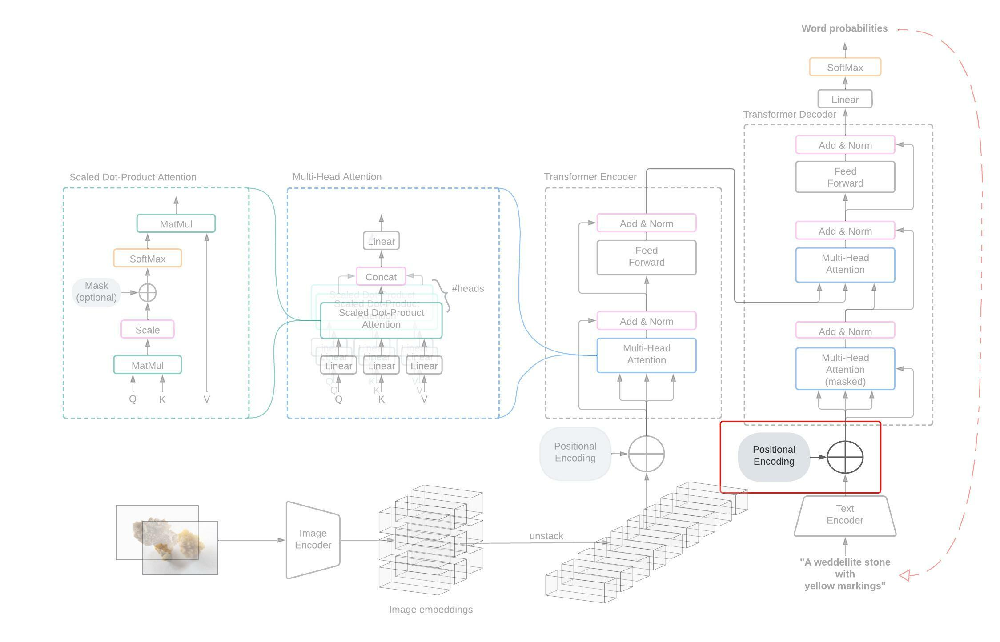


A custom layer that takes the text embeddings and learns a positional encoding to add to each index. 

In [6]:
class AddLearntPositional(tf.keras.layers.Layer):
    def __init__(self,sequence_length,embedding_dim,**kwargs):
        
        super().__init__(**kwargs)
       
        self.position_embeddings = layers.Embedding(
            input_dim=sequence_length, 
            output_dim=embedding_dim)
        
        self.tok_emb_scale=tf.math.sqrt(tf.cast(embedding_dim,tf.float32))
        self.sequence_length=sequence_length

    def call(self,inputs):
        
        length = tf.shape(inputs)[-2] # Length of the sequence
        positions = tf.range(start=0, limit=length, delta=1) # Indexes of the positions
        embedded_positions = self.position_embeddings(positions)
        output_embedding=embedded_positions
        scaled_inputs=self.tok_emb_scale*inputs
        
        return output_embedding+inputs
    

## Transformer decoder (layer)

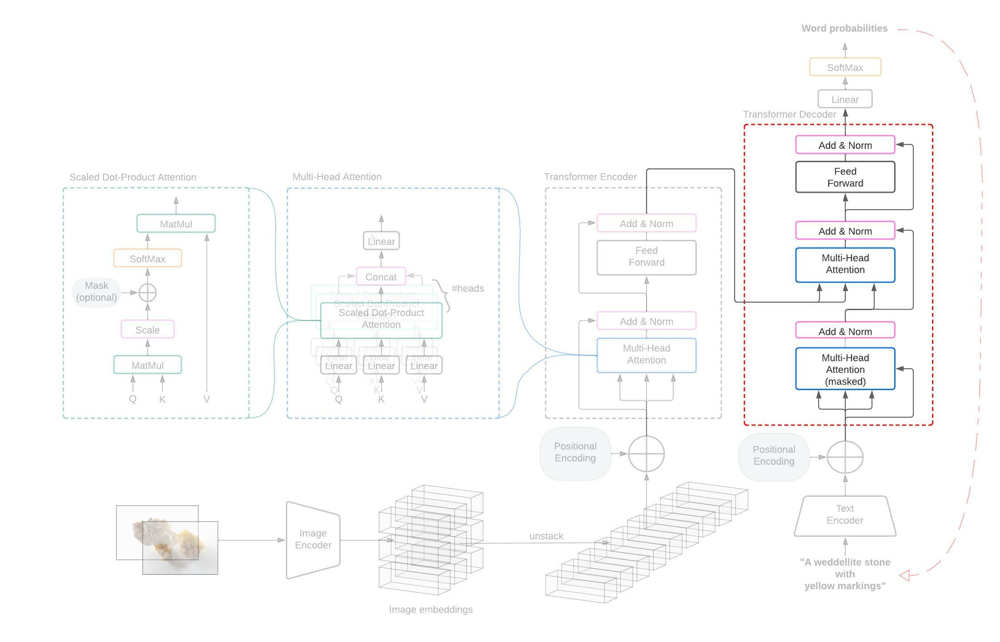

In [7]:
class TransformerDecoder(tf.keras.layers.Layer):
    def __init__(self,num_heads,embedding_dim,dropout,debug=False, **kwargs):
        super().__init__(**kwargs)
        
        self.debug=debug
        
        
        # Multi head attention modules
        self.mha1=MultiHeadAttention(num_heads=num_heads,
                                      key_dim=embedding_dim,
                                      dropout=dropout)
        self.mha2=MultiHeadAttention(num_heads=num_heads,
                                     key_dim=embedding_dim,
                                     dropout=dropout)
        
        # Layer normalizations
        self.layer_norm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layer_norm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layer_norm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        
        # Feed forward network 
        self.feed_forward = tf.keras.Sequential([
            tf.keras.layers.Dense(embedding_dim,activation='relu'),
            tf.keras.layers.Dropout(dropout),
            tf.keras.layers.Dense(embedding_dim),
            tf.keras.layers.Dropout(dropout)])
        
    def call(self,inputs, image_embedding_sequence, mask=False):
        # Mask the inputs if the option to mask inputs is provided
        debug=self.debug
        if debug:
            print('\n\nTransformer decoder called\n-------------------')
        if debug:
            print('calculating masks ')
        if mask is not None:
            causal_mask = self.get_causal_attention_mask(inputs)
            padding_mask = tf.cast(mask[:, :, tf.newaxis], dtype=tf.int32)
            combined_mask = tf.cast(mask[:, tf.newaxis, :], dtype=tf.int32)
            combined_mask = tf.minimum(combined_mask, causal_mask)
        if debug: 
            print(f'combined mask: {combined_mask.shape}')
        # Pass inputs through first attention head using masking
        if debug:
            print(f'going through attention head 1:\n\t inputs:{inputs.shape}')
        x = self.mha1(
            query=inputs,
            value=inputs,
            key=inputs, 
            attention_mask=combined_mask
            )
        # Add and normalize
        if debug:
            print(f'going thorugh layer normalization 1:\n\t inputs:{inputs.shape}\n\t x:{x.shape}')
        x1=self.layer_norm1(x+inputs)
        
        # Pass inputs throught second attention head
        if debug:
            print(f'going thorugh mha 2: \n\t x1:{x1.shape}\n\t image\
            _embedding_sequence:{image_embedding_sequence.shape}')
        x2=self.mha2(
            query=x1,
            key=image_embedding_sequence,
            value=image_embedding_sequence,
            attention_mask=padding_mask
            
            )
        # Add and normalize
        if debug:
            print(f'going thorugh addnorm2:\n\t x2:{x2.shape}')
        x2=self.layer_norm2(x1+x2)
        
        # Pass inputs through feed forward network
        if debug:
            print(f'going thorugh feed forward:\n\t x2:{x2.shape}')
        x3=self.feed_forward(x2)
        
        # Add and normalize
        if debug:
            print(f'layer normalization:\n\t x2:{x2.shape}\n\t x3:{x3.shape}')
        x3=self.layer_norm3(x2+x3)
        return x3
    
    
    def get_causal_attention_mask(self, inputs):
        
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        
        mult = tf.concat([tf.expand_dims(batch_size, -1), 
                          tf.constant([1, 1], 
                          dtype=tf.int32)],
                          axis=0,)
        
        return tf.tile(mask, mult)
    
        

## Captioning Model (Subclassed Model)
Putting it all together in a subclassed model

In [8]:
class CaptioningTransformer(tf.keras.Model):
    """Makes a transformer based captioning model.

    If the class has public attributes, they may be documented here
    in an ``Attributes`` section and follow the same formatting as a
    function's ``Args`` section. Alternatively, attributes may be documented
    inline with the attribute's declaration (see __init__ method below).

    Properties created with the ``@property`` decorator should be documented
    in the property's getter method.

    Attributes:
        image_size (touple): Height and width of the image taken by the model. 
        
        image_encoder (model): A model that takes images (None, H,W,3) 
            and produces a unstacked convolutional volume (None, positions(HxW) ,emb_length)
        attr2 (:obj:`int`, optional): Description of `attr2`.

    """

    def __init__(self,image_encoder, text_encoder, 
                 transformer_encoder, transformer_decoder,
                 embedding_dim,num_heads,vocab_size,captions_per_image,
                 debug=False,**kwargs):
        
        super().__init__(**kwargs)
        
        self.embedding_dim=embedding_dim
        self.image_encoder=image_encoder
        self.image_projector=tf.keras.layers.Dense(embedding_dim)
        self.text_encoder=text_encoder
        self.text_encoder_encoder=text_encoder.encoder
        self.text_enocder_tokenizer=text_encoder.tokenizer
        self.text_projector=tf.keras.layers.Dense(embedding_dim)
        self.seq_len=text_encoder.seq_len
        self.num_heads=num_heads
        self.add_positional_img= AddLearntPositional(image_encoder.output.shape[-2],self.embedding_dim)
        self.add_positional_txt= AddLearntPositional(self.seq_len,self.embedding_dim)
        self.transformer_encoder=transformer_encoder
        self.transformer_decoder=transformer_decoder
        self.vocab_size=vocab_size
        self.debug=debug
        self.captions_per_image=captions_per_image
    
        # The output model, is responsible of taking the decoder sequence output and 
        # translating it to probabilities of the words in the vocab. For now, 
        # it will be a sigmoid with the vocab size. However we may explore other ways 
        # in the future such as distance metrics or similarity between output embeddings and 
        # target wordd embeddings. 
        self.out=tf.keras.layers.Dense(self.vocab_size,activation='softmax')
        
        # Trackers: These 
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.acc_tracker = keras.metrics.Mean(name="accuracy")
        
   
    @property
    
    def metrics(self):
        # We need to list our metrics here so the `reset_states()` can be
        # called automatically.
        return [self.loss_tracker, self.acc_tracker]
    
    def train_step(self, batch_data):
        
        debug=self.debug
        # Unpack data 
        if debug:
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_inputs=batch_data['text']

        batch_acc=0
        batch_loss=0
        for i in range(self.captions_per_image):
            text_input=text_inputs[:,i]
            with tf.GradientTape() as tape:
            # Forward pass
                # Pass text through text encoder
                if debug:
                    print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')

                # Split the predictor text from the target text.
                all_tokens=self.text_encoder.tokenize(text_input)
                predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
                # Get the mask from the targets. 
                
                mask=self.text_encoder.mask(y_true)
                
                if debug:
                    print(f'The mask has dimensions {mask.shape}')

                # Pass image through all image layers
                # (encoding, projection, positional encoding, transformer encoder)
                image_encoding=self.full_encoder(image_input,debug=debug)
                
                # Decode the embeddings using the queries provided by the 
                # predictor tokens.
                y_pred=self.full_decoder(predictor_tokens,image_encoding,mask,debug=debug)

                if debug:
                    print('Calculating loss')
                    print(f'Predictions shape: {y_pred.shape}\ny_true shape{y_true.shape}')

                loss=self.calculate_loss(y_true,y_pred,mask)
                    
            # Compute gradients
            if debug:
                print('computing gradients')
            gradients = tape.gradient(loss, self.trainable_variables)
            
            # Apply gradients
            if debug:
                print('applying weights')
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))
            
            # update batch loss
            batch_loss+=loss
            
            # coumpute accuracy and update batch_accuracy
            if debug:
                print('Computing accuracy')
            acc=self.calculate_accuracy(y_true,y_pred,mask)
            batch_acc+=acc
            
        # Update loss trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc/self.captions_per_image)

        return {"loss": self.loss_tracker.result(),
                "acc": self.acc_tracker.result()}
      
    def full_encoder(self, image_input,debug=False):
        """
        Apply image encoding layers to image input. 
        
        Apply the image encoder, transformer encoder and image projection layers
        to the image. This is known as the "encoder" in the "encoder-decoder" 
        architecture. Notice that it is called "full-encoder" here because it is
        made of several layers. These are: 
        1. Pass image through image encoder. 
        2. Project image encodings to the dimension of the transformer model. 
        3. Pass projected image encodings through transformer encoder. 
        """
        # Pass image through image encoder. 
        if debug:
            print(f'pass through image encoder:\n\t image_input:{image_input.shape}')
        image_embeddings_0=self.image_encoder(image_input)
        # Project image embeddings to right dimension
        image_embeddings_1=self.image_projector(image_embeddings_0)
        # Add positional encoding
        if debug:
            print(f'Adding positional encoder to image embeddings:\n\t image_embeddings: {image_embeddings_1.shape}')
        image_embeddings_2=self.add_positional_img(image_embeddings_1)

        # Pass image encoder outputs through transformer encoder
        image_embeddings_3=self.transformer_encoder(image_embeddings_2)['embeddings']
        return image_embeddings_3
        
    def full_decoder(self,predictor_tokens,image_embeddings,mask,debug=False):
        """
        Decode the predictor_tokens and the image_embeddings into the
        predictions for words at each slot in the target. 
        
        Args: 
            predictor_tokens: The left part of the training sequence used to 
                predict the right part of the sequence. It must already be 
                tokenized.
            image_embeddings: The result of the full_encoding process of the 
                image. 
            mask: Masking of the empty tokens of the target sequence.
        Returns:
            probs: The probabilities for every word in the output sequence. 
                Probs have shape (None,seq_len,vocab_size)
        """
        # Use text encoder to get embeddings from tokens. 
        token_embeddings=self.text_encoder.encode(predictor_tokens)
        # Project text encodings to right shape for transformer
        if debug:
            print(f'going thorugh text_projector:\n\t embeddings:{token_embeddings.shape}')
        token_embeddings=self.text_projector(token_embeddings)
        # Add positional encoding.
        if debug: 
            print(f'adding positional embeddings to text \n\t embeddings:{token_embeddings.shape}')
        queries=self.add_positional_txt(token_embeddings)
        
         # Go through transformer decoder. 
        if debug:
            print(f'going through decoder\n\t image_embedding_sequence:{image_embeddings.shape}'+
                  f'\n\t text_embedings:{queries.shape} ')
        prediction_context= self.transformer_decoder(queries, 
                                                     image_embedding_sequence=image_embeddings, 
                                                     mask=mask)
        # Compute loss.
        probs=self.out(prediction_context)
        return probs
    
    def calculate_loss(self, y_true, y_pred, mask):
        """
        Calculates the loss and masks it 
        
        Args:
        y_true: Batch of tokens with dimension (None,seq_len-1)
            (-1 because of the left shifting of the input sequence)
        y_pred: A batch of probabilities
        
        """
        loss = self.loss(y_true, y_pred)
        mask = tf.cast(mask, dtype=loss.dtype)
        loss *= mask
        loss= (tf.reduce_sum(loss) / tf.reduce_sum(mask))
        # if math.isnan(loss):
        #     print('loss is nan')
        #     print(f'mask:\n {tf.reduce_sum(mask)}')
        #     print(f'y_true:\n {y_true}')
        #     print(f'y_pred:\n {y_pred}')
        
        return loss
    
    def calculate_accuracy(self, y_true, y_pred, mask):
        # Argmax get's the index of the max across the vocabulary dimension. 
        accuracy = tf.equal(y_true, tf.argmax(y_pred, axis=2))
        
        # The logical and avoids counting correct 
        # predictions of values that are masked
        accuracy = tf.math.logical_and(mask, accuracy)
        
        # Ture values are casted to 1. 
        accuracy = tf.cast(accuracy, dtype=tf.float32)
        mask = tf.cast(mask, dtype=tf.float32)
        
        return tf.reduce_sum(accuracy) / tf.reduce_sum(mask)
   
    def test_step(self,batch_data):
        
        debug=self.debug
        # Unpack data 
        if debug:
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_inputs=batch_data['text']

        batch_acc=0
        batch_loss=0
        
        for i in range(self.captions_per_image):
            text_input=text_inputs[:,i]
            # Forward pass
            # Pass text through text encoder
            if debug:
                print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')

            # Split the predictor text from the target text.
            all_tokens=self.text_encoder.tokenize(text_input)
            predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
            # Get the mask from the targets. 
            mask=self.text_encoder.mask(y_true)

            # Pass image through all image layers
            # (encoding, projection, positional encoding, transformer encoder)
            image_encoding=self.full_encoder(image_input,debug=debug)

            # Decode the embeddings using the queries provided by the 
            # predictor tokens.
            y_pred=self.full_decoder(predictor_tokens,image_encoding,mask,debug=debug)

            if debug:
                print('Calculating loss')
                print(f'Predictions shape: {y_pred.shape}\ny_true shape{y_true.shape}')

            loss=self.calculate_loss(y_true,y_pred,mask)
                                 
            # update batch loss
            batch_loss+=loss
            
            # coumpute accuracy and update batch_accuracy
            if debug:
                print('Computing accuracy')
            acc=self.calculate_accuracy(y_true,y_pred,mask)
            batch_acc+=acc
            
        # Update loss trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc/self.captions_per_image)

        return {"loss": self.loss_tracker.result(),
                "acc": self.acc_tracker.result()}
        



## Function to instantiate the captioner

In [9]:
def instantiate_captioner(params,data_pipeline):
    """
    Instantiates a captioning model. 
    
    Args: 
        params(dict): A dictionary of parameters for the model 
        data_pipeline(pipeline): A pipeline made by the make_pipeline function
    Returns 
        model(tf model): The captioner model
    """
  
    
    
    tokenizer_data=data_pipeline['captioning']['train_captions'].take(1000)            # Get the captions to fit tokenizer

    print('Building text encoder')
    text_encoder=MatrixTextEncoder(seq_len=params['SEQ_LEN'],                # Make text encoder
                                   embedding_dim=params['EMBEDDING_DIM'],
                                   tokenizer_data=tokenizer_data,
                                   projection_trainable=True,
                                   backbone_trainable=True)
    
    print('Building rest of the model')
    image_encoder=make_image_encoder(params['IMG_SIZE'],                      # Make image encoder
                                     backbone=params['IMG_BACKBONE'],
                                     trainable= params['IMG_TRAINABLE'])
    
    transformer_encoder=TransformerEncoder(params['SEQ_LEN'],                 # Make transformer encoder
                                           params['EMBEDDING_DIM'],
                                           params['NUM_HEADS'], 
                                           params['DROPOUT'])
    
    transformer_decoder=TransformerDecoder(params['NUM_HEADS'],             # Make transformer decoder
                                           params['EMBEDDING_DIM'],
                                           params['DROPOUT'])

   
    VOCAB_SIZE=text_encoder.vocabulary_size   
   
    model=CaptioningTransformer(image_encoder,                             # Build the captioner model 
                                text_encoder,             
                                transformer_encoder,
                                transformer_decoder,
                                params['EMBEDDING_DIM'],
                                params['NUM_HEADS'],
                                VOCAB_SIZE,captions_per_image=5)
    return model

# RUNNING THE MODEL

## Instantiate Model

In [10]:

#Settings
params={
    'IMG_SIZE':(299,299),
    'IMG_BACKBONE':'efficientnetb0',
    'IMG_TRAINABLE':False,
    'EMBEDDING_DIM':100,
    'SEQ_LEN':100 ,
    'NUM_HEADS':2,
    'DROPOUT':0.01,
    'DATA_PATH':'../data/intermediate/inter_medpix.csv',
    'DATA_SPLIT':[0.9,0.05,0.05],
    'DATA_DOWNSCALE':False,               
    'LEARNING_RATE': 1.35e-4,
}

# data_pipeline= build_pipeline(inter_dataset_path=params['DATA_PATH'],
#                               image_size=params['IMG_SIZE'],
#                               train_val_test_split=params['DATA_SPLIT'])
data_pipeline= build_coco_pipeline()

model= instantiate_captioner(params,data_pipeline)  # Instantiate the model

Loading coco...
remember coco dataset has 5 captions per image so  the value for the "text" key will be a (5,) string array.


2023-01-25 19:58:39.603419: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 19:58:39.616764: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 19:58:39.618660: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-25 19:58:39.625324: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

Building text encoder
Building rest of the model
input images must be floats from 0 to 255 and have (299,299,3) format.


## Callbacks and checkpointing

### The captioning callback

In [11]:
class CaptioningCallback(tf.keras.callbacks.Callback):
    """ A callback that logs the paremeter dictionary of the model.
    """
    def __init__(self,params,log_dir):
        """
        Initialize the callback. 
        
        Args:
            params(dict): The parameters of the model.
            log_dir(str): Path to the model tensorboard log.  
        """
        super().__init__()
        self.model_params=params
        self.log_dir=log_dir
        
    def on_train_begin(self,logs=None):
        """
        Log the model parameters. 

        """
        file_writer = tf.summary.create_file_writer(self.log_dir) 
        with file_writer.as_default():
            tf.summary.text("model_params", self.pretty_json(self.model_params), step=0)
        
    def on_epoch_end(self, epoch,logs):
        ''' 
        Log bleu metrics (not implemented yet).
        '''
        pass
    
    def pretty_json(self,hp):
        """Dumps dictionary into a formatted string.  
        
        Args: 
           hp(dict): The parameters dictionary
        
        Returns:
            json_hp(str): A formatted string with the contents of the hp dict
        """
        json_hp = json.dumps(hp, indent=2)
        return "".join("\t" + line for line in json_hp.splitlines(True))

### Define the savepath

In [12]:
# Define checkpoints path
date_str=datetime.datetime.now().strftime("%Y%m%d-%H%M%S") # Get the date
save_model_path='../models/pretraining/captioning/' + date_str # build savepath

# Define logs path
log_dir='../model_logs/pretraining/captioning/'+date_str # The logs directory


### Instantiate callbacks

In [13]:
# Define callbacks
# Since model is subclassed we save weights only.
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint( # Callback to save the model every epoch end
        filepath=save_model_path,
        save_weights_only=True,
        monitor='val_loss',
        mode='min',
        save_best_only=True)

tensorboard_callback=tf.keras.callbacks.TensorBoard(  # Callback to log loss and accuracy every epoch
    log_dir=log_dir,
    histogram_freq=None,
    write_graph=True,
    write_images=False,
    write_steps_per_second=False,
    update_freq='epoch',
    profile_batch=0,
    embeddings_freq=1,
    embeddings_metadata=None)

captioning_callback= CaptioningCallback(params=params,
                                       log_dir=log_dir)



    




        


        

## Compile and Train

In [14]:
train_data=data_pipeline['captioning']['train'].batch(32)
validation_data=data_pipeline['captioning']['val'].batch(32)
loss=tf.keras.losses.SparseCategoricalCrossentropy(reduction='none',from_logits=False)
opt = keras.optimizers.Adam(learning_rate=params['LEARNING_RATE'])

# Define learning rate decay ----------------------------
# lr_schedule = keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate=4e-5,
#     decay_steps=100,
#     decay_rate=1.5)
# opt = keras.optimizers.Adam(learning_rate=lr_schedule)
#---------------------------------------------------------
model.compile(loss=loss, optimizer=opt)


model.fit(train_data,validation_data=validation_data,epochs=200,callbacks=[checkpoint_callback,
                                                                           tensorboard_callback,
                                                                           captioning_callback])
# Code bellow to try quick fit with subset of data and 1 epoch. 
# model.fit(train_data.take(100),
#           validation_data=validation_data.take(10),
#           epochs=100,
#           callbacks=[checkpoint_callback, # We include the three callbacks
#                      tensorboard_callback,
#                      captioning_callback])

Epoch 1/200


2023-01-25 19:59:32.707218: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8200


  47/2587 [..............................] - ETA: 29:02 - loss: 31.7029 - acc: 0.1499

KeyboardInterrupt: 

# MAKING CAPTIONS

In [97]:
# # Remember to create the object model and call it on some data fist
# path='../models/pretraining/captioning/20220814-170749' 
# model.load_weights(path)
def test_step(batch_data,self=model):
        debug=self.debug
        # Unpack data 
        if debug:
            print('test_step')
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_input=batch_data['text']
        
        # Forward pass
        # Pass text through text encoder
        if debug:
            print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')


        # Split the predictor text from the target test. 
        all_tokens=self.text_encoder.tokenize(text_input)
        predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
        mask=self.text_encoder.mask(predictor_tokens)
        embeddings=self.text_encoder.encode(predictor_tokens)

        # Project text encodings to right shape
        if debug:
            print(f'going thorugh text_projector:\n\t embeddings:{embeddings.shape}')
        embeddings=self.text_projector(embeddings)

        # Add positional encoding.
        if debug: 
            print(f'adding positional embeddings to text \n\t embeddings:{embeddings.shape}')
        text_embeddings=self.add_positional_txt(embeddings)

        # Pass image through image encoder. 
        if debug:
            print(f'pass through image encoder:\n\t image_input:{image_input.shape}')
        image_embeddings_0=self.image_encoder(image_input)
        # Project image embeddings to right dimension
        image_embeddings_1=self.image_projector(image_embeddings_0)

        # Add positional encoding
        if debug:
            print(f'Adding positional encoder to image embeddings:\n\t image_embeddings: {image_embeddings.shape}')
        image_embeddings_2=self.add_positional_img(image_embeddings_1)

        # Pass image encoder outputs through transformer encoder
        image_embeddings_3=self.transformer_encoder(image_embeddings_2)['embeddings']


        # Go through decoder. 
        if debug:
            print(f'going through decoder\n\t image_embedding_sequence:{image_embeddings.shape}'+
                  f'\n\t text_embedings:{text_embeddings.shape} ')
        prediction_context= self.transformer_decoder(text_embeddings, 
                                                     image_embedding_sequence=image_embeddings_3, 
                                                     mask=mask)
        # Compute loss.
        y_pred=self.out(prediction_context)
        return y_pred

  0%|          | 0/1434 [00:00<?, ?it/s]

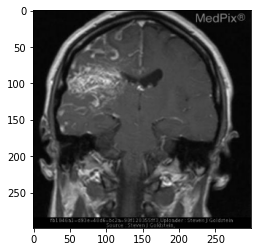

  0%|          | 1/1434 [00:08<3:11:40,  8.03s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: mri- confirms avm with multiple serpentine vascular structures that are vessels from the avm .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: multiple enhancing lesions with some of the basal ganglia . no mass effect or pathologic enhancement .


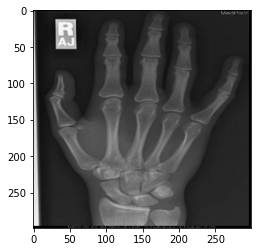

  0%|          | 2/1434 [00:28<6:00:42, 15.11s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: musculoskeletal findings: normal pa view of right hand


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap and lateral radiographs of the left hand demonstrate a non-displaced fracture of the left femoral neck fracture with a non-displaced fracture . there is a fracture lucency at the distal radial metaphysis is a narrow zone of the distal femur . there is no evidence of the distal femur . there is no evidence of fracture fragments . there is no evidence of the fracture lucency or periosteal reaction or dislocation .


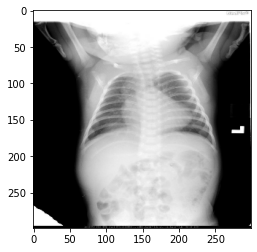

  0%|          | 3/1434 [00:37<5:03:23, 12.72s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: cardiovascular findings: frontal view of the chest shows no areas of consolidation . there is a right sided aortic arch with [UNK] of the cardiac apex .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: frontal radiograph of the chest radiograph demonstrates a large mass in the left hemithorax , and gas , and pulmonary nodules .


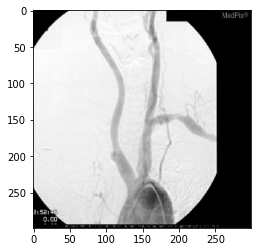

  0%|          | 4/1434 [00:49<4:49:58, 12.17s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: ap anatomy: pulmonary findings: aortic arch injection - early phase . the aortic arch angiogram reveals a proximal occlusion of the right subclavian artery just after the origin of the right common carotid from the brachiocephalic innominate artery . in this lao projection , the left common carotid artery [UNK] the proximal left subclavian . but , if you look carefully , you can both vessels . note the other irregularities from [UNK] lesions , including mild stenosis of the left subclavian distal to the vertebral artery origin .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: selective catheterization of right ica in right ica in right ica , left mca , with embolization and right ica angiogram confirms avm .


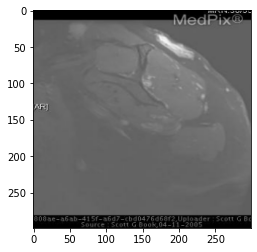

  0%|          | 5/1434 [00:59<4:30:35, 11.36s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: sagittal anatomy: musculoskeletal findings: highly enhancing lesion with serpentine areas in subcutaneous fat over rotator cuff .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: sagittal anatomy: musculoskeletal findings: sagittal t1-weighted image demonstrates a high signal intensity lesion in the left femoral neck with high signal intensity on t2 weighted images .


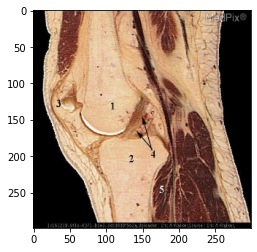

  0%|          | 6/1434 [01:23<6:12:19, 15.64s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: sagittal anatomy: musculoskeletal findings: sagittal notch lateral 1 . medial femoral condyle 2 . medial tibila plateau 3 . patella 4 . anterior cruciate ligament acl 5 . popliteus muscle


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: sagittal anatomy: musculoskeletal findings: coronal gross section 02 1 . distal clavicle 3 . medial tibial plateau 3 . medial meniscus 2 . medial tibial plateau 3 . medial tibial plateau 3 . medial tibial plateau 3 . medial tibial plateau 3 . medial tibial plateau 3 . medial meniscus 3 . medial meniscus 3 . medial femoral condyle 2 . medial tibial plateau 3 . medial meniscus 3 . glenoid 3 . acromion 4 . medial . medial meniscus 3 . medial meniscus is medial meniscus with medial .


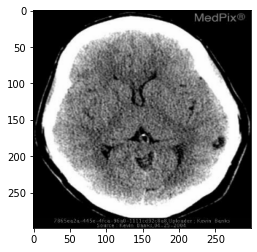

  0%|          | 7/1434 [01:31<5:16:00, 13.29s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct demonstrates a well defined extra-axial cystic lesion deep within a sulci of the left temporal lobe with no surrounding edema .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct scan hemorrhagic mass in right frontal lobe . temporal and parietal lobes . no restricted diffusion .


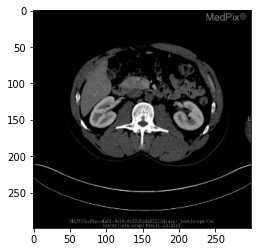

  1%|          | 8/1434 [01:44<5:10:54, 13.08s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct with contrast immediately inferior to the origin of the renal arteries demonstrates no contrast within the abdominal aorta , consistent with thrombosis of the abdominal aorta .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct of the abdomen demonstrates a tubular structure coursing between the liver , and the liver . the liver is dilated , there is no evidence of hydronephrosis or intraperitoneal air .


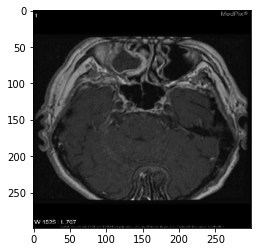

  1%|          | 9/1434 [01:52<4:35:53, 11.62s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: head and neck findings: axial t1 post gadolinium image through the level of the maxillary sinuses demonstrates peripheral rim enhancement of a homogeneous hypointense mass within the right maxillary sinus with extension into the adjacent nasal passage .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: axial t1 post contrast mr image demonstrates a large mass in the right cerebellopontine angle cistern .


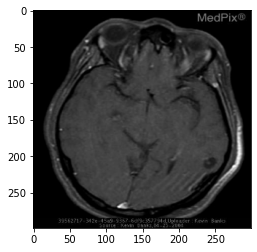

  1%|          | 10/1434 [02:00<4:11:25, 10.59s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: coronal anatomy: brain findings: axial post-contrast t1 weighted image with fat saturation technique shows no enhancement of the lesion along the left temporal lobe .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: multiple enhancing lesions with some of the basal ganglia . no mass effect or pathologic enhancement .


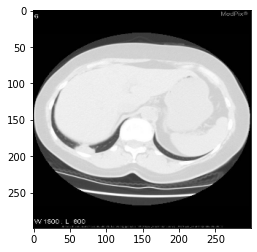

  1%|          | 11/1434 [02:11<4:13:52, 10.70s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: cardiovascular findings: lung windows confirm a peripheral wedge shaped opacity in the posterior basal segment of the right lower lobe .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct images of the chest demonstrate a large , lobulated , lobulated , lobulated , nodule , irregular , irregular , nodular , pleural effusions , lung mass .


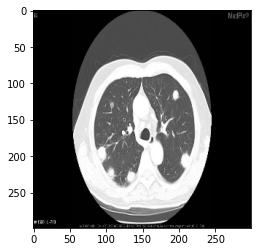

  1%|          | 12/1434 [02:22<4:16:20, 10.82s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: random [UNK] nodules - makes one [UNK] of hematogenous metastatic disease . notice feeding vessels to the nodules .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the upper lobe of the right upper lobe and lung zone of pleural effusion .


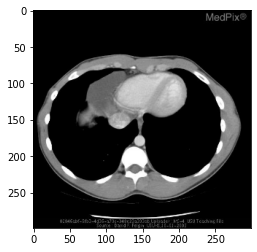

  1%|          | 13/1434 [02:36<4:32:08, 11.49s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: ct: homogenous fluid attenuating and smoothly marginated lesion abutting the right cardiac border with hounsfield attenuation unit 7 measures 5 x 4 . 4 x 7 cm


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: axial ct image through the chest demonstrates a large mass in the left lower lobe , lingula , with associated with associated soft tissue mass . low density mass effect on the right lower lobe .


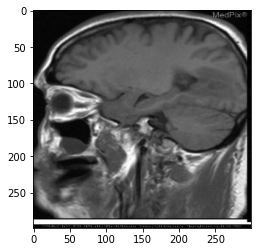

  1%|          | 14/1434 [02:43<4:05:47, 10.39s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: left occiptal lobe mass


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: multiple lesions with some of the basal ganglia and cortical gray matter . no restricted diffusion .


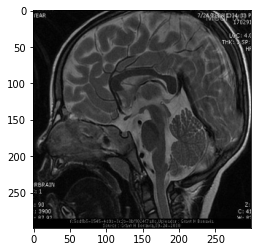

  1%|          | 15/1434 [02:53<4:02:40, 10.26s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: brain findings: midline sagital t2 mr image demonstrates high signal intensity tract in the midline nasofrontal calvarium and mixed signal intensity mass in the region of the fonticulus frontalis .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: complex mass with cystic and solid components . mass is isointense on t1 and t2 sequences . no enhancement following contrast administration .


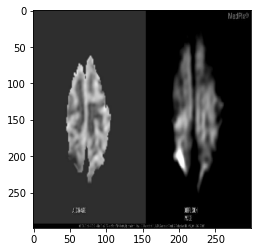

  1%|          | 16/1434 [03:01<3:41:38,  9.38s/it]

ORIGINAL ----------------
core modality: mr modality: mr - adc map app diff coeff plane: axial anatomy: brain findings: axial diffusion weighted image and corresponding adc map image shows restricted diffusion near the vertex of the right frontal lobe extending toward the vertex of the brain and the sagital sinus .


AI GENERATED ------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: multiple lesions with restricted diffusion in the left occipital lobe .


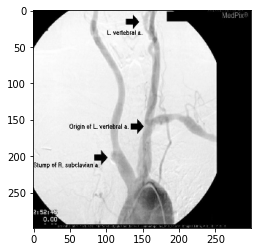

  1%|          | 17/1434 [03:09<3:37:16,  9.20s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: ap anatomy: pulmonary findings: aortic arch injection - early phase . the aortic arch angiogram reveals a proximal occlusion of the right subclavian artery just after the origin of the right common carotid from the brachiocephalic innominate artery . in this projection , the left common carotid artery [UNK] the proximal left subclavian . but , if you look carefully , you can both vessels . note the other irregularities from [UNK] lesions , including mild stenosis of the left subclavian distal to the vertebral artery origin . [UNK] image .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: sagittal anatomy: cardiovascular findings: occlusion of the common carotid artery at the common carotid artery .


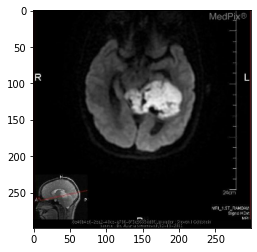

  1%|▏         | 18/1434 [03:18<3:33:38,  9.05s/it]

ORIGINAL ----------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: extra-axial mass arising in the left perimesencephalic cistern and left middle cranial fossa and supracerebellar cistern . mass effect is noted on the pineal gland and surrounding vascular structures . the mass is isointense on t1 and t2 weighted sequuences and shows markedly restricted diffusion on dwi scans .


AI GENERATED ------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial flair image demonstrates a mass in the left frontal lobe of the left frontal lobe .


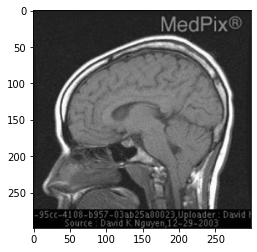

  1%|▏         | 19/1434 [03:28<3:38:25,  9.26s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: routine mri of the brain without contrast was performed . there is cerebellar tonsillar ectopia with the cerebellar tonsils projecting 2 . 5 cm inferior to the foramen magnum . this is consistent with a chiari i malformation . the signal of the brain substance appears normal . there is no evidence of edema , mass effect , hemorrhage , or infarct .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a large cystic mass in the right frontal lobe with associated edema and solid components .


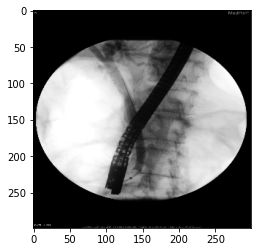

  1%|▏         | 20/1434 [03:49<5:05:15, 12.95s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure specify in caption plane: coronal anatomy: abdomen findings: ercp demonstrating column of contrast material in the proximal hepatic duct , cystic duct , and the common bile duct which abruptly ends distally with a meniscus sign , consistent with a gallstone , which was subsequently removed .


AI GENERATED ------------
core modality: int modality: interventional procedure plane: ap anatomy: abdomen findings: fluoroscopic and post embolization images demonstrate a barium in the stomach , barium swallow study from a barium swallow study from a barium swallow study demonstrating a barium swallow . a large mass in a second smaller filling defect in the right upper quadrant with a small bowel with a large left kidney with a single thin walled cysts in this level of the left hepatic artery arising from the right hepatic malignancy .


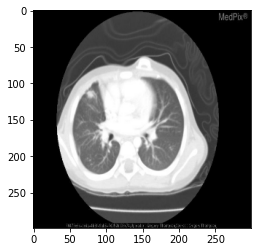

  1%|▏         | 21/1434 [03:59<4:41:40, 11.96s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: pulmonary findings: considerable decrease in size of the right middle lobe tumor pleuropulmonary blastoma with no new abnormality seen .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: there is a large mass in the right upper lobe , lingula and right upper lobe . bilateral pleural effusion . lung lesions are present .


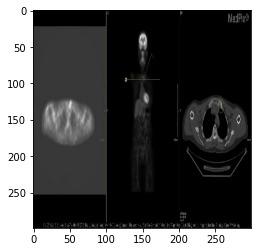

  2%|▏         | 22/1434 [04:16<5:19:08, 13.56s/it]

ORIGINAL ----------------
core modality: pet/nm modality: pet - positron emission plane: axial anatomy: spine findings: increased signal seen on pet images with associated axial ct .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: there is a large heterogeneous mass with central calcifications . the lesion has a central necrosis is present with a large amount of the surrounding the mass effect on the left ventricle is present . it is present in the mass has a large amount of the right atrium and there is no evidence of the left ventricle .


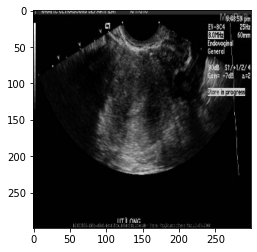

  2%|▏         | 23/1434 [04:25<4:44:47, 12.11s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transvaginal image demonstrates minimal amount of fluid in the cul-de-sac .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with a large amount of surrounding soft tissue mass .


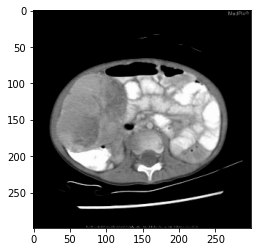

  2%|▏         | 24/1434 [04:49<6:11:00, 15.79s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: axial contrast enhanced ct image through the abdomen demonstrating the heterogeneously enhancing hepatic mass . the peripheral location of this mass in the right hepatic lobe [UNK] the surgical approach and [UNK] the patient's [UNK] .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct image through the abdomen demonstrates a large , rounded , enhancing mass in the liver , which measures approximately 5 . 5 . 7 cm in diameter , there is a large , which is a mass in the left kidney , which is present within the right kidney , there is no evidence of the liver , and , which likely represents dystrophic calcification . there is a large , and a large , there is central low attenuation , and there


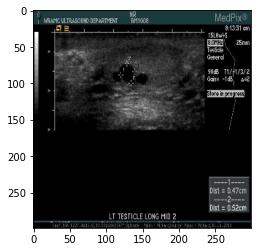

  2%|▏         | 25/1434 [04:59<5:29:01, 14.01s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: similar simple cysts in the left testicle in this 74 year old man . notice the imperceptible walls , increased through-transmission , and anechoic center consistent with simple cysts . these cysts are also located in the region of the mediastinum testis .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the right testicle demonstrates a hypoechoic mass with a thin wall thickening of the left testicle .


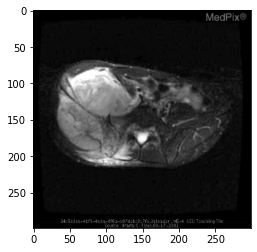

  2%|▏         | 26/1434 [05:08<4:48:54, 12.31s/it]

ORIGINAL ----------------
core modality: mr modality: mr - montage plane: axial anatomy: musculoskeletal findings: fse t2-weighted axial and coronal mr images show a heterogeneously high-signal-intensity mass originating from and surrounding the right iliac wing .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: axial t2 weighted image demonstrates a large mass lesion with surrounding edema in the left femoral neck .


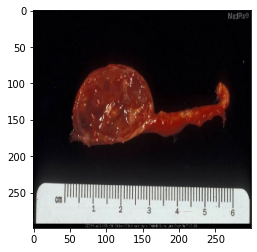

  2%|▏         | 27/1434 [05:28<5:45:11, 14.72s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: head and neck findings: resected mass with vagus nerve imbedded . mass has been [UNK] revealing a [UNK] solid mass .


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: musculoskeletal findings: gross section of the distal clavicle 2 . 2 . coricoid process 2 . 5 . 4 . 0 cm transverse and 5 cm transverse fracture is a 4 . 0 . 0 cm x 3 . 5 cm transverse and the left lower density in the right middle lobe of the right middle lobe of the region of the right middle lobe of the left femoral artery is normal caliber .


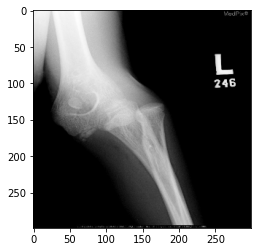

  2%|▏         | 28/1434 [05:39<5:15:58, 13.48s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: oblique anatomy: musculoskeletal findings: there is abnormal alignment of the left elbow .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a well-defined geographic medullary continuity with the cortical destruction of the cortex with the medullary continuity with the cortex .


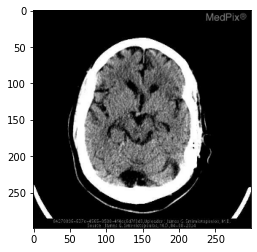

  2%|▏         | 29/1434 [05:50<5:01:46, 12.89s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: there is an area of reduced attenuation darker in the left frontal lobe - just anterior to the sylvian fissure . this is in the region of the arcuate fasciculus and may produce an aphasia with non-fluent speech production . pmid:24131592


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct of the brain demonstrates a large hyperdense blood volume loss of the right frontal lobe . there is a large amount of hemorrhage in the right frontal lobe .


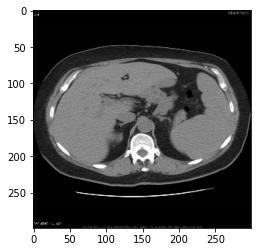

  2%|▏         | 30/1434 [06:08<5:34:58, 14.32s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: well circumscribed rounded lesion of right adrenal gland . homogeneously fat attenuating .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct image through the lower abdomen demonstrate a tubular structure coursing between the liver , the liver , and the liver , the liver parenchyma , the liver , there is no evidence of contrast enhanced images , there is a large amount of the liver parenchyma , which demonstrates no evidence of contrast material in the liver parenchyma .


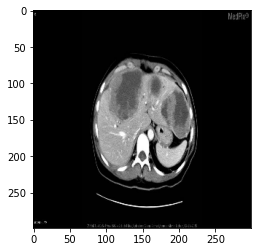

  2%|▏         | 31/1434 [06:22<5:36:54, 14.41s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: contrast ct image shows multiple large encapsulated lesions in right and left lobe of liver . peripheral and central on left [UNK] of high attenuation . while on contrast ct alone , these areas could represent enhancement , a noncontrast ct performed at an outside institution images not available showed similar high attenuation , indicative of hemorrhage .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: contrast enhanced axial ct images through the lower abdomen demonstrate a large , mass in the liver , which measures approximately 5 . 5 cm in the left upper lobe , and there is a spiculated 2 . 5 cm mass .


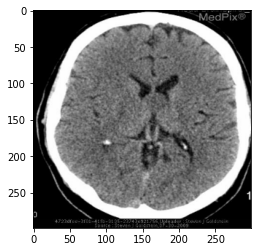

  2%|▏         | 32/1434 [06:33<5:07:13, 13.15s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: homogeneous [UNK] low attenuation mass in the roof of the third ventricle - at the foramen of monro . mild dilitation left lateral ventricle .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct scan hemorrhagic infarct right parietal lobe . mri reveals abnormal enhancement in the right frontal lobe . no evidence of restricted diffusion .


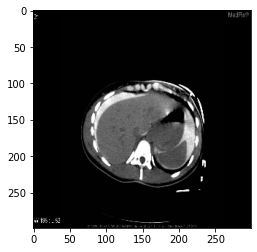

  2%|▏         | 33/1434 [06:49<5:31:12, 14.18s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: intraperitoneal bladder rupture . contrast leaking from bladder fills into a variety of intraperitoneal recesses .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images demonstrate a large , lobulated , enhancing mass arising from the left kidney , extending into the left kidney , and into the left kidney . there is a large amount of mass effect on the mass effect on the liver . there is no evidence of enhancement of contrast .


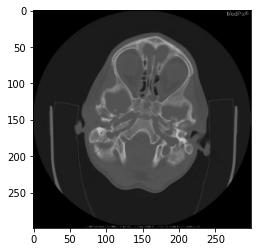

  2%|▏         | 34/1434 [06:58<4:51:34, 12.50s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: axial ct non contrast , bone windows


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct of the head demonstrates a lytic lesion with sclerotic margins with sclerotic and associated soft tissue mass .


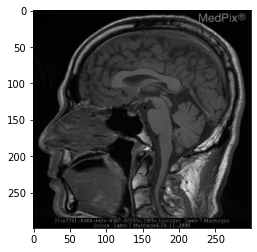

  2%|▏         | 35/1434 [07:08<4:35:40, 11.82s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: spine findings: normal brain parenchyma with apparent tapering of the spinal cord at the c3-c4 level .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: there is a large mass in the left frontal lobe with associated edema and cystic component . mass is irregular enhancement in the right frontal lobe .


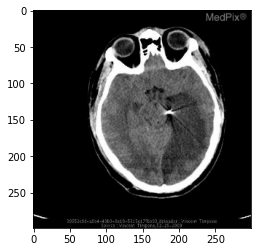

  3%|▎         | 36/1434 [07:23<5:00:18, 12.89s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: a subsequent non-contrast ct of the head was performed following the onset of further [UNK] symptoms . this scan revealed interval displacement of the radiopaque foreign body out of the basilar artery and into the left posterior cerebral artery pca . there is loss of gray white matter differentiation consistent with left pca [UNK] infarction caused by occlusion from the embolized ied fragment .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: there is a large extra-axial mass arising from the right frontal lobe and parietal lobes . the mass is associated with a necrotic regions of necrosis as well as well as well as well as well as well as enhancement following contrast administration .


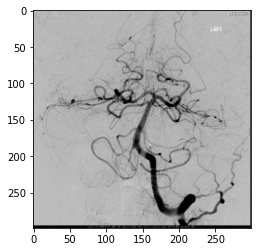

  3%|▎         | 37/1434 [07:31<4:23:40, 11.32s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure plane: ap anatomy: brain findings: selective catheterization of the left vertebral artery in early arterial phase , anteroposterior view , demonstrates a dominant dilated left vertebral artery filling the right vertebral artery in a retrograde fashion , and a portion of the right pica past the vertebrobasilar junction . there is also a patent circle of willis with bilateral posterior communicating arteries filling the middle cerebral artery distribution bilaterally .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: brain findings: right frontal lobe mass with contrast enhancement following contrast administration


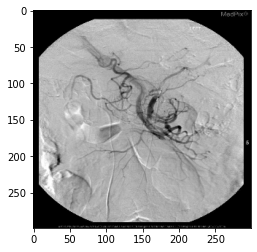

  3%|▎         | 38/1434 [07:39<4:02:22, 10.42s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: sagittal anatomy: abdomen findings: selective superior mesenteric arteriogram demonstrating distal sma thrombus and a high grade av fistula of a jejunal artery with a jejunal vein draining into the superior mesenteric vein . the smv is seen well before the distal jejunal arteries or collateral arterial [UNK] .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: sagittal anatomy: cardiovascular findings: selective angiogram of the left carotid artery injection of the common carotid artery .


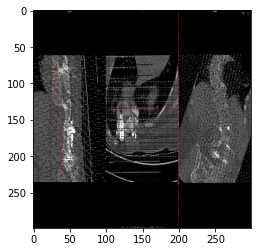

  3%|▎         | 39/1434 [07:46<3:39:05,  9.42s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: spine findings: prominent loosening around the r pedicular screw of t10


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: cardiovascular findings: ct of the left lower lobe demonstrates a large amount of surrounding fat attenuation .


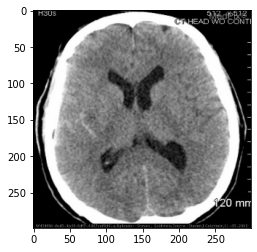

  3%|▎         | 40/1434 [07:54<3:27:14,  8.92s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: hyperattenuation in the right sylvian fissure from subarachnoid hemorrhage .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: multiple small subdural hematoma involving the interhemispheric fissue with branching tributaries consistent with developmental venous anomaly .


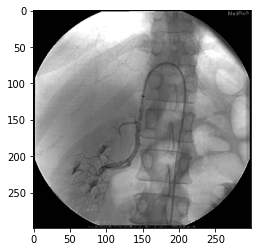

  3%|▎         | 41/1434 [08:03<3:24:31,  8.81s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: oblique anatomy: cardiovascular findings: dsa image of the right renal artery following pta .


AI GENERATED ------------
core modality: int modality: interventional procedure plane: ap anatomy: abdomen findings: fluoroscopic imaging through the distal esophagus demonstrate a dilated distal esophagus with a large amount of contrast within the gastric fundus .


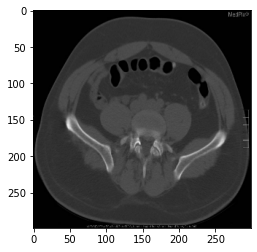

  3%|▎         | 42/1434 [08:23<4:46:05, 12.33s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: moderate right-sided hydroureter continues inferiorly and is visualized anterior to the right iliopsoas muscle . a small quantity of dense material is present within the lumen of the colon consistent with provided history of recent contrast enhanced ct at an outside facility .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: lytic lesion of the right iliac wing , there is a lytic lesion with sclerotic margins with a central calcifications are present . the lesion is present within the left hemipelvis . there is a large , there is a soft tissue mass is a central calcifications are present with a central calcifications are present . there is a central , punctate calcificaiton within which likely represents dystrophic calcification .


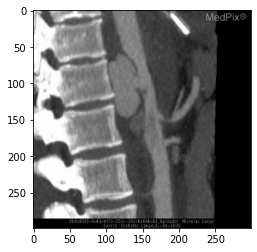

  3%|▎         | 43/1434 [08:32<4:22:07, 11.31s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: sagittal anatomy: cardiovascular findings: parasagittal maximum intensity projection image shows a tear in the intima of the posterior wall of the aorta , the tear , the [UNK] , and some leakage of contrast inferior to the pseudoaneurysm into the retroperitoneum .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: musculoskeletal findings: fracture of the left iliac wing fracture with lytic lesion extending from the left femoral neck .


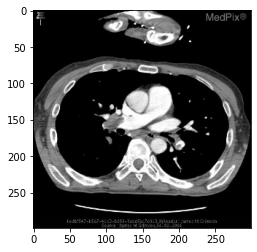

  3%|▎         | 44/1434 [08:41<4:06:49, 10.65s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: large pulmonary embolus in right main and left lower lobe pulmonary arteries . the thrombus is central low density with peripheral flow of contrast surrounding the emboli in more peripheral branches , the appearance seen with acute emboli .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: contrast enhanced ct demonstrates a large left aortic arch with a left subclavian artery arising from the esophagus .


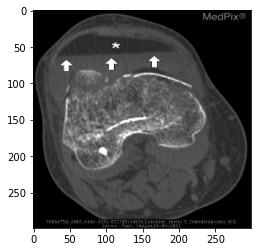

  3%|▎         | 45/1434 [08:50<3:55:20, 10.17s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: nonenhanced axial ct image in bone windows through the level of the femoral condyles , shows the complex fracture with an associated joint effusion with three distinct layers arrows: an anterior layer of fat attenuation , an intermediate fluid attenuation layer , and a posterior layer of increased attenuation blood .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct image of the left shoulder demonstrates a large lytic lesion with associated soft tissue mass .


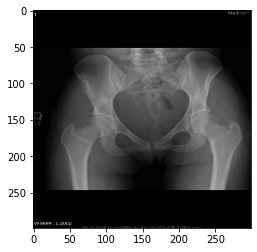

  3%|▎         | 46/1434 [09:02<4:02:49, 10.50s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: follow-up a-p radiographs of the hips shows a sclerotic line in inferior aspect of the femoral neck consistent with a healing stress fracture


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left hip demonstrates a large lytic lesion with a lytic lesion in the proximal femoral head of the proximal tibia and proximal tibia with sclerotic margins .


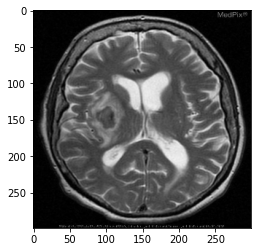

  3%|▎         | 47/1434 [09:10<3:44:50,  9.73s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: mri obtained 6 days after symptom onset: right putamen lesion with a rim of t1 bright shown previously , t2 dark signal intensity shown here - both consistent with consistent with intracellular methemoglobin . surrounding t2 bright signal consistent with edema . no enhancement .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: multiple lesions with some of the basal ganglia and periventricular white matter .


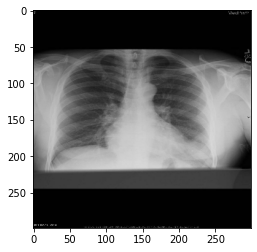

  3%|▎         | 48/1434 [09:20<3:50:49,  9.99s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: cardiovascular findings: well defined , oval shaped mass at the left lung base adjacent left cardiac apex


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large mass , lingula and right middle lobe with associated with associated soft tissue mass .


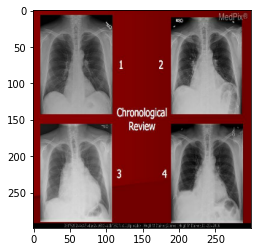

  3%|▎         | 49/1434 [09:25<3:14:27,  8.42s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: cardiovascular findings: progression and regression of pericardial effusion .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: multiple pulmonary nodules .


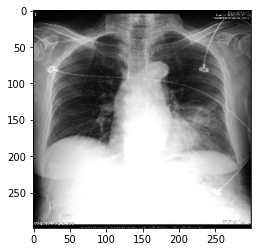

  3%|▎         | 50/1434 [09:35<3:27:50,  9.01s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: frontal chest radiograph demonstrates a mass within the region of the lingula with an eccentric lucency within it .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: frontal and lateral views of the chest demonstrate a large mass with associated soft tissue mass arising from the left upper lobe pulmonary vasculature .


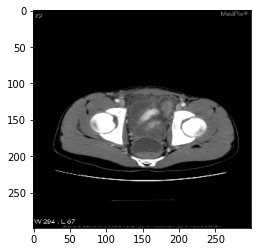

  4%|▎         | 51/1434 [09:46<3:37:42,  9.45s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct image demonstrates a large pocket of rim enhancing fluid in the [UNK] space [UNK] .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images demonstrate a tubular structure coursing between the right neck and the appendix which is continuous with contrast . the mass is not enhance .


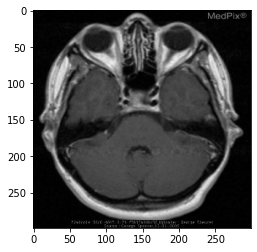

  4%|▎         | 52/1434 [09:55<3:37:54,  9.46s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: the lesion is not as apparent on post contrast t1 axial imaging of the entire brain , but is subtly present as an area of lower intensity to the left of mid-line within the pituitary gland .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: large , partially cystic mass in the right cerebellum with extension into the suprasellar cistern and left cavernous sinus .


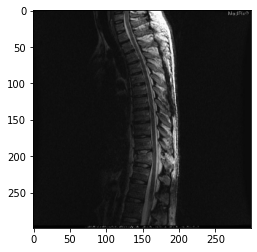

  4%|▎         | 53/1434 [10:03<3:24:09,  8.87s/it]

ORIGINAL ----------------
core modality: mr modality: mr - other pulse seq . plane: sagittal anatomy: spine findings: mri sagital stir: increased signal through t11 body and posterior elements secondary to fracture . the important findings here are: minimal posterior distortion of the fracture vertebral body into spinal canal without evidence of cord compromise or compression . no abnormal cord signal .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: spine findings: intramedullary lesion extending from t12 to upper sacral canal .


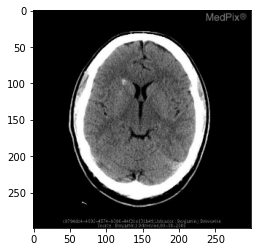

  4%|▍         | 54/1434 [10:15<3:49:35,  9.98s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: noncontrast axial ct image of the brain , demonstrating a hyperdense lesion in the right frontal lobe , adjacent to the head of the caudate .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct of the head demonstrates a large extra-axial mass with cystic and solid mass arising from the right frontal lobes . there is ependymal surfaces of enhancement of the right lateral ventricle and parietal lobe .


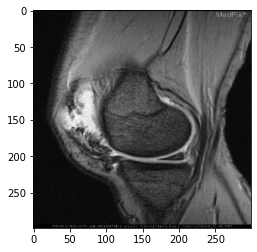

  4%|▍         | 55/1434 [10:29<4:15:17, 11.11s/it]

ORIGINAL ----------------
core modality: mr modality: mr t2 gradient , gre , mpgr , swan , swi plane: sagittal anatomy: musculoskeletal findings: gradient [UNK] sagittal image of the left knee better shows the low-signal-intensity rim of hemosiderin in the masses because of the “blooming” artifact on gradient-recalled echo than on the t2 weighted images . there was no evidence of erosion or osseous infiltration on any sequence . these findings are consistent with pigmented villonodular synovitis .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: musculoskeletal findings: sagittal t1 weighted image demonstrates a large heterogeneous lesion with a low signal intensity lesion within the adjacent to the proximal tibia and proximal tibia . there is no evidence of low signal intensity .


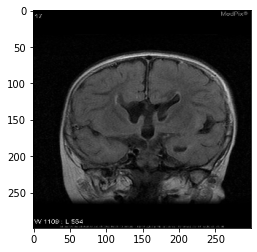

  4%|▍         | 56/1434 [10:38<4:01:52, 10.53s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: [UNK] horn [UNK] the white matter bundles of [UNK] , [UNK] themselves along the medial wall of the lateral ventricles .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: there is a large mass in the right frontal lobe with a large amount of surrounding edema .


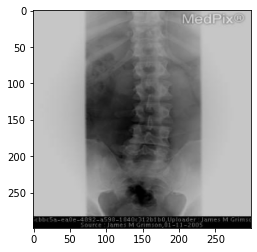

  4%|▍         | 57/1434 [10:44<3:30:42,  9.18s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: spine findings: pars defects not well seen on this view .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple loops of bowel gas in the abdomen .


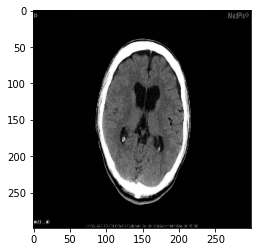

  4%|▍         | 58/1434 [10:59<4:04:53, 10.68s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct: there are numerous fat density foci seen within the subarachnoid space predominantly in the region of the sylvian fissure on the left .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial noncontrast ct of the head demonstrates a large extra-axial mass with cystic mass arising from the right frontal lobe and extending into the third ventricle . there is enhancement of the mass effect on the mass appears to the lateral ventricle .


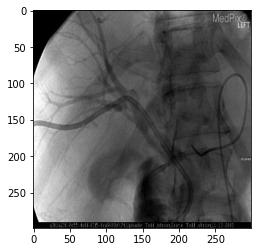

  4%|▍         | 59/1434 [11:06<3:40:22,  9.62s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: coronal anatomy: cardiovascular findings: • contrast is flowing from hepatic artery into drainage catheter .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: right ica angiogram demonstrates a large aneurysm arising from the left common carotid artery .


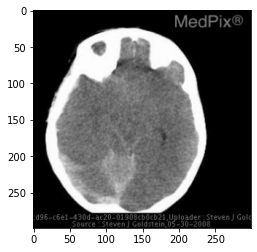

  4%|▍         | 60/1434 [11:15<3:35:23,  9.41s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: small subdural hematoma right convexity massive cerebral hemisphere edema on ct


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: the head ct demonstrates a large , hyperattenuating mass , rounded , rounded , and peripheral enhancement of the right frontal lobe .


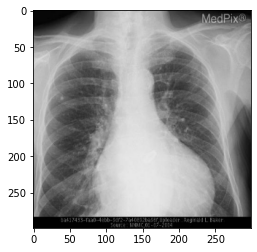

  4%|▍         | 61/1434 [11:28<4:02:28, 10.60s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: cardiovascular findings: different patient . frontal view of chest demonstrates a tilting disc prosthetic aortic valve .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large mass arising from the left hemithorax . the mass is noted in the left upper lobe and the left lower lobe pulmonary vasculature and mediastinal adenopathy .


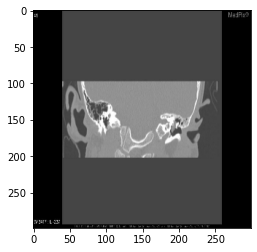

  4%|▍         | 62/1434 [11:37<3:52:07, 10.15s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: soft tissue mass in the middle ear space abutting the long process of the incus without obvious erosion .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: there is a soft tissue mass in the left maxillary sinus with bone erosion of the mandible .


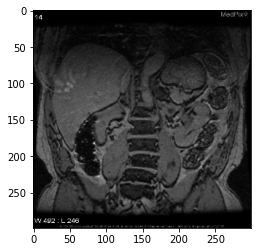

  4%|▍         | 63/1434 [11:46<3:44:34,  9.83s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: genitourinary findings: coronal t1 out-of-phase sequence demonstrates signal drop-out in the left adrenal mass .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: genitourinary findings: coronal t1 weighted image demonstrates a large mass in the left kidney with high signal intensity of the left kidney .


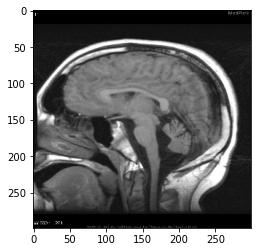

  4%|▍         | 64/1434 [11:54<3:31:29,  9.26s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: vermian hypoplasia with a normal-sized posterior fossa .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a large mass in the right frontal lobe with associated cystic and solid components .


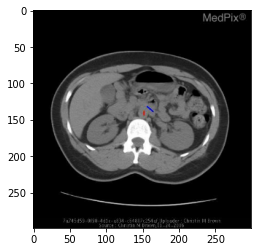

  5%|▍         | 65/1434 [12:02<3:25:19,  9.00s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: cardiovascular findings: the infrarenal ivc blue dash drains into the left renal vein , which crosses over the aorta red dash to a right suprarenal ivc .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: right kidney with large heterogeneous mass effect on the right kidney . no evidence of contrast enhancement .


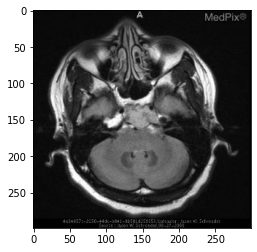

  5%|▍         | 66/1434 [12:15<3:46:08,  9.92s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: large heterogeneous flair hyperintense mass arising in the midline of the clivus .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: axial t2 weighted image reveals a large mass in the right cpa cistern which is isointense to csf signal intensity on t2 and t2 sequences . no enhancement following contrast administration .


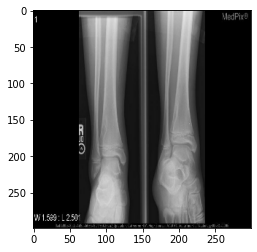

  5%|▍         | 67/1434 [12:26<3:53:44, 10.26s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: no evidence of fracture and mild soft tissue swelling around the lateral malleolus . incidentally , a lucent lesion with a well defined cortical margin was found along the lateral distal tibia , consistent with a [UNK] fibroma .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hand demonstrates a lytic lesion with a lytic lesion of the proximal tibia with sclerotic margins and proximal tibia .


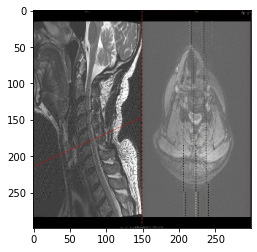

  5%|▍         | 68/1434 [12:37<4:03:28, 10.69s/it]

ORIGINAL ----------------
core modality: mr modality: mr t2 gradient gre plane: axial anatomy: spine findings: there are marked degenerative discogenic changes with a disc osteophyte complex . there is very mild stenosis . there is no cord impingement . the foramina are patent .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: there is a large heterogeneous mass with central canal stenosis at the ventral thecal sac . there is mild central canal stenosis at the ventral thecal sac .


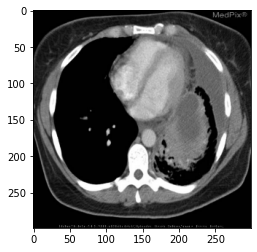

  5%|▍         | 69/1434 [12:47<3:59:27, 10.53s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: 1 . large , multiloculated pleural fluid collection in the left hemithorax as described . slightly more complex regions are present inferiorly . 2 . streaky air space opacities in the lingula and left lower lobe which may represent superimposed or [UNK] infection with atelectasis . 3 . mediastinal and left hilar lymphadenopathy which is most likely reactive . this constellation of findings is most likely secondary to [UNK] pneumonia . although less likely other [UNK] would include [UNK] infection such as [UNK] .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial ct image demonstrates a large mass in the left upper lobe with a left pleural effusion .


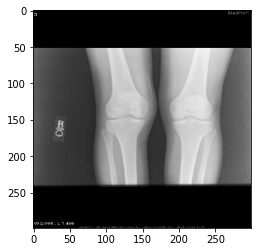

  5%|▍         | 70/1434 [13:00<4:16:33, 11.29s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: asymmetric soft tissue swelling along the right medial knee , with very faint calcifications seen in the area of the right proximal mcl , better seen on the [UNK] projection


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left knee demonstrates a well-defined geographic margined , and sclerotic lesions in the distal femur , consistent with a narrow zone . no periosteal reaction or periosteal reaction or periosteal reaction .


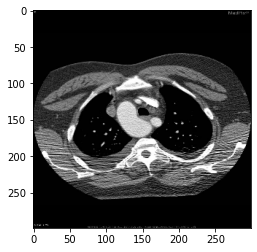

  5%|▍         | 71/1434 [13:15<4:39:10, 12.29s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial ct at through the aortic arch demonstrating separate left common carotid and left subclavian artery .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the esophagus and mass arising from the body of the esophagus and displaces the aorta . the thoracic aorta are present within the aortic arch and the left subclavian artery .


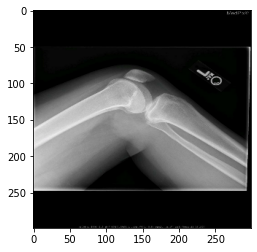

  5%|▌         | 72/1434 [13:25<4:25:17, 11.69s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: initial lateral radiograph without abnormalities .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a well-defined geographic , rounded density in the proximal tibia , with sclerotic margins , with sclerotic margins are present .


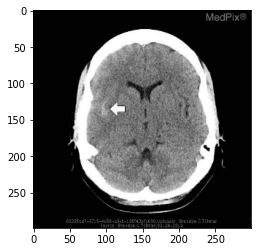

  5%|▌         | 73/1434 [13:35<4:10:35, 11.05s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial noncontrast ct of the brain showing sah in the right sylvian fissure arrow .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct of the head demonstrates a hyperdense material in the right frontal lobe with a large amount of surrounding hematoma .


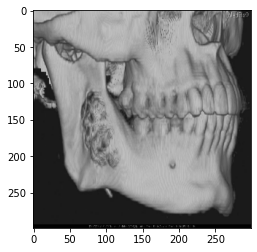

  5%|▌         | 74/1434 [13:41<3:36:41,  9.56s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: 3d reconstruction anatomy: head and neck findings: 3d reconstruction of the face demonstrates the patient's expansile , [UNK] lytic lesion of the right mandible .


AI GENERATED ------------
core modality: an modality: cta - ct angiography plane: 3d reconstruction anatomy: musculoskeletal findings: 3d reconstruction of the left foot


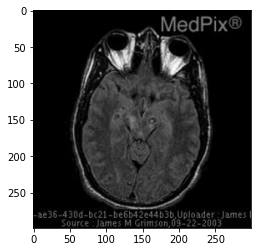

  5%|▌         | 75/1434 [13:49<3:25:07,  9.06s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: flair image of hemorrhagic lesion in left midbrain . image taken at original examination .


AI GENERATED ------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial flair image demonstrates a lesion in the left occipital lobe with a large amount of edema .


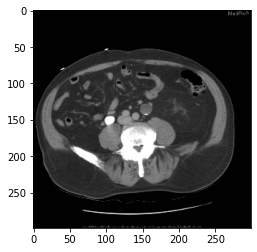

  5%|▌         | 76/1434 [13:57<3:18:06,  8.75s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: delayed contrasted enhanced axial images demonstrating dilated , contrast-filled right ureter .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct through the abdomen demonstrates a large mass in the cecum with surrounding fat stranding .


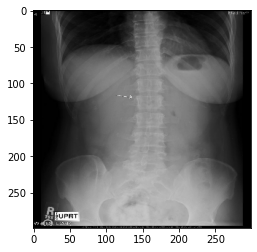

  5%|▌         | 77/1434 [14:08<3:33:41,  9.45s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: abdomen findings: upright view of the abdomen demonstrates a [UNK] gas pattern . calcifications are demonstrated overlying the right l5/s1 level . a focal right paraspinal calcification at the level of l2 is demonstrated . this finding is concerning for a gallstone in the gallbladder neck with distention of the gallbladder .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: ap view of the abdomen demonstrates a small bowel wall thickening of the stomach with a small bowel wall thickening and gas to the abdomen .


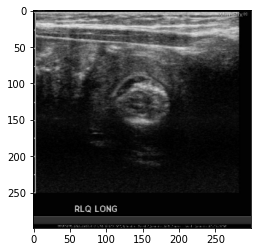

  5%|▌         | 78/1434 [14:13<3:04:38,  8.17s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: abdomen findings: transverse sonography reveals a swirled pattern of alternating hyperechogenicity and hypoechogenicity representing the layers of mucosa , muscularis , serosa and fat target or doughnut sign . longitudinal sonography reveals a sandwich like appearance of the alternating loops of bowel pseudokidney sign .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: right testicle


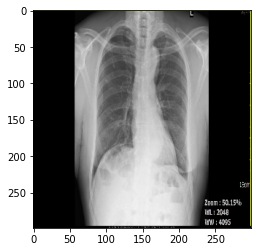

  6%|▌         | 79/1434 [14:35<4:38:45, 12.34s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: abdomen findings: fracture of rib 3 is noted . minimal blunting of left costophrenic angle is seen . nodular opacities in right upper lobe of lung visualized .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: there is a large mass in the left upper lobe , which measures 2 . there is a 4 x 1 . 7 x 2 . 7 cm ap , 7 cm . 0 x 1 . 5 cm nodule in the left lower lobe . the left upper lobe , which demonstrates mild mass . there is no other lung zone of the right upper lobe bronchiectasis is no other cardiac silhouette .


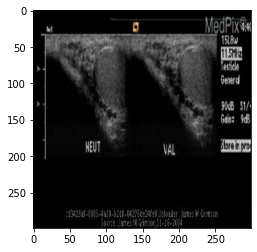

  6%|▌         | 80/1434 [14:46<4:28:57, 11.92s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal ultrasound images of the left testis in normal and valsalva [UNK] demonstrate multiple dilated vessels adjacent to the left testis . the vessels dilate further with valsalva .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left testicle demonstrates a hypoechoic , heterogeneous mass with a tubular structure which is consistent with a graded compression of the bladder wall .


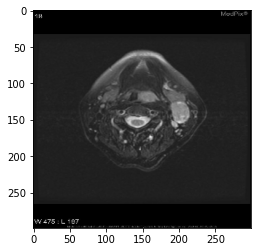

  6%|▌         | 81/1434 [14:57<4:24:15, 11.72s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: head and neck findings: • enhancing plaque-like mass at base of the tongue . • second enhancing mucosal plaque-like lesion at same level to the right of midline . do not appear to extend into musculature . • hemorrhagic and necrotic lymph node in level 1 left side of neck just inferior to mandible and deep portion of parotic lateral to carotid vessels . • second necrotic node above previous node .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: axial t2 weighted image demonstrates a large heterogeneous mass lesion with surrounding edema in the left lateral aspect of the left orbit .


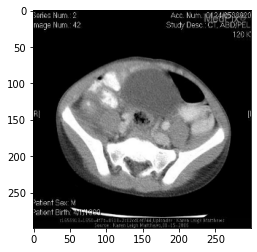

  6%|▌         | 82/1434 [15:06<4:03:47, 10.82s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: enlarged appendix with appendicolith


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images through the lower pelvis demonstrate a large amount of surrounding fat stranding adjacent to the appendix .


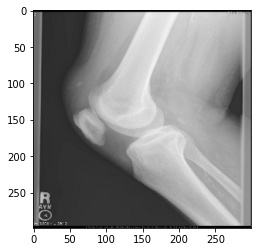

  6%|▌         | 83/1434 [15:18<4:12:46, 11.23s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: [UNK] [UNK] [UNK] tissue swelling in the supra patellar region [UNK] fragment with donor site from superior pole of patella


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: ap and lateral radiographs of the left knee demonstrate a well circumscribed , well defined , well circumscribed , irregular sclerotic margins , which is present within the medullary continuity with the medullary cavity .


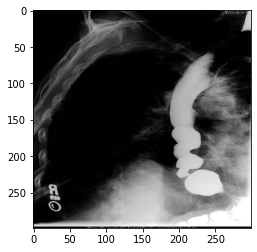

  6%|▌         | 84/1434 [15:29<4:07:31, 11.00s/it]

ORIGINAL ----------------
core modality: ugi modality: ugi - upper gi plane: oblique anatomy: abdomen findings: single contrast esophagram demonstrates numerous lower esophageal [UNK] contractions ending in a round hiatal hernia .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the chest demonstrates a large mass with a large mass arising from the left hemithorax with calcification and mass effect on the left hemithorax .


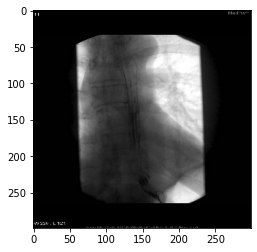

  6%|▌         | 85/1434 [15:39<4:02:29, 10.79s/it]

ORIGINAL ----------------
core modality: bas modality: bas - barium swallow plane: oblique anatomy: abdomen findings: air contrast barium swallow demonstrates a smooth outpouching in the mid-esophagus . interval decrease in size of the air-filled diverticulum , with contrast pooling dependently .


AI GENERATED ------------
core modality: bas modality: bas - barium swallow plane: coronal anatomy: abdomen findings: barium swallow study demonstrating a barium swallow study from a barium swallow study from a barium swallow study from a barium swallow .


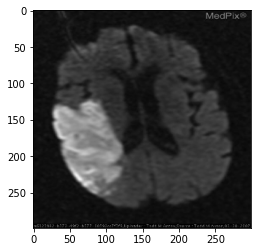

  6%|▌         | 86/1434 [15:46<3:36:12,  9.62s/it]

ORIGINAL ----------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: interval increase in size of signal in right temporal-parietal region


AI GENERATED ------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: multiple lesions in both cerebral hemispheres with some of restricted diffusion .


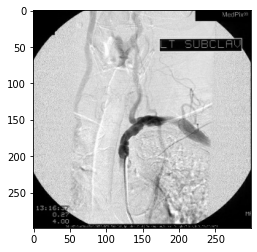

  6%|▌         | 87/1434 [15:58<3:49:43, 10.23s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: ap anatomy: pulmonary findings: selective catheter angiogram of the left contralateral subclavian artery also shows retrograde filling of the right vertebral artery from the left vertebral - through the basilar artery anastomosis not shown .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: coronal anatomy: cardiovascular findings: the t3-t8 left intercostal arteries are seen . no ica or no ica or hemorrhage . no ica or hemorrhage . no evidence of internal blood flow was seen on the left .


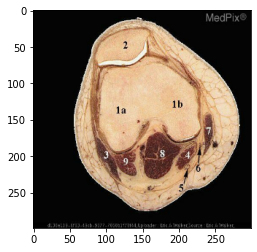

  6%|▌         | 88/1434 [16:08<3:47:16, 10.13s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: axial anatomy: musculoskeletal findings: axial distal femur at the condyles 1a . lateral femoral condyle 1b . medial femoral condyle 2 . patella 3 . biceps femoris muscle 4 . semimembranosis muscle 5 . semitendinosis tendon 6 . gracilis tendon 7 . sartorius muscle 8 . gastrocnemius muscle medial head 9 . gastrocnemius muscle lateral head http://rad . usuhs . [UNK] . htm


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: musculoskeletal findings: gross section 4 . acromion 4 . 4 . deltoid muscle 5 . deltoid muscle 4 . trapezius muscle


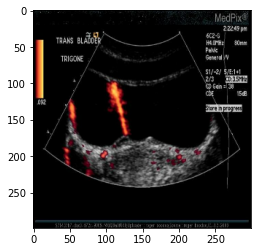

  6%|▌         | 89/1434 [16:21<4:08:07, 11.07s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: a small cystic structure at the expected orifice of the right ureter that [UNK] and [UNK] in sized with urine jet .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a tubular structure with a tubular structure within the left kidney . the mass is seen in the left ovary and the left ovary is seen on the ureteral jet was identified .


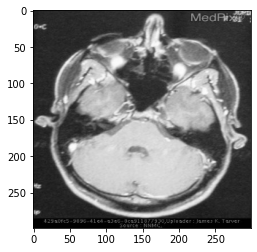

  6%|▋         | 90/1434 [16:33<4:18:02, 11.52s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: t1wi after the administration of gadolinium does not show evidence of disruption of the [UNK] barrier . however , there is pulsation artifact from the sigmoid sinus through the region of interest .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: axial t1 post contrast enhanced mr image demonstrates a large mass in the right cerebellum with a large mass effect with a thin rim of enhancement of the left parotid gland .


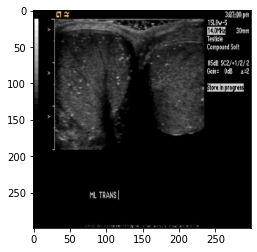

  6%|▋         | 91/1434 [16:42<3:56:31, 10.57s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: small nonshadowing hyperechoic foci ranging in diameter from 1 to 3 mm . these occur within the testicular parenchyma but may be distributed peripherally or [UNK] . testicular microlithiasis usually occurs bilaterally .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: delayed whole body and delayed images demonstrate a focal increased uptake in the left femoral neck .


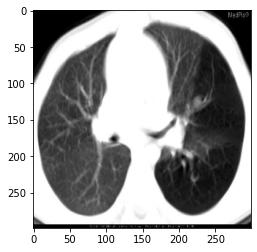

  6%|▋         | 92/1434 [16:55<4:16:16, 11.46s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct of the lungs demonstrates left-sided vascular [UNK] with associated loss of parenchymal density .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct of the head and neck and neck . note the mass in the right anterior cranial fossa of the mass has been resected and the left side of the left side of the patient has been resected and the patient's stated history .


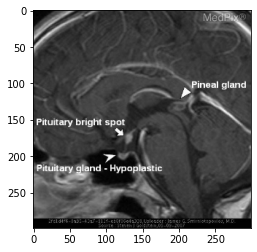

  6%|▋         | 93/1434 [17:07<4:17:08, 11.51s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: pituitary bright spot is ectopically located at the upper level of the infundibulum arrow , behind the median eminence . pituitary gland is only 1/3 of expected size for a normal 16 year old female , measuring only 3 mm in height vs [UNK] mm . note: there is normal rim enhancement of the pineal gland arrowhead .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: there is a lesion in the posterior fossa extending into the posterior cranial fossa . mass is isointense to csf on t2 and t2 and enhances homogeneously .


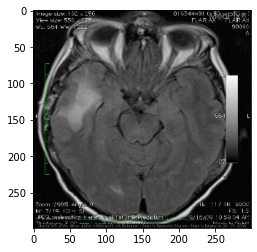

  7%|▋         | 94/1434 [17:15<3:55:30, 10.55s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial t2 flair at the level of midbrain demonstrates signficant right temporal t2 signal hyperintensity consistent with vasogenic edema .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: multiple ring enhancing lesions in the right frontal lobe . minimal mass effect and no restricted diffusion .


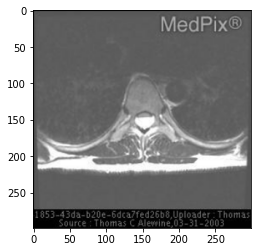

  7%|▋         | 95/1434 [17:25<3:50:15, 10.32s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: an extraaxial lesion is seen posteriorly within the spinal canal from the level of t7 . this lesion presses on the spinal cord and demonstrates hyperintensity on t2 imaging .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: spine findings: there is a mass in the left lateral aspect of the left vertebral body with extension into the left cavernous sinus .


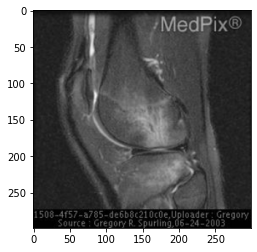

  7%|▋         | 96/1434 [17:36<3:52:46, 10.44s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: musculoskeletal findings: sagittal t2 fat sat image shows classic contusion pattern in the bones with lateral femoral condyle and lateral tibial plateau contusions .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: musculoskeletal findings: sagittal t2 weighted image demonstrates a large heterogeneous lesion with low signal intensity rim of low signal intensity rim on t2 signal on t2 images .


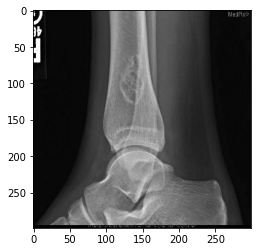

  7%|▋         | 97/1434 [17:44<3:39:47,  9.86s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral ankle slightly expansile lesion with scalloped , sclerotic border


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the left knee demonstrates a well-defined geographic medullary continuity with the medullary continuity with the cortex .


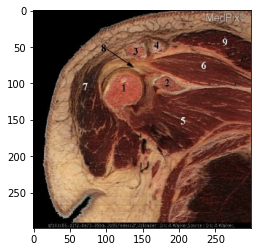

  7%|▋         | 98/1434 [17:54<3:41:28,  9.95s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: coronal anatomy: musculoskeletal findings: coronal gross section 03 1 . humeral head 2 . coricoid process 3 . acromion 4 . distal clavicle 5 . subscapilaris muscle 6 . supraspinatus muscle 7 . deltoid muscle 8 . long head of biceps tendon 9 . trapezius muscle


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: coronal anatomy: musculoskeletal findings: coronal gross section 02 1 . distal clavicle 3 . coricoid process 3 . distal clavicle 3 . deltoid muscle 4 . deltoid muscle


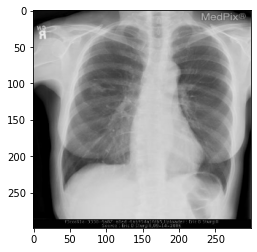

  7%|▋         | 99/1434 [18:11<4:27:54, 12.04s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa chest radiograph demonstrates a 1 . 5 x 2 . 3 cm nodule in the right lung .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph of the chest demonstrates a large mass in the left hemithorax with a large mass effect on the left lung zone of the left hemithorax . the mass is noted is present . there is a large mass is no evidence of consolidation and mediastinal lymphadenopathy . there is evidence of air space narrowing .


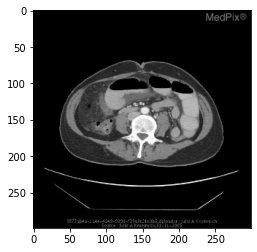

  7%|▋         | 100/1434 [18:22<4:20:52, 11.73s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct image demonstrating multiple loops of dilated , fluid filled small bowel with free fluid and wall thickening .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images demonstrate a large , lobulated , enhancing mass arising from the left kidney , extending into the left kidney , and displaces the splenic vein .


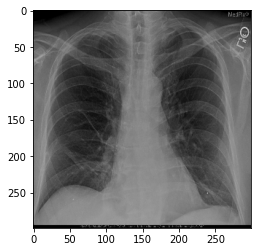

  7%|▋         | 101/1434 [18:31<4:03:24, 10.96s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: baseline chest radiograph demonstrates normal pulmonary vasculature .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa chest radiograph demonstrates a large mass in the left upper lobe with a left lung zone of the left pleural effusion .


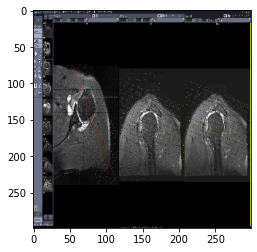

  7%|▋         | 102/1434 [18:42<4:03:37, 10.97s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: from left to right . axial t2 . axial t2 . axial t2


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal mr image demonstrates a well defined mass in the left femur , with a thin rim of increased signal in the region of the left femoral vein .


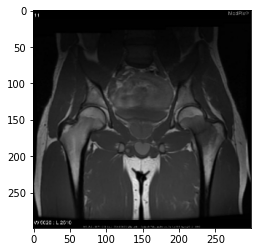

  7%|▋         | 103/1434 [18:53<4:01:01, 10.86s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: low signal fracture line seen on t1 , extending across [UNK] of the diameter of femoral neck .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal t1 and coronal t2 images demonstrate a well circumscribed , low signal intensity lesion in the right femoral neck , consistent with a large amount of edema .


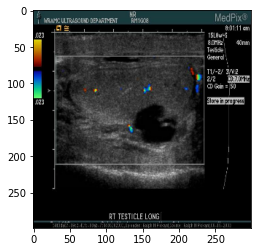

  7%|▋         | 104/1434 [19:02<3:49:02, 10.33s/it]

ORIGINAL ----------------
core modality: us modality: us-d - doppler ultrasound plane: longitudinal anatomy: genitourinary findings: simple cysts in the right testicle in this 74 year old man . notice the imperceptible walls , increased through-transmission , and anechoic center consistent with simple cysts . these cysts are clustered and located in the region of the mediastinum testis .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the left testicle demonstrates a tubular structure with a tubular structure within the left testicle .


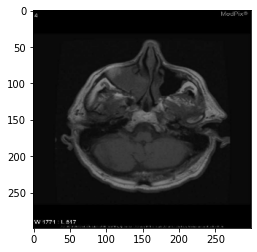

  7%|▋         | 105/1434 [19:17<4:18:07, 11.65s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: head and neck findings: axial t1wi through the level of the maxillary sinuses demonstrates a homogeneous hypointense mass within the right maxillary sinus with extension into the adjacent nasal passage .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: head and neck findings: axial t1 weighted image demonstrates a large mass in the right cerebellum with a large mass arising from the left nasal cavity . there is no enhancement of the mass effect on the left orbit or mural nodule on the right cerebellar artery .


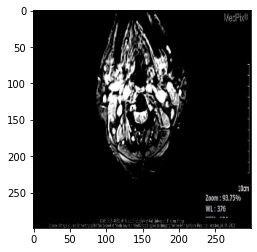

  7%|▋         | 106/1434 [19:24<3:46:30, 10.23s/it]

ORIGINAL ----------------
core modality: mr modality: mr t2 gradient , gre , mpgr , swan , swi plane: axial anatomy: spine findings: neural sleeve cyst , right


AI GENERATED ------------
core modality: an modality: mra - mr angiography/venography plane: 3d reconstruction anatomy: cardiovascular findings: mra of the left carotid artery at level of the carotid artery .


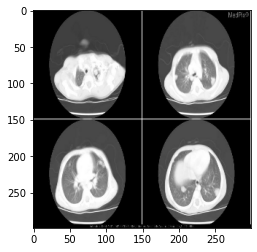

  7%|▋         | 107/1434 [19:37<4:05:26, 11.10s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: numerous pleural parenchymal masses scattered throughout all lobes of the lung parenchyma consistent with metastatic foci . no definitive mediastinal adenopathy . there is no evidence of pleural effusion .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct images of the chest demonstrate a large , rounded , rounded , rounded , rounded density , in the right upper lobe , and right lower lobe , and loculated chronic pleural effusions are present .


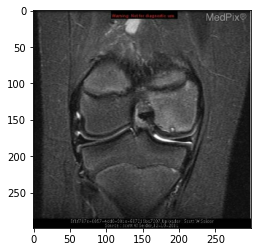

  8%|▊         | 108/1434 [19:48<4:02:00, 10.95s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: coronal anatomy: generalized findings: there is edema and areas of cystic change in the underlying bone at the donor site in the medial femoral condyle . there is a large amount of fluid present in the joint space - consistent with effusion .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: musculoskeletal findings: coronal t2 weighted mr image demonstrates a high signal intensity within the medial meniscus with a small foci of the adjacent to the medial meniscus .


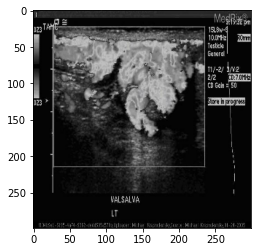

  8%|▊         | 109/1434 [19:52<3:15:38,  8.86s/it]

ORIGINAL ----------------
core modality: us modality: us-d - doppler ultrasound plane: sagittal anatomy: genitourinary findings: ultrasound of left gonadal vein with [UNK]


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: right testicle


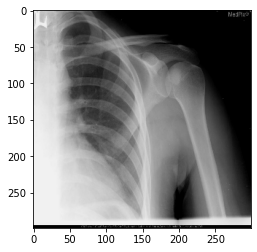

  8%|▊         | 110/1434 [20:00<3:11:00,  8.66s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: ap shoulder: 2002 – there has been interval increase in the amount of amorphous density within the lesion .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left shoulder demonstrates a large lytic lesion with sclerotic margins of the humeral head .


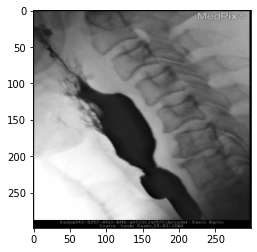

  8%|▊         | 111/1434 [20:07<3:05:00,  8.39s/it]

ORIGINAL ----------------
core modality: ugi modality: ugi - upper gi plane: sagittal anatomy: abdomen findings: fluoroscopic lateral image of the esophagus demonstrates a large divertculum overlying the proximal esophagus . lateral view verifies that the lesion arises just inferior to the impression made by the cricopharyngeus muscle , diagnostic of a killian-jamieson diverticulum .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: sagittal anatomy: cardiovascular findings: left subclavian artery is seen in the left subclavian artery arising from the esophagus .


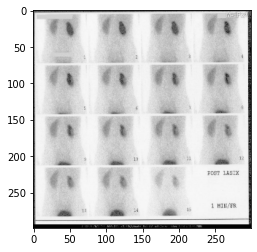

  8%|▊         | 112/1434 [20:19<3:23:19,  9.23s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: pa anatomy: genitourinary findings: following the administration of lasix , prompt washout of radiotracer from the right kidney occurs with a washout half time of less than 10 minutes . this is consistent with a non-obstructed right renal collecting system .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: delayed images of the left hip demonstrate a focal uptake in the right femoral neck , consistent with a focal area of radiotracer uptake in the right femoral head .


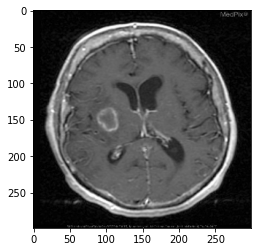

  8%|▊         | 113/1434 [20:30<3:38:46,  9.94s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: mri obtained 6 days after symptom onset: right putamen lesion demonstrates a stable appearance no enhancement following the administration of iv gadolinium , with an unchanged rim of t1 bright signal intensity .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: multiple enhancing lesions with some of the basal ganglia . the lesion has a large cystic component is partially solid components . the mass has both cystic and solid components .


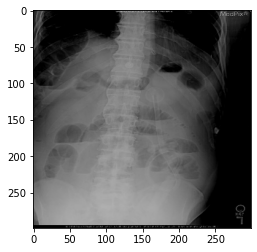

  8%|▊         | 114/1434 [20:43<3:54:09, 10.64s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: dilated loops of small bowel >3 cm and multiple small bowel air-fluid levels in a [UNK] pattern . [UNK] loops of bowel and a string of [UNK] sign created by the small bubbles of gas that are between the folds of dilated and fluid-filled small bowel loops are present .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap view of the abdomen demonstrates a small bowel wall thickening of the stomach with a paucity of the stomach , gas , and bowel gas to the abdomen .


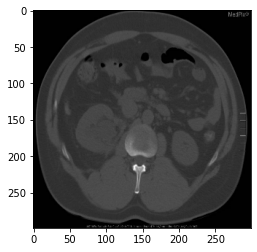

  8%|▊         | 115/1434 [21:03<4:59:34, 13.63s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: moderate right-sided hydronephrosis is present on this non-contrast ct of the abdomen and pelvis . a small quantity of dense material is present within the lumen of the descending colon consistent with provided history of recent contrast enhanced ct at an outside facility .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: axial ct image of the abdomen demonstrates a large , rounded , rounded , heterogeneous mass arising from the left renal cortex and the mass is seen . it is seen in this image . on this image was performed to be advanced into the right kidney with a large , there is a large , there is a large , punctate calcificaiton within which likely represents dystrophic calcification from fat necrosis .


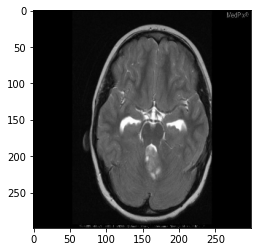

  8%|▊         | 116/1434 [21:12<4:30:19, 12.31s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: inhomgeneous mass originating in the fourth ventricle and extending out the foramen of luska . note obstructive hydrocephalus


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: there is a large mass in the left frontal lobe with associated edema and cystic component . some associated edema is restricted diffusion .


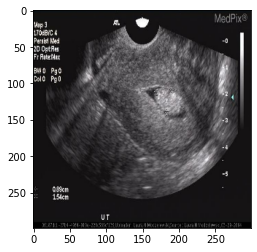

  8%|▊         | 117/1434 [21:21<4:04:05, 11.12s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: hsg: [UNK] mass measures 1 . 5 cm x 0 . 9 cm .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with a cystic structure within the right kidney .


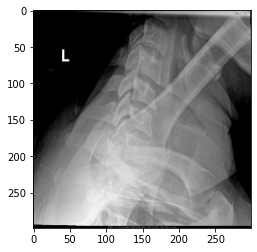

  8%|▊         | 118/1434 [21:32<4:05:49, 11.21s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: this is a [UNK] lateral view radiograph . this is used to visualize the c7-t1 junction . no abnormal findings other than those noted on prior radiographs .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: ap view of the cervical spine demonstrates a fracture of the left subclavian artery with a large lytic lesion with a central lucency surrounding the left femoral neck .


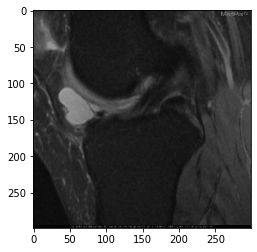

  8%|▊         | 119/1434 [21:42<3:55:55, 10.76s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: musculoskeletal findings: sagittal pd fs image of the knee demonstrates high signal lesion within the hoffa infrapatellar fat pad .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: musculoskeletal findings: coronal t2 weighted image demonstrates a high signal intensity lesion within the medial meniscus with a high signal intensity on t2 weighted images .


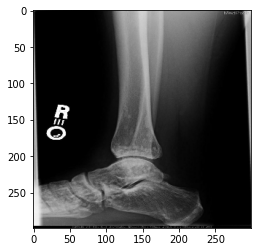

  8%|▊         | 120/1434 [21:50<3:39:28, 10.02s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: multiple asymptomatic enostoses grouped about the articular surfaces of the ankle and foot


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left foot demonstrates a fracture lucency in the distal femur with a non-displaced fracture lucency .


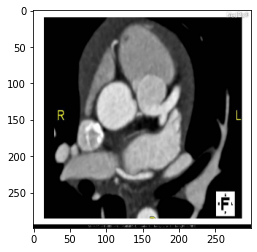

  8%|▊         | 121/1434 [22:13<5:00:33, 13.73s/it]

ORIGINAL ----------------
core modality: an modality: cta - ct angiography plane: axial anatomy: cardiovascular findings: axial ct image showing normal origin of the left coronary from the pulmonary artery .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: musculoskeletal findings: large lytic lesion involving the left side of the proximal humerus with a large lytic lesion of the proximal tibia and proximal tibia , which is present . the medullary cavity is present within the mass is present as well as well as well as well as well as well as the mass effect on the soft tissue swelling of the lateral ventricles and the turns . the soft tissue mass effect on the posterior margin of the internal auditory bony canal which represents the mass effect


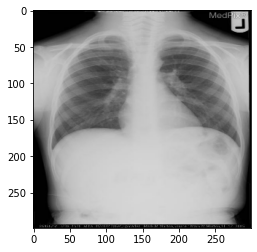

  9%|▊         | 122/1434 [22:29<5:18:53, 14.58s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: frontal image demonstrates complete resolution of the round density previously seen within the right upper lobe after antibiotic treatment .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large mass arising from the left hemithorax . the mass is noted in the left upper lobe and the left hemithorax is noted after contrast on the left hemithorax is a well as well circumscribed and pulmonary vasculature . there is a spiculated opacities .


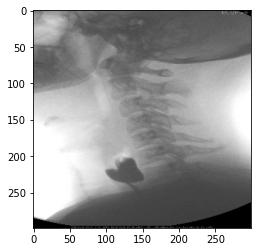

  9%|▊         | 123/1434 [22:37<4:37:39, 12.71s/it]

ORIGINAL ----------------
core modality: bas modality: bas - barium swallow plane: sagittal anatomy: abdomen findings: lateral [UNK] esophagram reveals a outpouching arising from the region of the cricopharyngeus posterior to the normal esophagus .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap view of the abdomen demonstrates a large mass in the stomach , and gastric fundus .


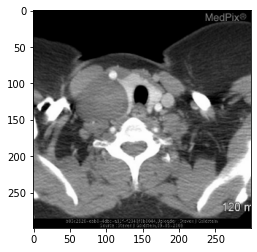

  9%|▊         | 124/1434 [22:53<4:58:05, 13.65s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: brain findings: ovoid mass lying within the carotid sheath structures behind the ica and along the course of the vagus nerve . the mass enhances homogeneously . it lacks calcifications and does not have flow voids .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: musculoskeletal findings: soft tissue mass with bone erosion of the left maxillary sinus . dumbell shaped mass on left between the left maxillary sinus . left maxillary sinus are present on left maxillary sinus . 0 x 3 . 5 cm nodule is present within the right lower lobe with bone windows .


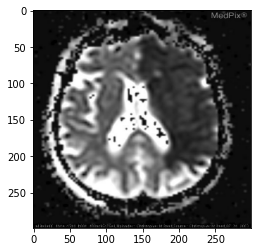

  9%|▊         | 125/1434 [23:01<4:16:17, 11.75s/it]

ORIGINAL ----------------
core modality: mr modality: mr - adc map app diff coeff plane: axial anatomy: brain findings: applied diffusion coefficient image from mri tia protocol performed after nect .


AI GENERATED ------------
core modality: mr modality: mr - adc map app diff coeff plane: axial anatomy: brain findings: diffusion-weighted images reveal restricted diffusion in the left parietal lobe .


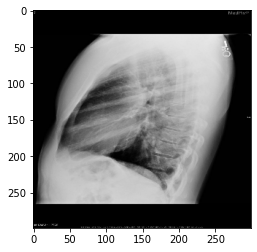

  9%|▉         | 126/1434 [23:08<3:50:18, 10.56s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral chest radiograph demonstrates a well-circumscribed nodular opacity within the retrosternal clear space .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: lateral radiograph of the chest demonstrates a large mass with calcification in the right lower lobe .


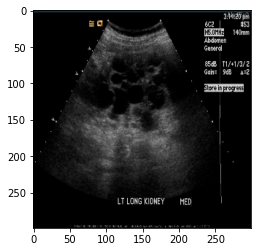

  9%|▉         | 127/1434 [23:20<3:55:12, 10.80s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: multiple cysts are evident in the renal parenchyma .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal ultrasound image of the right kidney demonstrates a large heterogeneous mass with a mass arising from the left ovary . the mass is seen within the left ovary and the left ovary is seen .


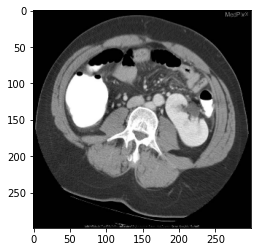

  9%|▉         | 128/1434 [23:36<4:30:09, 12.41s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: axial ct image shows the crossed fused kidney lying in abnormal axis of rotation . the left renal pelvis is rotated outward - [UNK] toward the [UNK] position . normally , the renal hilus [UNK] inward , pointing to a spot anterior to the spine .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: ct images through the abdomen demonstrate a large , lobulated , mass arising from the pancreatic body mass arising from the peri-pancreatic fat indistinct margins obliteration of the splenic vein , celiac artery , and smv below the confluence and likely encasement of the superior mesenteric artery .


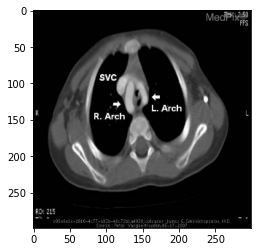

  9%|▉         | 129/1434 [23:48<4:29:16, 12.38s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: svc - superior vena cava right and left aortic arches arrows


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct images of the chest demonstrate a large , lobulated , lobulated , mass arising from the right mandible , with surrounding soft tissue mass . the mass is located above the body and body of the esophagus .


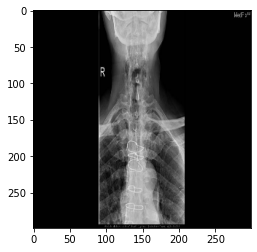

  9%|▉         | 130/1434 [24:11<5:34:15, 15.38s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: plan film ap view cervical spine in neutral position


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: multiple disc spaces squaring of the vertebral bodies fusion of the vertebral bodies fusion of the vertebral bodies , subluxation at the vertebral bodies , there is a disc space narrowing , there is a central disc space narrowing , which is also , and fusion of the annulus . there is mild narrowing of the disc space narrowing , there is a disc space narrowing , including the right vertebral bodies , including the ribs , and posterior to the ribs . there is also


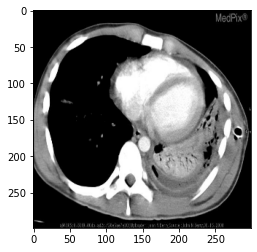

  9%|▉         | 131/1434 [24:21<4:58:37, 13.75s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: similar findings as in prior images . the air bronchograms are particularly well seen in this image .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: axial ct image through the chest demonstrates a large mass in the left lower lobe , lingula and upper lobe with associated with associated soft tissue mass .


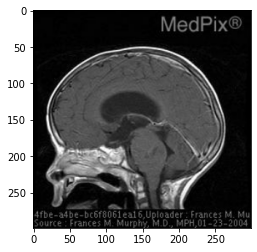

  9%|▉         | 132/1434 [24:31<4:34:47, 12.66s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: there is faint enhancement in the pons


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: sagittal t1 , sagittal t1 , and t2 weighted image demonstrates a large , enhancing mass in the left cerebellar hemisphere with a large amount of surrounding edema .


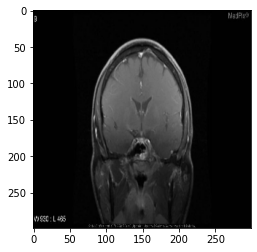

  9%|▉         | 133/1434 [24:39<4:05:05, 11.30s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: coronal anatomy: head and neck findings: [UNK] see extension through foramen [UNK] -some enhancing opacification of inferior sphenoid sinus -loss of fat planes in area of [UNK] [UNK] [UNK] and pterygoid muscles


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: there is a large mass in the left frontal lobe with surrounding edema .


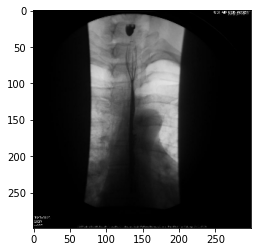

  9%|▉         | 134/1434 [24:48<3:48:26, 10.54s/it]

ORIGINAL ----------------
core modality: ugi modality: ugi - upper gi plane: coronal anatomy: abdomen findings: frontal image during the esophagram portion of the ugi series .


AI GENERATED ------------
core modality: bas modality: bas - barium swallow plane: coronal anatomy: abdomen findings: barium swallow study from a barium swallow study demonstrating a large mass in the left subclavian artery arising from the esophagus .


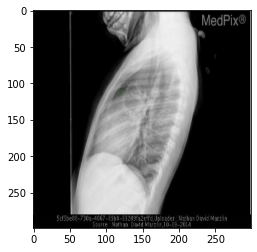

  9%|▉         | 135/1434 [25:06<4:38:08, 12.85s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: sagittal plane on chest x ray shows a circular density of unknown significance in the right upper lung .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: lateral view of the chest demonstrates a large mass in the left hemithorax with a large extrinsic mass effect on the left lower lobe . there is a large amount of peripheral consolidation is present . there is a mass in the left lower lobe . the mass is some associated with a large feeding arteries and pulmonary vascularity within the left pleural effusion .


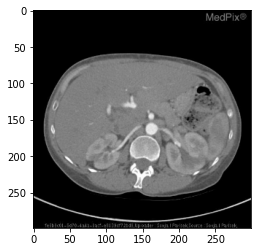

  9%|▉         | 136/1434 [25:14<4:05:55, 11.37s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: ct abdomen and pelvis w/ iv contrast , axial view renal infarct from septic emboli


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: large , heterogeneous mass with multiple cystic areas of low density lesions in the right lobe .


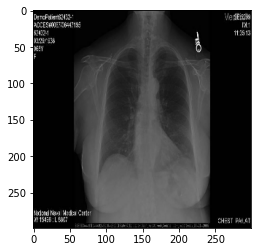

 10%|▉         | 137/1434 [25:33<4:58:43, 13.82s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa cxr of a 68 y/o female . note the pronounced aortic knob more lateral shadow of the descending aorta compared to the cxr of the young adult . the heart shadow is also borderline enlarged most commonly secondary to [UNK] hypertension .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: there is a large mass in the left upper lobe , which has been stable over the left hemithorax , and pulmonary arteries . the pulmonary arteries are clear . the patient is normal limits . there is a large pleural effusion is a well circumscribed , there is no evidence of the left hemidiaphragm . there is a large amount of pleural effusion .


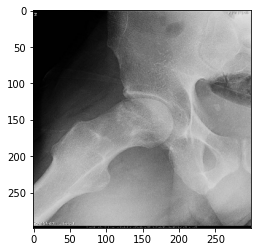

 10%|▉         | 138/1434 [25:46<4:50:32, 13.45s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the right hip shows serpiginous lines of sclerosis along the femoral head . there is also flattening of the right lateral femoral head with a subchondral fracture .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hip demonstrates a large lytic lesion with a lytic lesion of the proximal femoral head with a narrow zone of transition . there is periosteal reaction , and lytic lesion .


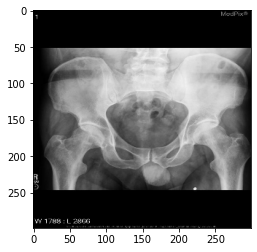

 10%|▉         | 139/1434 [25:56<4:27:28, 12.39s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: frontal radiograph of the pelvis demonstrates central sclerosis of the femoral heads and subtle serpiginous subchondral lucencies .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the pelvis demonstrates a large lytic lesion in the right femoral neck with a large lytic lesion with sclerotic margins .


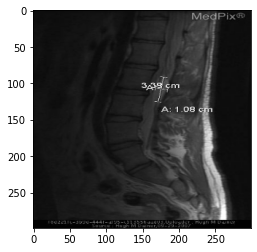

 10%|▉         | 140/1434 [26:08<4:27:57, 12.42s/it]

ORIGINAL ----------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: spine findings: the conus medullaris terminates somewhat inferiorly to the normal position at the l2 level . a 3 . 4 x 1 . 1 x 0 . 9 cm pd lesion is present at the termination of the conus medullaris , which is consistent with an intrathecal or intradural lipoma . while the cauda equina is tightly packed at the level of the lipoma , there is good dispersion inferiorly , without evident tethering and no significant nerve root stretching . the bone marrow is not pathologically infiltrated . there is no significant spondyloarthropathy of the lumbosacral spine .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: musculoskeletal findings: coronal and coronal t2 image of the left ankle demonstrate a large cystic mass with extension of the paraspinal rim enhancing nodule .


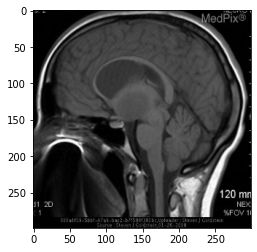

 10%|▉         | 141/1434 [26:18<4:07:31, 11.49s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: enhancing solid mass in left thalamus with cystic components invaginating into ventricular system . note artefact from braces on teeth .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: large , non-enhancing , left frontal and parietal lobes . enhancing lesion has cystic component . no associated with restricted diffusion .


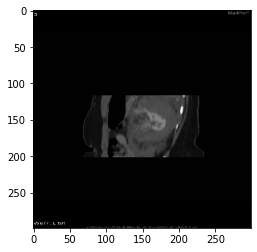

 10%|▉         | 142/1434 [26:25<3:44:08, 10.41s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: oblique anatomy: genitourinary findings: mpr oblique sagittal reformat ct image demonstrating a fatty mass in the left kidney , with a large subcapsular and perirenal hematoma .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal reformatted images demonstrate a large heterogeneous mass with sclerotic margins with surrounding soft tissue mass lesion .


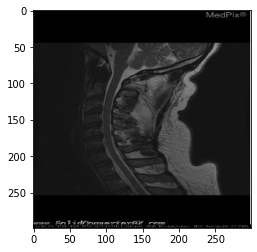

 10%|▉         | 143/1434 [26:31<3:10:48,  8.87s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: spine findings: sagittal mri revealing c5 fracture with displacement .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a large extruded disk l5/s1


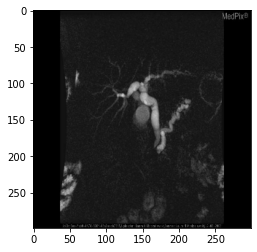

 10%|█         | 144/1434 [26:47<3:59:52, 11.16s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: 3d reconstruction anatomy: abdomen findings: mrcp - hi [UNK] . thick slab [UNK] te . double duct sign .


AI GENERATED ------------
core modality: an modality: mra - mr angiography/venography plane: coronal anatomy: cardiovascular findings: contrast enhanced mra of the right side of the level of the neck demonstrates a large heterogeneous enhancement of the right lobe of the left lobe . the mass is demonstrated . the mass is present within the mass and displaces the left ventricle and the normal . this is not shown is unremarkable .


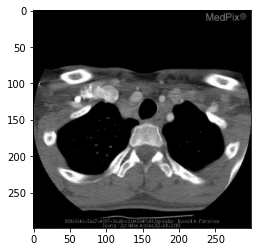

 10%|█         | 145/1434 [26:56<3:44:40, 10.46s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: ct slice image axial- enlarged lymph nodes in upper mediastinum


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the esophagus and extending into the esophagus .


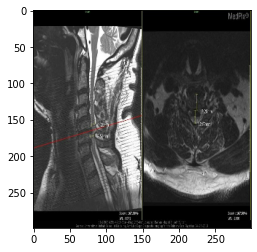

 10%|█         | 146/1434 [27:16<4:42:39, 13.17s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: brain findings: mri t2 weighted fse torg ratio measurements


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a 2 x 1 . 2 cm x 1 . 7 . 4 cm x 1 . 0 cm x 1 . the right paraspinal and 7 . 0 cm x 1 cm well defined , which arises from the left neural foramen , the right psoas muscle , which is present within the left neural foramen , punctate calcificaiton within which likely represents dystrophic calcification from fat necrosis .


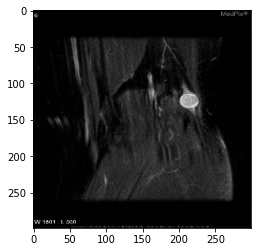

 10%|█         | 147/1434 [27:27<4:31:36, 12.66s/it]

ORIGINAL ----------------
core modality: mr modality: mr - other pulse seq . plane: coronal anatomy: musculoskeletal findings: coronal t2w image with fat saturation demonstrates small , well circumscribed , smooth and fusiform hyperintense mass arising from the common peroneal nerve , with central intermediate and peripheral hyperintensity target sign


AI GENERATED ------------
core modality: mr modality: mr - pdw proton density plane: coronal anatomy: musculoskeletal findings: coronal mr image demonstrates a well circumscribed , rounded lesion in the medial meniscus with a high signal intensity rim of low signal intensity on t2 signal on t2 images .


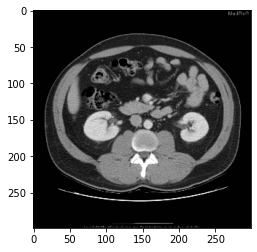

 10%|█         | 148/1434 [27:44<4:59:18, 13.96s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: normal enhancement . hypertrophied cortex seen extending into the left renal sinus .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: right kidney is a large , heterogenous mass with cystic components . the mass is seen on the right . there is a large , there is a large amount of fat stranding in the mass effect on the right kidney , which is no evidence of fat stranding . there is no evidence of the left kidney .


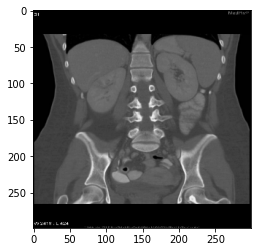

 10%|█         | 149/1434 [27:55<4:36:44, 12.92s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: coronal anatomy: genitourinary findings: multiple wedge shaped areas of decreased parenchymal enhancement on the right kidney . incidental osteoma seen on the left femoral neck in continuity with the cortical margin .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: genitourinary findings: coronal reformatted images demonstrate a large , heterogeneous mass arising from the left kidney with a large amount of surrounding soft tissue mass effect on the right kidney .


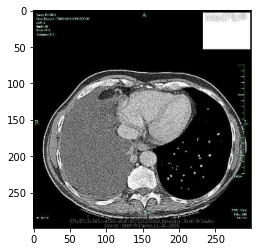

 10%|█         | 150/1434 [28:04<4:12:02, 11.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: right sided pleural effusion


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large mass in the right upper lobe with associated soft tissue mass . mass has both lungs and mediastinal lymphadenopathy .


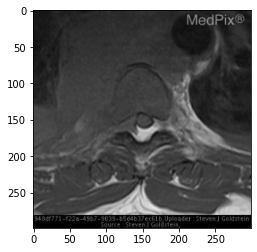

 11%|█         | 151/1434 [28:09<3:33:21,  9.98s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: abdomen findings: intraspinal , extradural mass thoracic spine


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: spine findings: enhancing mass extending from t12 to upper sacral canal


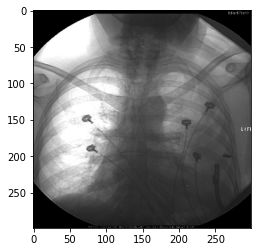

 11%|█         | 152/1434 [28:18<3:22:51,  9.49s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure specify in caption plane: coronal anatomy: pulmonary findings: fluoroscopic spot image demonstrates proper placement of a 14 french [UNK] drain [UNK] that had been placed under us and fluoroscopic guidance . [UNK] of purulent [UNK] fluid was aspirated during placement .


AI GENERATED ------------
core modality: int modality: interventional procedure plane: coronal anatomy: cardiovascular findings: fluoroscopic imaging demonstrates a filling defects in the right lower lobe of the left lower lobe pulmonary artery .


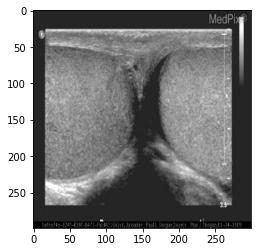

 11%|█         | 153/1434 [28:25<3:06:46,  8.75s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse gray-scale sonographic image through the testes reveals normal appearing testes with homogeneous echotexture .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: sagital view of the uterus demonstrates a tubular structure within the left ovary .


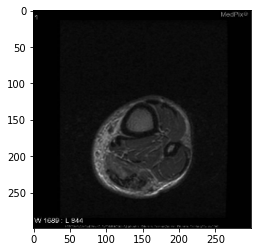

 11%|█         | 154/1434 [28:43<4:06:11, 11.54s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: t2w non-fat saturated images revealed clumping of the gastrocnemius myotendinous junction .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: axial mr of the left knee demonstrates a well defined , low signal intensity lesion in the left femoral condyle , consistent with a narrow zone of transition . the mass is present . there is a large lytic lesion is a chondroid matrix within the lesion is consistent with a large joint effusion is seen in the left femur .


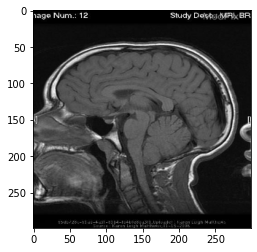

 11%|█         | 155/1434 [28:51<3:43:33, 10.49s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: mri sagittal t1 image demonstrating the cerebellar tonsils 6 . 5 mm below the foramen magnum


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a mass in the left frontal lobe with a large amount of surrounding edema .


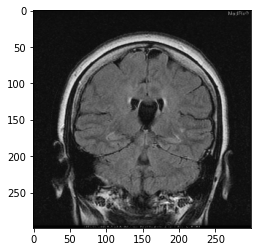

 11%|█         | 156/1434 [29:02<3:48:27, 10.73s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: brain findings: fluid filled cavity between walls of the lateral ventricles in the same patient . t2w flair coronal .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: coronal t1 weighted mr image demonstrates a large mass in the right frontal lobe with a large mass arising from the left lateral ventricle and enhancement of the mass enhances homogeneously .


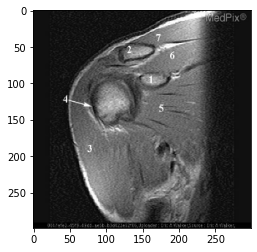

 11%|█         | 157/1434 [29:12<3:44:05, 10.53s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal mr of the shoulder 05 1 . coricoid process 2 . distal clavicle 3 . deltoid muscle 4 . biceps tendon long head 5 . subscapularis muscle 6 . supraspinatus muscle 7 . trapezius muscle


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal mr of the shoulder 04 1 . coricoid process 2 . distal clavicle 3 . deltoid muscle 4 . deltoid muscle


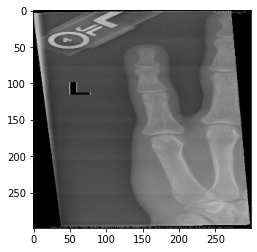

 11%|█         | 158/1434 [29:22<3:41:11, 10.40s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: subtle loss of continuity at lateral base of distal phalanx with subtle [UNK] lucency extending across base to medial edge of distal phalanx .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hand demonstrates a lytic lesion with a lytic lesion of the proximal tibia with sclerotic margins and proximal phalanx .


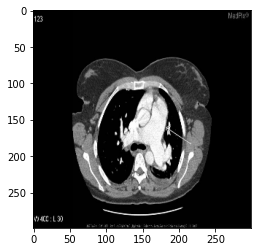

 11%|█         | 159/1434 [29:34<3:51:59, 10.92s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: the main , right , and left pulmonary arteries are enlarged secondary to the left to right shunt through the atrial septal defect .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images with intravenous contrast material demonstrate a large amount of air fluid collection in the left upper lobe with surrounding soft tissue mass . peripheral enhancement of the left lower lobe .


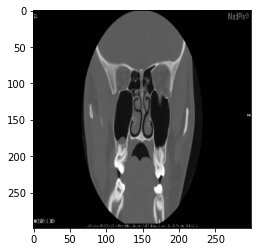

 11%|█         | 160/1434 [29:45<3:51:04, 10.88s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: fracture of the left inferior orbital wall with herniation of fat


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: coronal ct of the head demonstrates a nondisplaced fracture of the left maxillary sinus with extension into the maxillary sinus , ethmoid sinuses and ethmoid sinuses and sphenoid sinus .


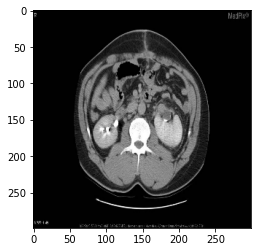

 11%|█         | 161/1434 [30:08<5:04:12, 14.34s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: 3 phase renal ct , 60 sec axial image . this single image demonstrates [UNK] renal excretion l < r the left kidney demonstrates delayed excretion . also , there is focal soft tissue attenuation in the left extrarenal pelvis at the proximal ureteral orifice , likely obstructing urine outflow . [UNK] , this likely represents a clot .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: axial ct images demonstrate a large , heterogenous mass in the right kidney , with areas of the left kidney . minimal mass effect on the mass effect on the right . the lesion is not appear to be seen on the left . there is no contrast is seen . there is a small amount of contrast within the left renal parenchyma . on the right kidney is no evidence of contrast .


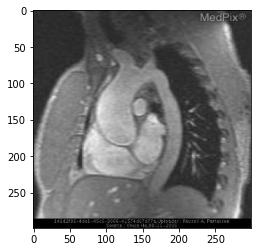

 11%|█▏        | 162/1434 [30:24<5:17:24, 14.97s/it]

ORIGINAL ----------------
core modality: mr modality: mr - other pulse seq . plane: sagittal anatomy: cardiovascular findings: figure d . sagittal ssfp on dir fse images a , axial b , sagittal , dilation of the ascending aorta to 4 . 8 cm is well seen . this is confirmed on corresponding bright blood images c , axial d , sagittal performed using a steady state free precession pulse sequence . ao ascending aorta


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: musculoskeletal findings: coronal t1 weighted mr image demonstrates a large mass lesion with low signal intensity within the left hemipelvis . mass extends into the right lateral ventricle and produces marked enhancement of the adjacent to the adjacent to the lateral ventricle and body of the adjacent to the mass .


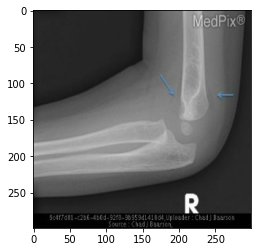

 11%|█▏        | 163/1434 [30:38<5:10:44, 14.67s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: single lateral radiograph of right elbow . notice the anterior fat pad [UNK] sign' and the visible posterior fat pad - suggesting joint effusion or hemoarthrosis .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the left shoulder demonstrates a well-defined geographic , geographic , well defined , irregular sclerotic margins , with a well defined , irregular sclerotic margins , periosteal reaction , periosteal reaction , and mass .


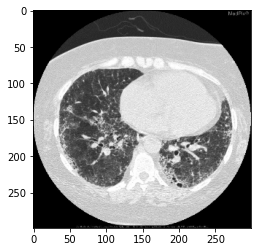

 11%|█▏        | 164/1434 [30:50<4:51:07, 13.75s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: hrct chest: peripheral/basilar honeycombing , irregular interlobular septal thickening , patchy ground glass


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the mass arising from the anterior mediastinum and extending into the upper lobes of the left lower lobe .


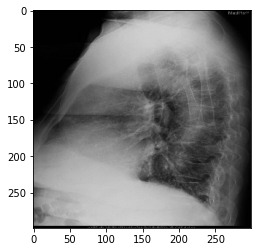

 12%|█▏        | 165/1434 [30:59<4:19:38, 12.28s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: lateral chest radiograph demonstrates no focal abnormalities . no secondary signs of pulmonary embolism , such as pleural effusion , oligemia , or apparent hilar enlargement , can be seen .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: pa chest radiograph demonstrates a large mass in the left upper lobe with a large left pleural effusion .


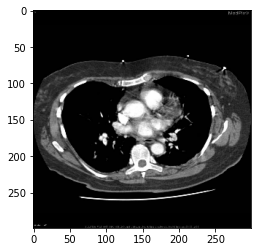

 12%|█▏        | 166/1434 [31:08<4:03:09, 11.51s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: ct pe/dvt protocol was limited secondary to patient's respiratory motion . a questionable filling defect is seen in the posterior segment of the left lower lobe .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the esophagus and extending into the esophagus .


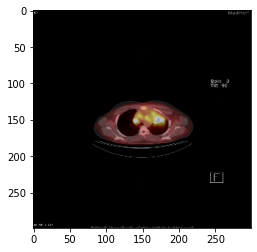

 12%|█▏        | 167/1434 [31:16<3:39:32, 10.40s/it]

ORIGINAL ----------------
core modality: pet/nm modality: pet - positron emission plane: axial anatomy: pulmonary findings: pet/ct showing lul involvement


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: there is a large soft tissue mass in the left lateral aspect of the left femoral neck .


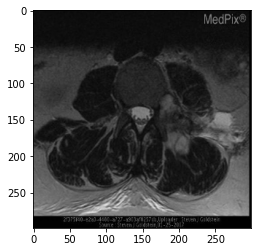

 12%|█▏        | 168/1434 [31:25<3:28:26,  9.88s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: mass is hyperintense and arises from l3 trasverse process


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: epidural collection extending from t12 to upper sacral canal . peripherally enhancing abscess right erector spinae multifidus and psoas muscles .


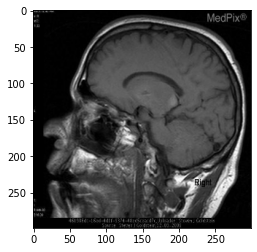

 12%|█▏        | 169/1434 [31:30<3:01:27,  8.61s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: note high signal intensity focus in posterior aspect of pulvinar nucleus . fabry disease .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: normal anatomy - labeled image


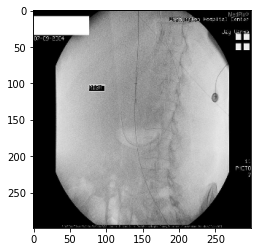

 12%|█▏        | 170/1434 [31:39<3:00:20,  8.56s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure plane: pa anatomy: cardiovascular findings: 4 . and this is confirmed with an oblique view .


AI GENERATED ------------
core modality: int modality: interventional procedure plane: coronal anatomy: cardiovascular findings: fluoroscopic imaging demonstrates a filling defects in the distal common femoral artery in the distal common carotid artery .


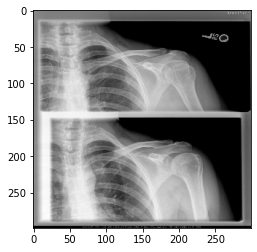

 12%|█▏        | 171/1434 [31:50<3:15:26,  9.28s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap views of the left shoulder in internal and external rotation demonstrate a posterolateral groove defect in the humeral head pathognomonic for hill sachs deformity .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left shoulder demonstrates a large lytic lesion with sclerotic margins in the left mid lung zone of the left hemithorax are present .


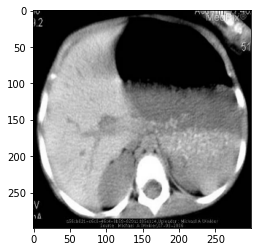

 12%|█▏        | 172/1434 [31:59<3:15:30,  9.29s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: generalized findings: non contrast ct shows hypodensity in the hepatic and portal veins suggesting anemia . the [UNK] of the radiopaque particles in patient's stomach remained a [UNK] . a blood lead level was obtained and was within normal limits .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: large , rounded , heterogeneous mass in the right upper quadrant , which is filled with surrounding inflammatory fat .


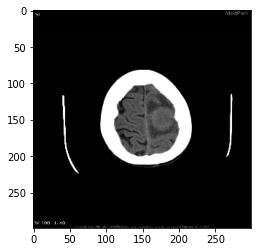

 12%|█▏        | 173/1434 [32:10<3:25:29,  9.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: slightly hyperdense rim compared to normal parenchyma


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct of the head demonstrates a large hyperdense mass in the right parietal lobe with cystic and solid components . there is associated cystic areas of surrounding edema and hemorrhage .


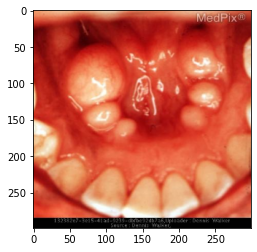

 12%|█▏        | 174/1434 [32:22<3:42:22, 10.59s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: head and neck findings: color photograph demonstrating bony growths arising from the inner margin of the mandible .


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: cardiovascular findings: this patient has been deployed in caliber of right side of right heart border on delayed imaging . also labeled: - left frontal , left frontal and left frontal lobe - left frontal lobe - aorta


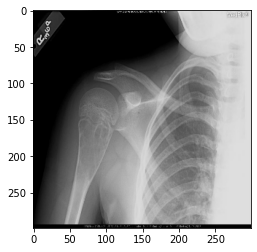

 12%|█▏        | 175/1434 [32:41<4:32:47, 13.00s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: frontal view internal rotation of the right shoulder prior to fracture . plain radiographs obtained approximately one month prior to the pathologic fracture demonstrate that the lytic lesion is central and metaphyseal in location , abuts the adjacent growth plate , is minimally expansile , is well circumscribed narrow zone of transition and is without associated periosteal reaction .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left shoulder demonstrates a well-defined lytic lesion in the humeral head of the humeral head with a narrow zone of transition and proximal humerus . there is mild endosteal scalloping and no evidence of transition . there is mild cortical thickening or periosteal reaction or soft tissue mass effect or periosteal reaction .


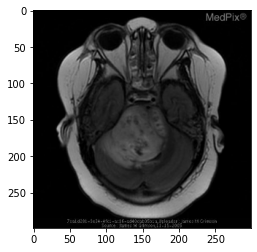

 12%|█▏        | 176/1434 [32:54<4:34:01, 13.07s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: this image demonstrates a heterogeneous mass centered in the pons , but also involving the cerebellum , effacing the fourth ventricle .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: large , cystic mass in the right middle cranial fossa with extension into the right middle cranial fossa . mass is isointense to the right cerebellar hemisphere . it is hyperintense on t1 and does not enhance .


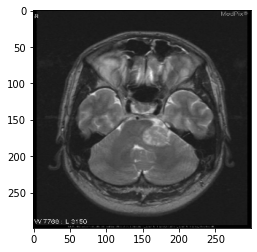

 12%|█▏        | 177/1434 [33:03<4:04:49, 11.69s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: mass lesion evident in axial section in the cpa with ice-cream cone morphology , originating from the ica . it is hyperintense compared to the surrounding brain parenchyma . seen at this level compressing the l . [UNK] .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: axial t2 weighted image demonstrates a large mass in the right cerebellopontine angle cistern .


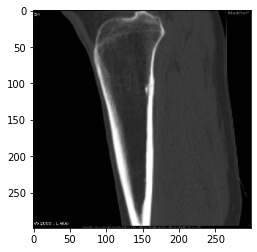

 12%|█▏        | 178/1434 [33:26<5:17:15, 15.16s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: musculoskeletal findings: periosteal bump , indicating reactive changes , in normal bone algorithm window and level


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: ap and lateral radiographs of the left knee demonstrate a well circumscribed , well defined , irregular sclerotic margins , geographic , which appears to the distal femur , which measures 2 . 5 cm in the distal femur , there is a thin , which is no other than 2 . there is a thin , there is a small areas of the soft tissue density , there is no periosteal reaction , well defined margins . there is no periosteal reaction , and mass


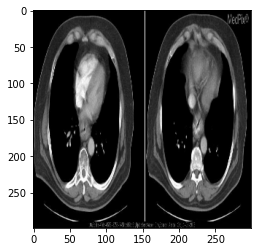

 12%|█▏        | 179/1434 [33:40<5:10:55, 14.86s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi contrast plane: axial anatomy: generalized findings: the lower esophagus just above the ge junction and for a [UNK] about 2 . 5 cm cranially , is thickened and apparently non [UNK] .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct of the chest with bone windows demonstrate a lytic lesion with lytic lesion of the left frontal bone . the lesion is present within the left lateral aspect of the left lateral aspect of the left maxillary sinus with bone .


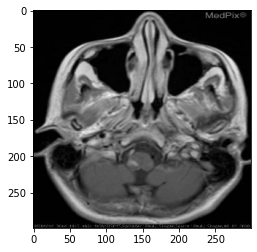

 13%|█▎        | 180/1434 [33:55<5:11:25, 14.90s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: t1 weighted post-gadolinium axial image reveals abnormal enhancement of the right lateral aspect of the medulla oblongata , and abnormal enhancement surrounding the wedge shaped defect in the left flocculonodular lobe . additionally , enhancement is noted within the right vertebral artery .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: head and neck findings: enhancing mass in the right neck with concurrent widening of the neck and neck and orbital roof . there is a large amount of the mass effect on the right optic nerve root demonstrates mild mass effect on the left orbit .


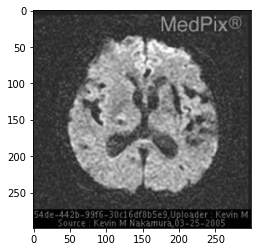

 13%|█▎        | 181/1434 [34:07<4:54:00, 14.08s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: appearance of left basal ganglia hemorrhage on axial diffusion weighted mri .


AI GENERATED ------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: multiple lesions in the basal ganglia and flair images . the lesions are all of these are hyperintense on t2 and flair and flair images . the lesions are hyperintense on t2 and t2 sequences .


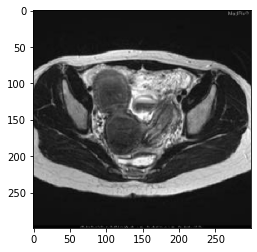

 13%|█▎        | 182/1434 [34:15<4:16:14, 12.28s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: genitourinary findings: right and left uterine horns , and left cervix


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: axial t1 weighted image demonstrates a large mass lesion with surrounding edema in the left femoral neck .


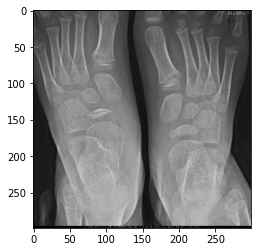

 13%|█▎        | 183/1434 [34:28<4:15:16, 12.24s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: sclerosis and narrowing of navicular bone .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a well-defined geographic , rounded density in the proximal tibia , with sclerotic margins , and proximal tibia , periosteal reaction , and periosteal reaction , and periosteal reaction .


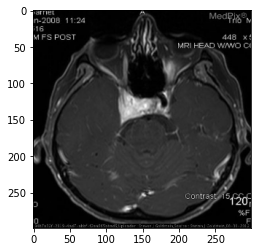

 13%|█▎        | 184/1434 [34:39<4:07:27, 11.88s/it]

ORIGINAL ----------------
core modality: an modality: cta - ct angiography plane: axial anatomy: brain findings: mr reveals loss of flow void right ica due to constriction by cavernous sinus meningioma .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: complex enhancing mass in the right cerebellar hemisphere with extension into the cavernous sinus . mass enhances homogeneously . mixed signal intensity of the middle cranial fossa .


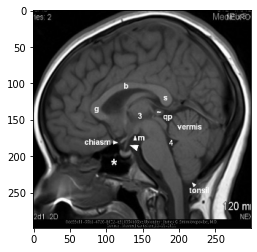

 13%|█▎        | 185/1434 [34:47<3:43:42, 10.75s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: partially empty sella . labelled: arrowhead - pituitary stalk - sphenoid sinus - pineal gland 3 - 3rd ventricle and massa intermedia 4 - 4th ventricle cerebellar tonsil chiasm [UNK] corpus callosum - [UNK] , [UNK] , [UNK] qp - quadrigeminal plate cistern vermis of cerebellum


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: 2 . 5 cm hypothalmic mass . irregular enhancement and irregular enhancement


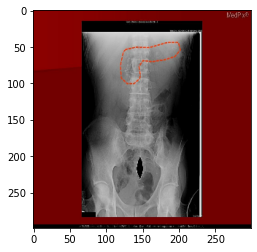

 13%|█▎        | 186/1434 [34:54<3:21:23,  9.68s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple nodular radiopacities , within the expected location of the pancreas red outline . there is an incidental finding of spina bifida [UNK] black in the sacrum you [UNK] that , of course .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple small bowel loops of bowel gas to the abdomen .


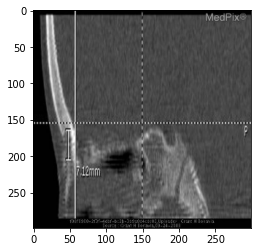

 13%|█▎        | 187/1434 [35:03<3:20:05,  9.63s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: brain findings: lateral ct reconstruction of the facial bones demonstrates a defect in the midline anterior calvarium with low attenution lesion occupying the nasofrontal interface


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal view of the left foot demonstrates a large lytic lesion with a lytic lesion in the left femoral condyle with bone marrow edema .


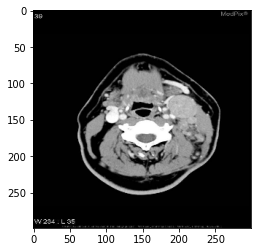

 13%|█▎        | 188/1434 [35:17<3:45:31, 10.86s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: head and neck findings: there is prominent adenopathy in the cervical region . the largest is the left [UNK] node , measuring 2 . 2 x 2 . 4 cm . there is a prominent chain of nodes extending inferiorly .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: axial ct images through the neck demonstrate a lobulated , lobulated , mass extending from the base of the base of the neck , petrous apex , and extends into the jugular foramen of the left maxillary sinus .


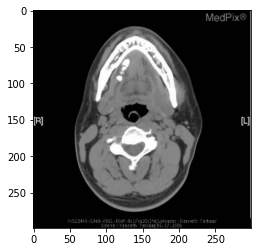

 13%|█▎        | 189/1434 [35:28<3:42:44, 10.73s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: multiple calcifications within the wharton's duct of the right submandibular gland causing dilation of the duct .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: there is a large , lobulated , lobulated , lobulated , mass arising from the mass arising from the nasopharynx and body of the sphenoid sinus .


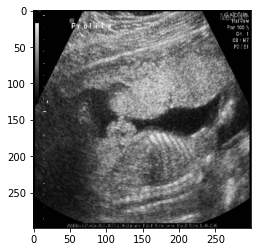

 13%|█▎        | 190/1434 [35:35<3:24:33,  9.87s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: abdomen findings: sagittal ultrasonographic image at a gestational age of 19 w 1 d demonstrates lobular bright small bowel loops herniated through an anterior abdominal wall defect .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: longitudinal image of the left kidney demonstrates normal appearing to the left kidney .


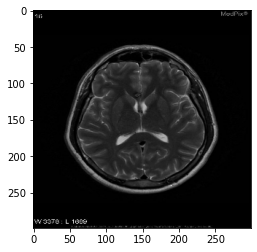

 13%|█▎        | 191/1434 [35:49<3:48:02, 11.01s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: t2 lesion anterior to the corpus callosum with a [UNK] core and a hemosiderin ring


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: there is a t2 hyperintense lesion in the right corona radiata which demonstrates homogeneous enhancement on the post-gadolinium images . there is no significant mass effect on the mass effect on the post-gadolinium images . there is no significant edema or edema .


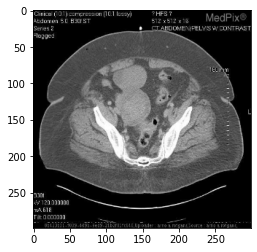

 13%|█▎        | 192/1434 [35:58<3:32:17, 10.26s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: generalized findings: interval decrease of pelvic mass


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: ct of the abdomen demonstrates a large mass in the right inguinal region with surrounding the left femoral vein .


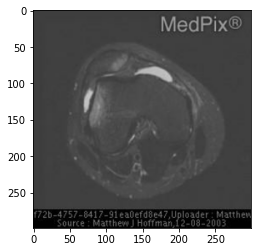

 13%|█▎        | 193/1434 [36:10<3:43:56, 10.83s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: there is increased t2 signal abnormality seen in the inferomedial aspect of the patella , consistent with contusion secondary to transient lateral patellar dislocation . there is abnormal t2 signal seen in the medial patellar retinaculum at its insertion point at the medial condyle consistent with partial tear . there is significant joint effusion .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: musculoskeletal findings: axial t2 with fat saturation shows a large mass lesion in the right femoral condyle with a large body and high signal intensity rim on t2 weighted fat saturation sequence .


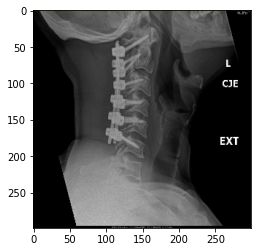

 14%|█▎        | 194/1434 [36:15<3:07:43,  9.08s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: extension view of cervical spine status post-posterior fusion


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: lateral view of cervical spine


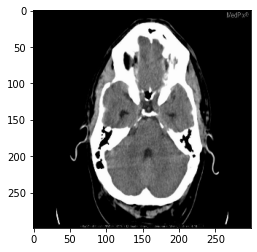

 14%|█▎        | 195/1434 [36:26<3:17:39,  9.57s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: spine findings: diffuse thickening of the meninges with abnormal enhancement extending into the sulci . no definite parenchymal component


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: there is a large mass in the left frontal lobe with extension into the left lateral ventricle . mass has a rim enhancement of the mass has fluid cystic component .


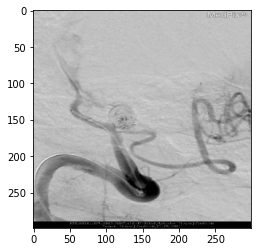

 14%|█▎        | 196/1434 [36:31<2:49:36,  8.22s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: sagittal anatomy: musculoskeletal findings: aneurysm treated with coil embolization .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: coronal anatomy: head and neck findings: right internal carotid artery aneurysm


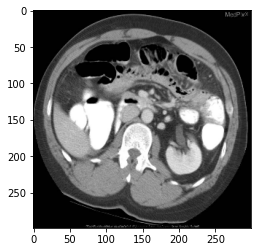

 14%|█▎        | 197/1434 [36:41<3:04:23,  8.94s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: axial ct image shows normal position and axis of left kidney .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images through the lower abdomen demonstrate a large , mass , edematous appendix which extends from the lumen of the left renal vein .


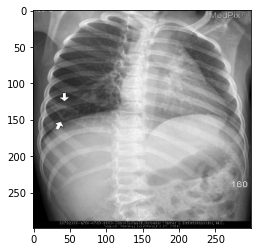

 14%|█▍        | 198/1434 [36:54<3:25:29,  9.98s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: brain findings: expansile and lytic lesion right 6th rib arrows , no reactive sclerosis .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph of the chest demonstrates a large mass in the left lower lobe with a left upper lobe mass effect on the left lung zone . there is no evidence of pleural effusion or pneumothorax .


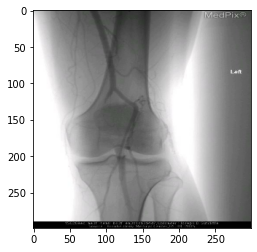

 14%|█▍        | 199/1434 [37:03<3:22:21,  9.83s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: coronal anatomy: cardiovascular findings: [UNK] frontal arteriogram at the level of the knee demonstrates complete occlusion and medial deviation of the popliteal artery with collateral [UNK] vessels [UNK] inferiorly


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left shoulder demonstrates a fracture lucency of the distal femur with a fracture lucency of the proximal tibia .


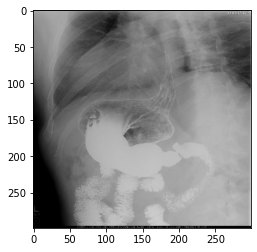

 14%|█▍        | 200/1434 [37:11<3:13:01,  9.39s/it]

ORIGINAL ----------------
core modality: bas modality: bas - barium swallow plane: coronal anatomy: abdomen findings: moderate size hiatal hernia


AI GENERATED ------------
core modality: bas modality: bas - barium swallow plane: ap anatomy: abdomen findings: contrast barium swallow study demonstrating a large mass in the esophagus with a large amount of contrast in the esophagus .


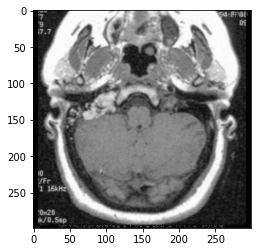

 14%|█▍        | 201/1434 [37:28<3:55:09, 11.44s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: head and neck findings: mr images demonstrate an irregular multilobulated and heterogeneous partially cystic and partially solid mass involving the petrous portion of the temporal bone . on the t1-weighted images , the mass has high signal intensity . on the t2-weighted images , there are curvilinear serpentine hypointensities , suggestive of vessels , hemosiderin deposition , or calcification . some of the right petrous mastoid air cells are fluid filled .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: mass in the right cpa cistern extending into meckle's cave . the mass lesion has both cystic and solid components and solid components . the mass has both cystic and solid components . the mass enhances homogeneously following contrast administration . the mass is not enhance .


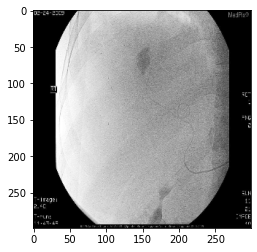

 14%|█▍        | 202/1434 [37:33<3:16:27,  9.57s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure plane: ap anatomy: cardiovascular findings: angiographic image after [UNK] of the afferent hepatic arterial branch with a microcatheter demonstrates focal collection of contrast consistent with a pseudoaneurysm .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: coronal anatomy: genitourinary findings: right renal artery


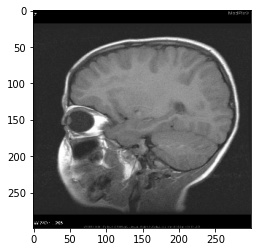

 14%|█▍        | 203/1434 [37:45<3:31:36, 10.31s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: head and neck findings: compare the elongated contour of this globe to the rounded right globe seen on the sag t1 image of the right .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a large , rounded mass in the right frontal lobe and parietal lobes . there is a large amount of surrounding edema and surrounding edema is associated with surrounding edema .


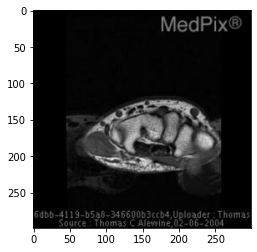

 14%|█▍        | 204/1434 [37:54<3:21:01,  9.81s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: partial fusion of capitate-hamate . normal bony mineralization , no soft tissue abnormalities , no fracture .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: the left shoulder 04 1 . 5 cm x 2 . 0 cm mass in the right clavicle .


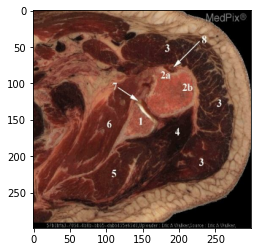

 14%|█▍        | 205/1434 [38:03<3:19:20,  9.73s/it]

ORIGINAL ----------------
core modality: gr modality: gr - gross photograph plane: axial anatomy: musculoskeletal findings: axial gross section 10 1 . glenoid 2a . lessor tuberosity 2b . greater tuberosity 3 . deltoid muscle 4 . teres minor muscle 5 . infraspinatus muscle 6 . subscapularis muscle 7 . superior labrum 8 . biceps tendon long head


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: musculoskeletal findings: gross section of the distal clavicle 2 . humeral head 2 . acromion 2 . deltoid muscle 4 . deltoid muscle


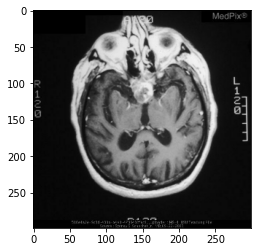

 14%|█▍        | 206/1434 [38:14<3:29:02, 10.21s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: contrast enhanced axial mri showing a partially cystic suprasellar mass .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: multiple lesions with some of the brain stem . no mass effect or intracranial involvement of the basal ganglia . no enhancement or intracranial involvement of the mass or spinal cord .


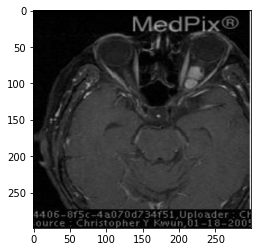

 14%|█▍        | 207/1434 [38:22<3:13:50,  9.48s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: axial anatomy: head and neck findings: the mass enhances intensely and is only slightly heterogeneous .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: large , non-enhancing , enhancing mass in the right middle cranial fossa with associated edema .


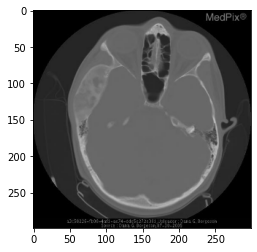

 15%|█▍        | 208/1434 [38:38<3:51:42, 11.34s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: right zygoma expansile osseous lesion , more superior view . ground glass appearance of matrix .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: stacked axial ct images of the head ct of the head and neck and neck and neck and neck demonstrate a well circumscribed mass in the right mandible with boney dehiscence of the skull base of the skull base of skull base secondary to the right zygomatic arch .


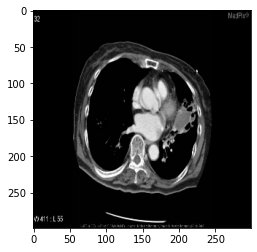

 15%|█▍        | 209/1434 [38:46<3:29:24, 10.26s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: axial ct image in soft tissue windows demonstrates a soft tissue mass within the lingula with surrounding dilated [UNK] .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large left mediastinal mass with mediastinal adenopathy and right pleural effusions .


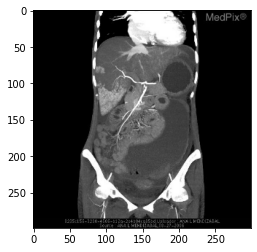

 15%|█▍        | 210/1434 [38:58<3:39:55, 10.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: abdomen findings: this is the arterial phase of the ct after bolus injections . there is an extensive and [UNK] fluid and gas collection , originating from the mesentery . congestive liver changes .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: coronal anatomy: abdomen findings: coronal ct image through the abdomen demonstrate a mass in the left kidney , which is present within the liver , which demonstrates a large amount of surrounding inflammatory fat stranding .


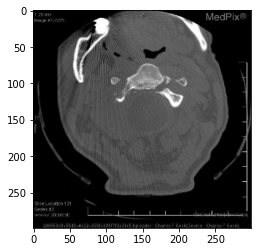

 15%|█▍        | 211/1434 [39:04<3:12:43,  9.45s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: spine findings: predominantly coronally oriented fracture of the posterior c2 body with an additional left parasagittal fracture component . this fracture extends into the left foramen [UNK] .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: lytic lesion of the mandible with boney tumor matrix .


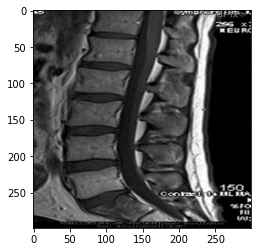

 15%|█▍        | 212/1434 [39:13<3:11:55,  9.42s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: musculoskeletal findings: . destructive lesion t10 with paraspinal and intraspinal mass compressing spinal cord . metastatic disease to multiple vertebral bodies including s1 .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: spine findings: enhancing epidural collection extending from t12 to upper sacral canal . peripherally enhancing abscess right erector spinae multifidus and psoas muscles .


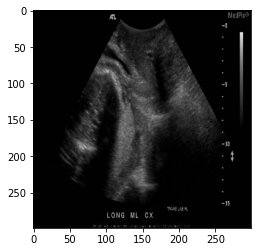

 15%|█▍        | 213/1434 [39:24<3:19:51,  9.82s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: this longitudinal translabial image shows the fetus in cephalic presentation with the tip of the placenta abutting and likely partially overlying the internal cervical os consistent with a marginal/partial placenta previa .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: head and neck findings: longitudinal view of the left neck demonstrates a large heterogeneous mass with heterogeneous soft tissue mass with extension into the left femoral neck and solid components .


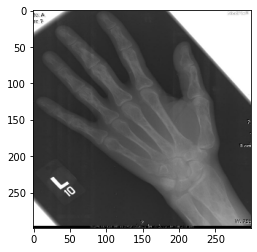

 15%|█▍        | 214/1434 [39:33<3:12:39,  9.48s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: multiple well circumscribed elongated flame shaped cortical lucencies throughout the hand .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hand demonstrates a non-displaced fracture lucency with a non-displaced fracture .


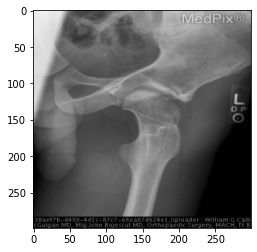

 15%|█▍        | 215/1434 [39:43<3:19:59,  9.84s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: [UNK] magna deformity of the head of the femur and short wide neck of the femur most likely due to old healed [UNK] disease . osteochondral irregularity probably a nondisplaced fragment of osteochondritis [UNK] is present . well formed acetabular roof may be indicative of past surgical correction .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a lytic lesion in the proximal tibia , with sclerotic margins , with sclerotic margins .


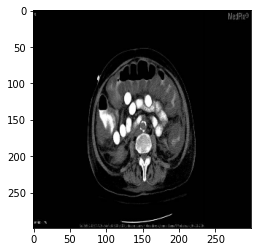

 15%|█▌        | 216/1434 [39:56<3:38:46, 10.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: axial ct image at the level of the transverse [UNK] pancolitis . representative image at the transverse colon . note marked thickening of the bowel wall and haustra . accordian sign with stripes of contrast trapped between nodular , thickened haustra .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images demonstrate a large , lobulated , enhancing mass arising from the right upper quadrant mass arising from the left kidney . the mass is associated post-stenotic dilation of the liver .


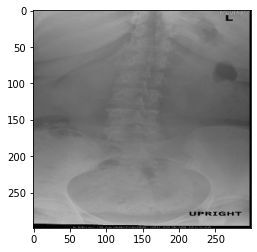

 15%|█▌        | 217/1434 [40:02<3:08:57,  9.32s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: right sided convex lumbar spine . shows no acute fracture or dislocation of the lumbar spine .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: multiple fractures of the lumbar spine .


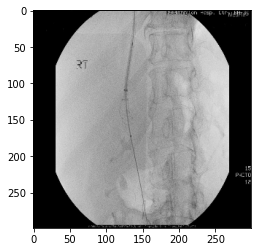

 15%|█▌        | 218/1434 [40:09<2:50:47,  8.43s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: deployment of 10 mm x 5 cm [UNK] [UNK] graft


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: catheter angiogram shows a catheter angiogram of the left gonadal vein .


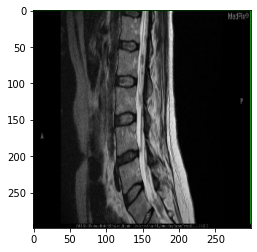

 15%|█▌        | 219/1434 [40:25<3:38:17, 10.78s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: diffuse hypointense nodular areas along the surface of the spinal cord and about the nerve roots of the cauda equina .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a large heterogenous mass in the left hemipelvis . mass has both t2 and t2 and t2 sequences . there is extension is extension of the thecal sac and extending into the thecal sac . there is extension into the left neural foramen and body and body and the thecal sac .


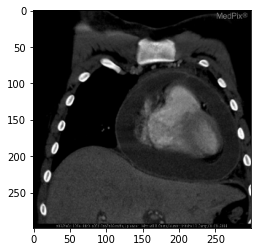

 15%|█▌        | 220/1434 [40:34<3:29:10, 10.34s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: cardiovascular findings: low attenuated rim around the heart in multiple images shows complete circumferential pericardial effusion .


AI GENERATED ------------
core modality: an modality: cta - ct angiography plane: axial anatomy: cardiovascular findings: a large aortic arch is present with a right aortic arch with a right subclavian artery arising from the esophagus .


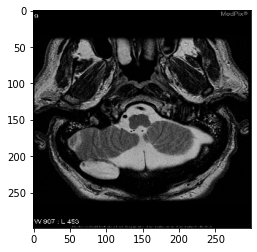

 15%|█▌        | 221/1434 [40:48<3:48:36, 11.31s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: axial t2 , lesion is homogeneously hyperintense


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: axial t1-weighted image demonstrates a well circumscribed mass in the left internal carotid artery arising from the left neck . there is a large amount of the mass measures approximately 2 . there is no evidence of invasion of central canal .


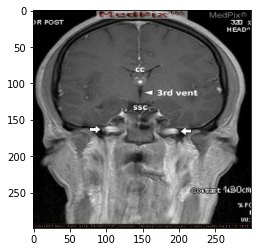

 15%|█▌        | 222/1434 [41:01<3:57:47, 11.77s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: colloid cyst of 3rd ventricle . also labeled: 3rd ventricle cc - corpus callosum [UNK] - supra sellar cistern arrows - internal carotid artery , just proximal to cavernous sinus


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: coronal t1 weighted image reveals the left cerebellar mass with extension into the left lateral ventricle . no definite extension into the mass effect or tectal plate . mass enhances homogeneously . no enhancement of mass .


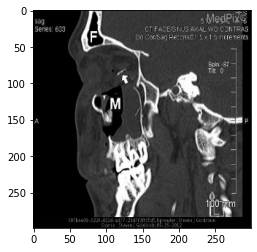

 16%|█▌        | 223/1434 [41:11<3:45:56, 11.19s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: orbital floor fracture with bone fragment arrow lying just beneath the optic nerve . inferior rectus muscle noted to be contused at time of surgery . also labeled: m - maxillary sinus air/fluid level


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: orbital floor fracture with bone erosion involving the left maxillary sinus . proptosis , ethmoid and ethmoid sinuses and ethmoid and ethmoid sinuses


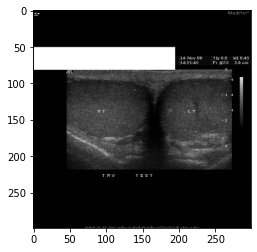

 16%|█▌        | 224/1434 [41:15<3:04:34,  9.15s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse image of the bilateral testicles demonstrates innumerable hyperechoic foci throughout the parenchyma . no solid masses are seen .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: right testicle


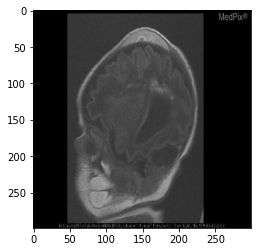

 16%|█▌        | 225/1434 [41:28<3:28:58, 10.37s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: sagittal anatomy: brain findings: there is a cephalohematoma along the high parietal skull . periventricular areas of abnormal signal is consistent with congenital calcification . there is marked ventriculomegaly with relatively normal extra-axial spaces consistent with brain volume loss .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: large , extra-axial , hyperattenuating and mass with cystic components , there is a large , which is a large , rounded , rounded , fluid collection of the right frontal lobe , and solid components .


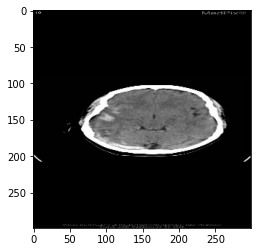

 16%|█▌        | 226/1434 [41:40<3:40:16, 10.94s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: non-contrast head ct show hyperdense right transverse sinus .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct of the head demonstrates a large , hyperattenuating mass , rounded , rounded , and heterogeneous density , with surrounding nidus of peripheral enhancement of the left lateral ventricles with surrounding edema .


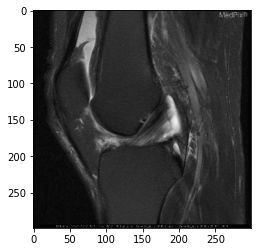

 16%|█▌        | 227/1434 [41:49<3:23:36, 10.12s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: musculoskeletal findings: the anterior cruciate ligament is intact . there is no marrow signal edema .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: musculoskeletal findings: coronal t2 weighted image demonstrates a high signal intensity within the medial meniscus with a small joint effusion .


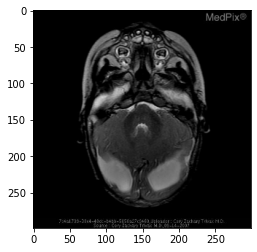

 16%|█▌        | 228/1434 [41:57<3:10:17,  9.47s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: the parts of the brain supplied by the posterior circulation are preserved such as the inferior temporal lobes , occipital lobes , [UNK] structures are formed as well . .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: axial t1 weighted image demonstrates a large mass in the left cerebellopontine angle cistern .


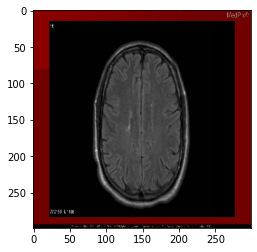

 16%|█▌        | 229/1434 [42:10<3:34:44, 10.69s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: there are several small periventricular hyperintensities .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: there is a mass in the left frontal lobe with a large mass effect on the left lateral ventricle . there is some enhancement of the mass effect on the left lateral ventricle is no significant mass effect on the post-gadolinium images .


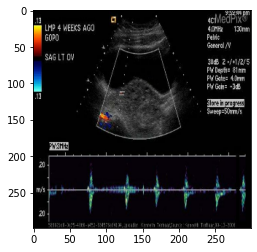

 16%|█▌        | 230/1434 [42:19<3:23:59, 10.17s/it]

ORIGINAL ----------------
core modality: us modality: us-d - doppler ultrasound plane: sagittal anatomy: genitourinary findings: [UNK] vascular flow with high resistance arterial flow in the left ovary .


AI GENERATED ------------
core modality: us modality: us-d - doppler ultrasound plane: axial anatomy: genitourinary findings: color doppler sonographic images demonstrate a large , rounded , rounded , rounded , and cystic structure within the right kidney .


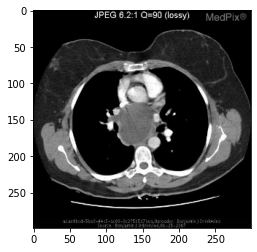

 16%|█▌        | 231/1434 [42:31<3:33:19, 10.64s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: contrast-enhanced axial ct image of the chest demonstrates a large cystic structure in the middle mediastinum . there is peripheral enhancement , without internal enhancement . internal hu measurement was 25 , suggesting complex fluid . there were no vertebral anomalies identified .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images with intravenous contrast material demonstrate a large amount of air fluid collection in the left upper lobe with surrounding soft tissue density material in the left upper lobe .


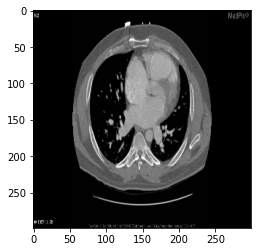

 16%|█▌        | 232/1434 [42:37<3:05:38,  9.27s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: a large [UNK] defect is noted . prominent pulmonary vascularity in the lungs .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: multiple filling defects in the pulmonary arteries .


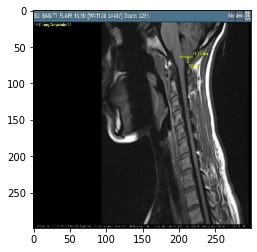

 16%|█▌        | 233/1434 [43:01<4:31:53, 13.58s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: sagittal anatomy: brain findings: this image show a t1 flair sagittal view of the [UNK] chiari malformation . measurements show the herniation descending 5 . 5 mm below the foramen magnum .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: sagittal t1 weighted image demonstrates a large , heterogeneous mass with a central , heterogeneous mass arising from the central portion of the spinal cord with a central canal . the mass is present at the spinal canal is present at the level of the spinal cord is present . there is a broad based extra-axial collection extending from the spinal cord is a moderate amount of the spinal cord is present at the posterior horn of the right lateral aspect of the left foramen .


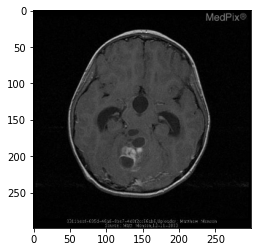

 16%|█▋        | 234/1434 [43:14<4:28:56, 13.45s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: large cystic , heterogeneously enhancing posterior fossa mass , centered within the fourth ventricle . the third and lateral ventricles are dilated . this mass was shown to be a pilocytic astrocytoma by tissue diagnosis .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: there is a large cystic mass in the left frontal and extending into the lateral ventricle . mass is ependymal surface of contrast administration . there is enhancement of the right lateral ventricle is no hydrocephalus .


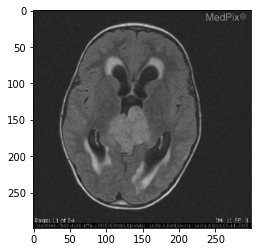

 16%|█▋        | 235/1434 [43:20<3:46:21, 11.33s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: hyperintense heterogeneous mass in the pineal region


AI GENERATED ------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: large extra-axial mass arising from the right lateral ventricle with hydrocephalus .


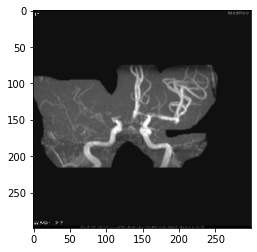

 16%|█▋        | 236/1434 [43:27<3:22:19, 10.13s/it]

ORIGINAL ----------------
core modality: an modality: mra - mr angiography/venography plane: 3d reconstruction anatomy: brain findings: mra tof imaging , anterior circulation: occluded distal right internal carotid artery and proximal first order branches .


AI GENERATED ------------
core modality: an modality: mra - mr angiography/venography plane: 3d reconstruction anatomy: brain findings: left internal carotid artery beginning in the right internal carotid artery .


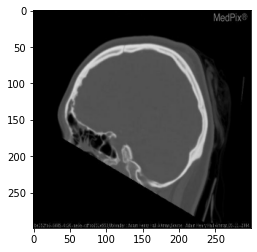

 17%|█▋        | 237/1434 [43:44<4:03:58, 12.23s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: head and neck findings: frontal sinus dehiscence


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct image of the head demonstrates a well circumscribed , well circumscribed , well defined , homogeneous mass arising from the posterior frontal sinus . mass is present within the mass and does not involve the orbit . there is enhancement of the mass . there is no definite destruction of the soft tissue component .


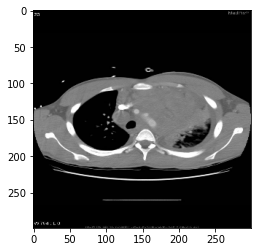

 17%|█▋        | 238/1434 [43:59<4:14:41, 12.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large heterogeneously enhancing mass , which appears to arise from the anterior mediastinum and extends into the left hemithorax . the mass encompasses a portion of the aortic arch and great vessels superiorly . the mass measures approximately 14 x 15 x 9 cm . the mass does not appear to invade the chest wall as there is preservation of the chest wall musculature and ribs .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large mass with calcifications in the right upper lobe , lingula and right middle lobe . left middle lobe with mass . low density lesions are present .


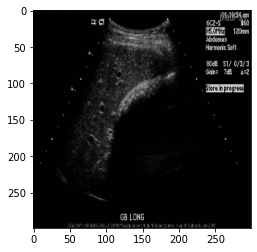

 17%|█▋        | 239/1434 [44:07<3:46:35, 11.38s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: longitudinal image demonstrates 2 thin hyperechoic layers with an intervening hypoechoic layer and clean posterior shadowing .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: longitudinal view of the gallbladder demonstrates a tubular structure with a tubular structure within the left ovary .


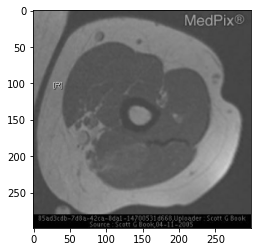

 17%|█▋        | 240/1434 [44:27<4:41:06, 14.13s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: soft tissue lesion in medial head of triceps slightly higher signal than muscle .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: musculoskeletal findings: axial t1 with fat saturation , and coronal and coronal t1 with fat saturation , coronal and coronal t1 with fat saturation , and t2 fat saturation of the right lower extremity demonstrates a large mass in the right iliac wing . a large heterogenous soft tissue mass lesion with a large body mass in the right iliac vein extending into the right lower pole of the left femoral neck .


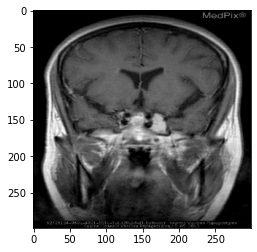

 17%|█▋        | 241/1434 [44:39<4:26:42, 13.41s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: post contrast coronal t1-weighted images reveal a homogeneously enhancing mass centered in the left meckel cave which is highly suggestive of trigeminal nerve schwannoma .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: there is a large mass in the right frontal lobe with associated edema and cystic component . mass is hyperintense on t2 and flair and flair imaging .


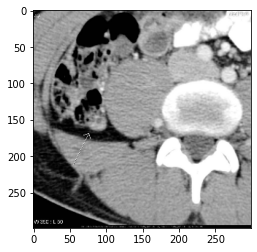

 17%|█▋        | 242/1434 [44:53<4:28:54, 13.54s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct demonstrates a second ring enhancing tubular structure off the posterior medial aspect of the cecum suggestive of a normal appendix .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial ct of the abdomen with oral and iv contrast demonstrate a large mass with oral contrast enhancement of the mass and surrounding the mass . the mass is seen to the fat circumferentially compatible with the left kidney mass index .


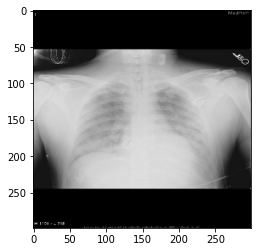

 17%|█▋        | 243/1434 [45:05<4:21:44, 13.19s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: 1st chest x-ray day 1 - [UNK] airspace opacity [UNK] with the presence of aspirated fluid in the airspaces after nearly [UNK] .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large left lung zone of the mass effect on the left . there is a spiculated 2 cm nodule is present .


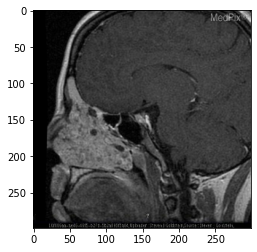

 17%|█▋        | 244/1434 [45:15<4:01:43, 12.19s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: partially calcified expansile mass in the left nasal cavity . no involvement of sella or suprasellar cistern noted on ct scan . no mass in sella or suprasellar cistern .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: large mass with contrast enhancement of the right cerebellar hemisphere . lesion has a large cystic and solid components contain flow voids .


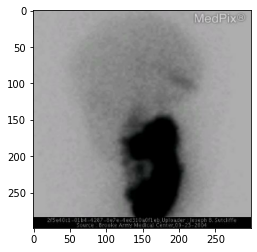

 17%|█▋        | 245/1434 [45:24<3:40:44, 11.14s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: sagittal anatomy: abdomen findings: lateral view of abdomen 4 hours after [UNK] injection . radiotracer is seen inferior and posterior to the liver . what [UNK] to the oblong collection of radiotracer seen on the 1 hour frontal view what is the faint collection of radiotracer in the gallbadder fossa is the gallbladder visualized here


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: abdomen findings: nuclear medicine scintigraphy study from the left hip shows a tc-99m mdp bone scan .


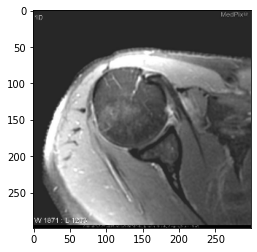

 17%|█▋        | 246/1434 [45:35<3:38:55, 11.06s/it]

ORIGINAL ----------------
core modality: mr modality: mr - pdw proton density plane: axial anatomy: musculoskeletal findings: below the level of the superior humeral head the hill sachs deformity is no longer visible . at this level both the humeral head and the labrum appear normal with clear [UNK] of low intensity visible at the anterior and posterior labrum .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: coronal anatomy: musculoskeletal findings: axial mr image demonstrates a low signal intensity lesion in the medial meniscus with a large amount of surrounding edema .


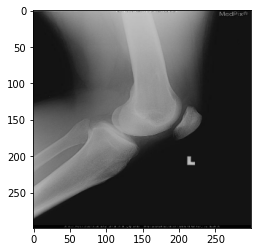

 17%|█▋        | 247/1434 [45:47<3:49:25, 11.60s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral view of the left knee . less obvious compared to the frontal view , there is a solitary osseous exostosis extending from the medial aspect of the distal left femoral metaphysis . normal-appearing marrow , cortex and periosteum extends from the underlying bone to the exostosis . no definite cartilage cap is observed on these images .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the left knee demonstrates a large lytic lesion with sclerotic margins with a narrow zone of transition . there is no periosteal reaction or periosteal reaction .


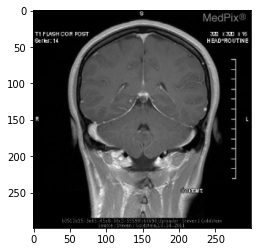

 17%|█▋        | 248/1434 [45:57<3:38:59, 11.08s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: the pineal cyst has a thin rim of peripheral contrast enhancement .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: coronal t1 post contrast enhanced mr image demonstrates a large mass in the left frontal lobe with enhancement of the right parietal lobe .


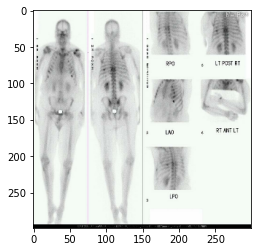

 17%|█▋        | 249/1434 [46:10<3:48:12, 11.56s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: nuclear medicine bone scan imaging demonstrating multiple bilateral anterior rib fractures from recent [UNK]


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: multiple flow in the left femur and delayed images demonstrate a focal uptake in the left femoral neck , consistent with a focal area of radiotracer uptake is seen in the left femoral head .


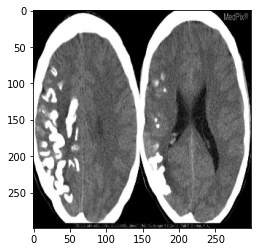

 17%|█▋        | 250/1434 [46:22<3:53:02, 11.81s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: these axial head ct images reveal gyriform calcification over the right cerebral hemisphere .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct of the head demonstrates a large , hyperattenuating mass , rounded , hyperattenuating and calcified structure , which is present in the left lateral ventricle , which is a large amount of peripheral rim of calcification .


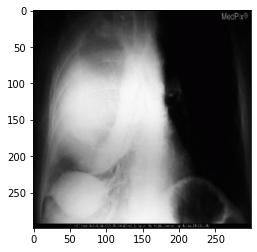

 18%|█▊        | 251/1434 [46:42<4:38:29, 14.12s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: current chest x-ray shows marked enlargement of mass .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: abdomen findings: frontal radiograph of the chest demonstrates a large mass with irregular borders and calcifications in the right upper lobe , which is normal limits . there is a large amount of air space narrowing of the left lower lung fields are clear . there is no evidence of air space disease . there is a large amount of air space narrowing of the left lower lobe .


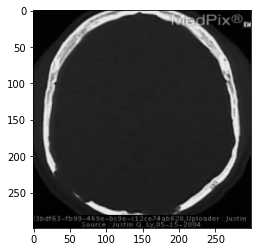

 18%|█▊        | 252/1434 [46:52<4:14:37, 12.93s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial noncontrast ct shows greater osteolysis of the inner table - compared to the outer - resulting in the beveled edge radiographic appearance .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: expansile lytic lesion involving the left frontal bone . lesion has a temporal bone and temporal bone . there is dense calcification and temporal bone .


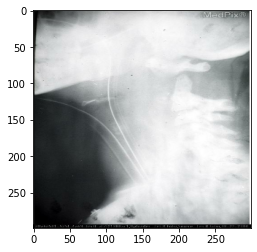

 18%|█▊        | 253/1434 [47:02<3:57:25, 12.06s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: lateral cervical spine , developed [UNK] in dip [UNK] . demonstrates dislocation of c1 and c2 note how well the ondontoid is seen since it is not obscured by c1 . also note the extreme soft tissue swelling anterior to the cervical spine , made further evident by the [UNK] of the et and ng tubes .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: frontal radiograph of the chest demonstrates a large mass with multiple nodular opacities with associated soft tissue component .


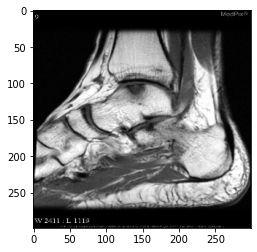

 18%|█▊        | 254/1434 [47:12<3:42:05, 11.29s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: sagittal anatomy: musculoskeletal findings: t1-weighted sagittal mr image of the left ankle shows an area of low signal intensity in the talar dome .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: musculoskeletal findings: there is a large lytic lesion involving the proximal aspect of the proximal tibia and proximal tibia with bone marrow edema .


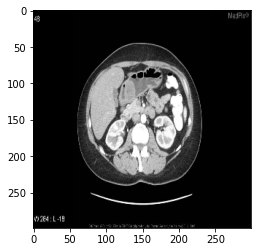

 18%|█▊        | 255/1434 [47:30<4:24:33, 13.46s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: enhancing soft tissue mass in antrum of stomach


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: multiple enhancing , scattered , enhancing , scattered , enhancing , enhancing , enhancing masses in the right kidney . some of the renal arteries are present . the mass is present . the mass is present within the mass is demonstrated on the left renal arteries and there is no significant displacement of the mass effect on the right renal cortex .


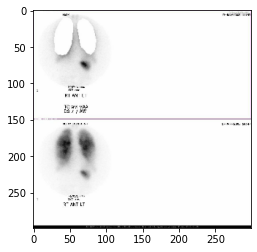

 18%|█▊        | 256/1434 [47:50<5:05:12, 15.55s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: pulmonary findings: nm perfusion images from a v/q study with a wide field of view to include the upper abdomen and neck , with [UNK] and [UNK] lungs , demonstrate radiotracer accumulation in the stomach and [UNK] gland consistent with free tc99m .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: delayed whole body images demonstrate a tc-99m mdp bone scan demonstrate a focal uptake in the left femoral head of the left femoral neck , and a tubular structure which measures 2 . 5 . 5 . 5 cm in diameter . 5 . 5 cm . 5 cm is seen in the right ovary is seen in this region of the left testicle .


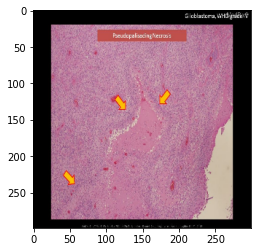

 18%|█▊        | 257/1434 [47:55<3:57:38, 12.11s/it]

ORIGINAL ----------------
core modality: he modality: he - med power 50-200x plane: multiple or montage anatomy: brain findings: pseudopalisading necrosis arrows .


AI GENERATED ------------
core modality: he modality: histology nos plane: photograph anatomy: head and neck findings: oligodendroglioma


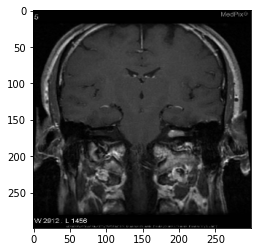

 18%|█▊        | 258/1434 [48:09<4:10:16, 12.77s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: coronal image reveals prominence of the left cn vii/viii with homogeneous enhancement of the left iac


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: coronal t1 weighted mr image demonstrates a hyperintense lesion in the left frontal lobe of the left frontal lobe . there is a mass is enhancement of the left lateral ventricle . it is isointense to arise from the mass and does not enhance .


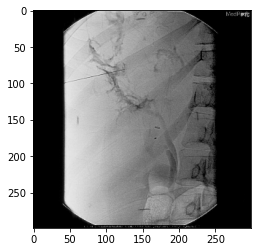

 18%|█▊        | 259/1434 [48:15<3:30:19, 10.74s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure specify in caption plane: coronal anatomy: abdomen findings: percutaneous cholangiogram obtained after the ct exam demonstrates an irregular appearance of the bile ducts with leakage of contrast from the biliary tree .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: catheter angiogram of the left renal artery .


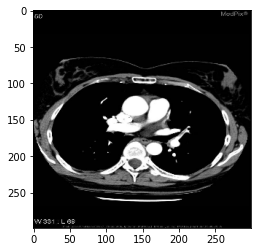

 18%|█▊        | 260/1434 [48:24<3:22:11, 10.33s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: ct pulmonary angiogram demonstrates extension of the previous filling defect into the lingular branch .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the esophagus and extending into the esophagus .


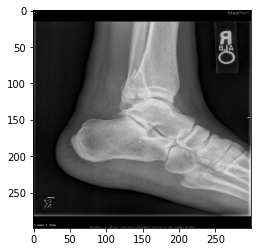

 18%|█▊        | 261/1434 [48:50<4:50:00, 14.83s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral ankle demonstrates minimally-displaced fracture of posterior , distal tibia .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: ap and lateral radiographs of the left ankle demonstrate a well circumscribed , well defined , well circumscribed , irregular sclerotic margins , which is present within the distal femur and there is a thin , which is a nondisplaced fracture line . the distal femur is present within the distal femur and the distal femur , which is a well defined , which is present within the lesion , the distal femur , but the lesion has a well as well as well defined ,


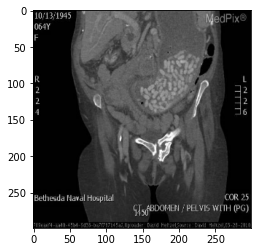

 18%|█▊        | 262/1434 [48:58<4:12:25, 12.92s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: abdomen findings: ct coronal [UNK] numerous [UNK] in the distended stomach


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: abdomen findings: coronal ct image through the lower abdomen demonstrate a mass in the left lower quadrant mass .


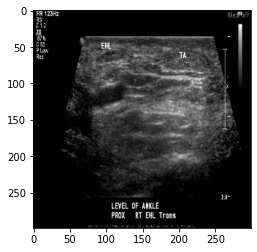

 18%|█▊        | 263/1434 [49:03<3:23:01, 10.40s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: musculoskeletal findings: normal extensor compartment of the right ankle with normal sized ta and [UNK]


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: right testicle


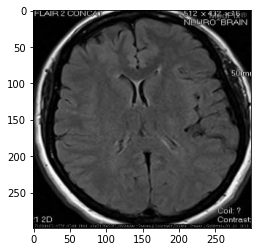

 18%|█▊        | 264/1434 [49:10<3:03:48,  9.43s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: note right frontal gray matter heterotopia


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: enhancing mass in the left frontal lobe . no definite parenchymal component .


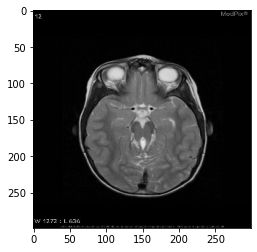

 18%|█▊        | 265/1434 [49:19<3:02:55,  9.39s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: axial t2w mr image demonstrates a molar tooth appearance of the superior cerebellar peduncles .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: axial t2 weighted image demonstrates a large mass in the left frontal lobe with a large amount of surrounding edema .


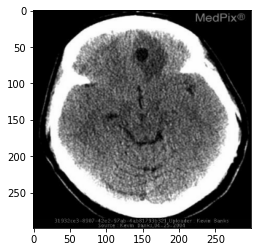

 19%|█▊        | 266/1434 [49:28<2:57:40,  9.13s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct through the level of the frontal lobes demonstrates a well defined intra-axial cystic lesion with a surrounding rim of edema .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct scan hemorrhagic mass in right frontal lobe . temporal and parietal lobes . no restricted diffusion .


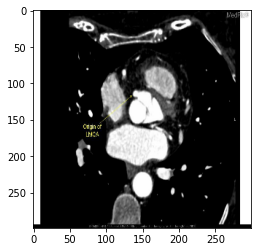

 19%|█▊        | 267/1434 [49:36<2:55:16,  9.01s/it]

ORIGINAL ----------------
core modality: an modality: cta - ct angiography plane: axial anatomy: pulmonary findings: see image


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: ct demonstrates a large filling defect in the left lower lobe of the left lower lobe pulmonary artery .


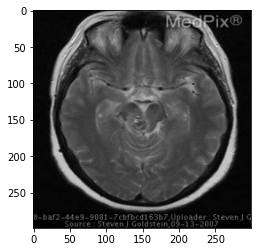

 19%|█▊        | 268/1434 [49:45<2:53:36,  8.93s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: acute midbrain hemorrhage [UNK] with cavernous angioma associated with developmental venous anomaly . this mri study from april , 2007 does not convincingly reveal the dva or angioma .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: multiple lesions involving both cerebral and white matter . no mass effect or pathologic enhancement .


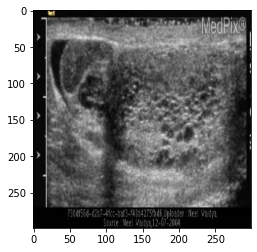

 19%|█▉        | 269/1434 [49:54<2:56:04,  9.07s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: longitudinal image of right testis demonstrates multiple cystic and tubular spaces enlarging the mediastinum of right testis .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal ultrasound image of the right kidney demonstrates a hypoechoic mass with a large cystic structure with surrounding the left ovary .


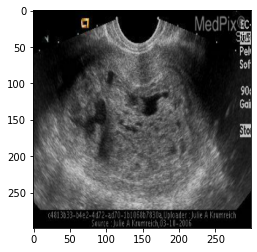

 19%|█▉        | 270/1434 [50:06<3:08:00,  9.69s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse image of the uterus demonstrating heterogeneous , [UNK] solid , partially cystic mass within the endometrium . [UNK] [UNK] was [UNK] , [UNK] .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with heterogeneous echogenicity involving the endometrial cavity . there is no evidence of hydronephrosis or calcifications .


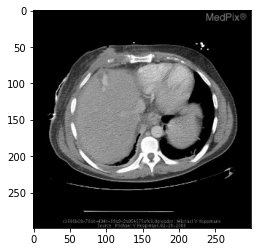

 19%|█▉        | 271/1434 [50:30<4:33:51, 14.13s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: another contrast-enhanced axial ct image performed about one week after the initial study shows the left hepatic lobe laceration with interval enlargement of the focal , puddle of contrast .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: axial ct image through the chest demonstrates a large mass in the left lower lobe , with extrinsic compressive atelectasis . there is mediastinal lymphadenopathy . there is a large , there is a large , there is a large mass in the right upper lobe , which arises from the right upper lobe , which is a large , left upper lobe , which likely represents dystrophic calcification , and pulmonary nodule in the right upper lobe . there is a large , there is a


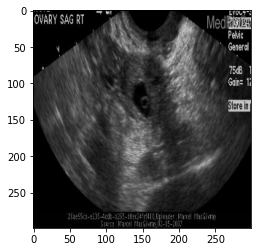

 19%|█▉        | 272/1434 [50:40<4:07:35, 12.78s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: coronal anatomy: genitourinary findings: there is a complex cystic mass in the right adnexa .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with a large cystic structure within the left ovary .


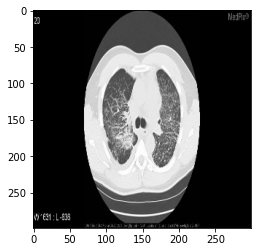

 19%|█▉        | 273/1434 [50:52<4:05:16, 12.68s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: irregular septal thickening with perilymphatic nodules in a patchy distribution .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: there is a large mass in the left upper lobe with multiple nodules . the lungs are present in the lungs are present in the right lower lobe . the right lower lobe and mediastinal adenopathy .


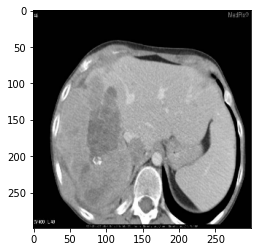

 19%|█▉        | 274/1434 [51:17<5:13:59, 16.24s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: large heterogenous liver lesion in the right lobe with a hypodense area that likely represents necrosis and an area of calcification centrally .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct image through the abdomen demonstrates a large mass in the region of the liver , which is present in the left kidney , which is seen on the ct and there is a large , which demonstrates a large , which is a large , rounded , which is a large , which is a large , rounded , which is a cystic lesion in the right lobe of the left renal vein , which is seen . there is a large ,


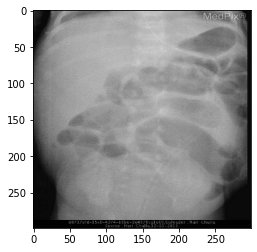

 19%|█▉        | 275/1434 [51:33<5:16:42, 16.40s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: 3 weeks follow up shows dilated bowel loops .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: frontal radiograph of the abdomen demonstrates a large mass in the stomach , and gas , which is seen on the right lower quadrant . there is a large bowel wall , and abdominal wall thickening of the stomach , and the stomach , and air trapping or free air .


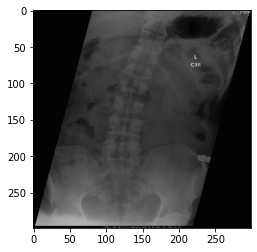

 19%|█▉        | 276/1434 [51:51<5:25:57, 16.89s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: left lateral flexion view of the lumbar spine from initial presentation at the ed


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple fluoroscopic spot views of the abdomen demonstrate a small bowel loops of the abdomen in the abdomen in the abdomen . there is a paucity of bowel gas in the bowel wall , there is no evidence of bowel gas , gas to the abdomen . there is no evidence of bowel gas in the abdomen .


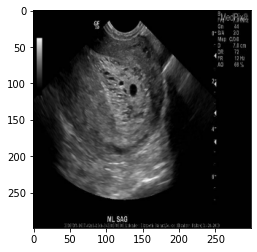

 19%|█▉        | 277/1434 [52:02<4:47:00, 14.88s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: initial study demonstrating a 5 . [UNK] . [UNK] . 8 mm cystic structure within the uterus .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: coronal ultrasound image of the left kidney demonstrates a large heterogeneous mass with a cystic structure with a cystic structure within the left ovary .


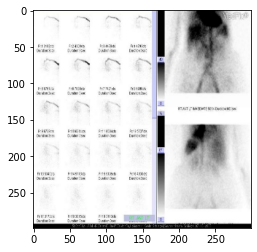

 19%|█▉        | 278/1434 [52:09<4:01:08, 12.52s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: ap anatomy: musculoskeletal findings: flow and immediate anterior and posterior planar images are unremarkable .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple dilated loops of small bowel gas in the right lower quadrant


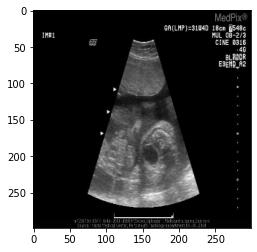

 19%|█▉        | 279/1434 [52:17<3:38:56, 11.37s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: abdomen findings: axial view of the fetus at the level of the bladder left with free floating intestines demonstrated right .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal ultrasound of the right kidney demonstrates a large heterogeneous mass with heterogeneous mass effect with cystic components .


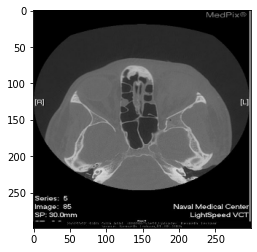

 20%|█▉        | 280/1434 [52:26<3:23:30, 10.58s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: bone window showing lateral and posterior orbital wall rupture . there abnormal morphology and contour of the left globe with associated hemorrhage .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal ct of the pelvis demonstrates a large lytic lesion with sclerotic margins with sclerotic margins .


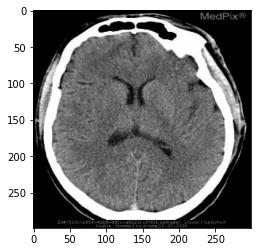

 20%|█▉        | 281/1434 [52:36<3:16:59, 10.25s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct shows high density focus in the superior saggital sinus representing thrombus .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct of the brain demonstrates a large left frontal lobe mass with surrounding edema in the left lateral ventricle .


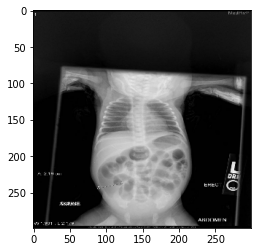

 20%|█▉        | 282/1434 [52:42<2:56:16,  9.18s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: supine radiograph of the chest and abdomen demonstrates numerous dilated air-filled loops of bowel .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple dilated loops of bowel loops of bowel loops


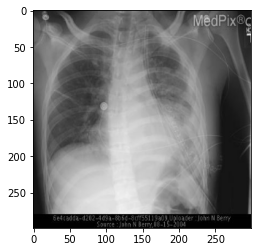

 20%|█▉        | 283/1434 [52:52<2:56:42,  9.21s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: note drainage of empyema , remaining air space consolidations , post-surgical staples from the left thoracotomy , and two intra-operative chest tubes .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: frontal radiograph of the chest demonstrates a large mass with calcifications in the right upper lobe pulmonary artery .


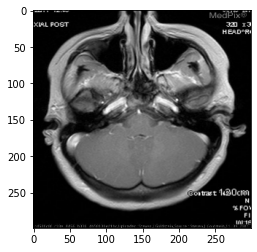

 20%|█▉        | 284/1434 [53:01<2:58:02,  9.29s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: normal anatomy at this level


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: enhancing mass in the left cerebellar hemisphere with extension into the cerebellar hemisphere . mass enhances homogeneously . there is no hydrocephalus .


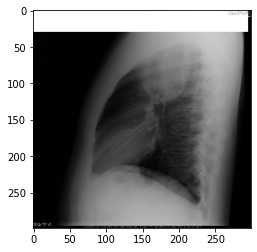

 20%|█▉        | 285/1434 [53:11<3:00:01,  9.40s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: lateral chest confirming abnormal density of right hemithorax seen on previous c-spine to be a middle mediastinal mass


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa and lateral chest radiographs demonstrate a large mass in the right upper lobe , lingula , with bilateral pleural effusion .


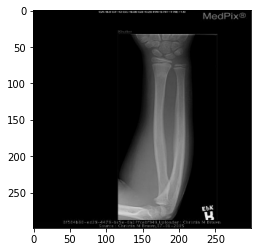

 20%|█▉        | 286/1434 [53:22<3:10:36,  9.96s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: frontal view is without obvious abnormality of the epiphysis , although there is faint sclerosis within the distal radial metaphysis . no cortical irregularity is noted .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hand demonstrates a lytic lesion with sclerotic margins with a narrow zone of the osseous destruction , periosteal reaction , and periosteal reaction .


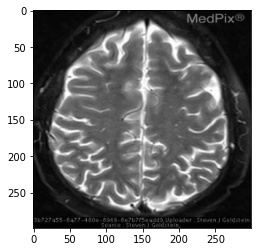

 20%|██        | 287/1434 [53:31<3:04:38,  9.66s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: mri: venous infarct in left frontal lobe . no evidence of restricted diffusion or adc map abnormality . thrombosed vein has low signal on gre sequence . mrv: absent signal right transverse sinus . absent signal at level of occluded left frontal vein


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: multiple lesions in the basal ganglia and flair sequences . no mass effect or pathologic enhancement .


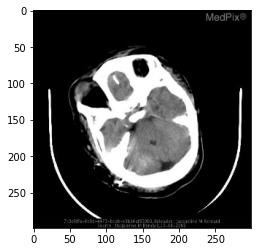

 20%|██        | 288/1434 [53:43<3:19:35, 10.45s/it]

ORIGINAL ----------------
core modality: ct modality: ct - montage plane: axial anatomy: brain findings: normal sized posterior fossa with absent vermis and posterior fossa cyst .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct image of the head demonstrates a large mass in the right middle cranial fossa with associated soft tissue mass effect and ependymal ventricular wall thickening of the left ventricular wall .


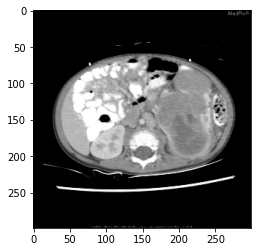

 20%|██        | 289/1434 [53:59<3:48:48, 11.99s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: multiple nephrogenic rests , variable in size , in bilateral kidneys with characteristic homogeneous , hypodensity after contrast administration . the predominant mass involving the upper pole of the left kidney demonstrates heterogeneous enhancement consistent with a wilm's tumor . also on this image , there is an enhancing left para-aortic mass that likely represents metastatic lymphadenopathy .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: large , heterogeneous , heterogeneous mass , solid , solid , cystic mass , and solid components , with cystic components , in the mass . the mass extends into the renal cortex is seen on the right . there is no contrast .


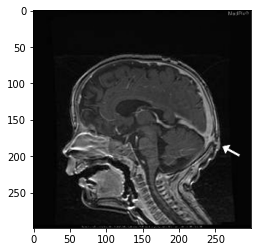

 20%|██        | 290/1434 [54:08<3:31:51, 11.11s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: head and neck findings: t1 sagittal mr image post contrast demonstrating contrast flow through the [UNK] and into the [UNK] venous system


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a large , rounded mass in the right frontal lobe with surrounding edema and flair images .


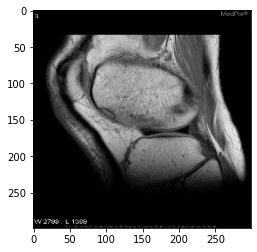

 20%|██        | 291/1434 [54:21<3:45:31, 11.84s/it]

ORIGINAL ----------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: sagittal proton density image demonstrates a nondisplaced osteochondral fracture in the anterior aspect of the lateral femoral condyle .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: musculoskeletal findings: coronal mr image demonstrates a well defined , low signal intensity mass in the medial meniscus , with a large amount of surrounding edema in the medial aspect of the mass effect on the left femoral condyle .


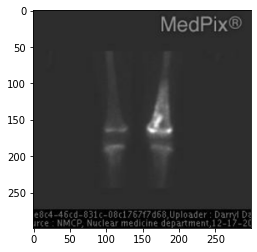

 20%|██        | 292/1434 [54:28<3:15:34, 10.28s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: increased [UNK] right distal femur


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: nuclear medicine bone scan demonstrates a tc-99m mdp bone scan .


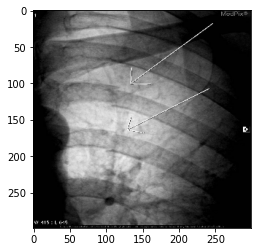

 20%|██        | 293/1434 [54:40<3:22:13, 10.63s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: musculoskeletal findings: inverted grayscale and magnified view of the rib fractures seen on the pa view .


AI GENERATED ------------
core modality: bas modality: bas - barium swallow plane: oblique anatomy: pulmonary findings: ap view of the left subclavian artery arising from the esophagus demonstrate a large diverticulum of the esophagus at the esophagus at the level of the esophagus .


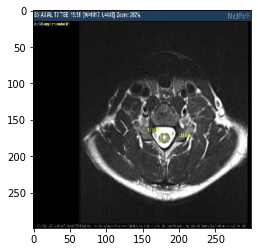

 21%|██        | 294/1434 [54:51<3:29:35, 11.03s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: brain findings: mri t2 axial demonstrating the syrinx in its greatest ap diameter 2 . [UNK] mm compared to the cord diameter 6 . 21 mm . ratio of 0 . 45


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: there is a t2 hyperintense lesion in the right side of the left side of the neck with a lesser sac and displaces the proximal portion of the sphenoid sinus .


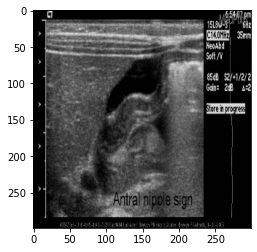

 21%|██        | 295/1434 [55:00<3:17:02, 10.38s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: longitudinal sonogram of the pylorus demonstrates hyperechoic redundant mucosa [UNK] into gastric antrum termed the antral nipple sign [UNK] 1995 .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: longitudinal ultrasound image of the left testicle demonstrates a tubular structure with a tubular structure in the left upper quadrant .


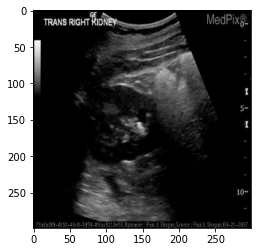

 21%|██        | 296/1434 [55:11<3:21:17, 10.61s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse gray-scale view of the lower pole of the right kidney demonstrates a small bright echogenic focus with possible shadowing suggestive of a nonobstructing renal stone .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with a cystic structure with a cystic mass arising from the left ovary and within the left ovary .


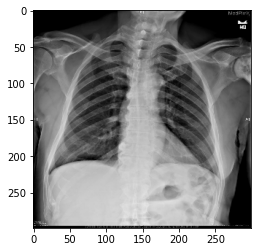

 21%|██        | 297/1434 [55:32<4:19:25, 13.69s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: frontal chest radiograph shows [UNK] with irregular mixed [UNK] changes to the left humeral head .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: pa radiograph of the chest demonstrates a large mass in the left hemithorax with a large mass effect on the left upper lobe , and pulmonary arteries . the mass is noted is present . there is a large mass is also noted in the left upper lobe of the left hemithorax with a large , and pulmonary arteries , punctate calcificaiton within which likely represents dystrophic calcification from fat necrosis .


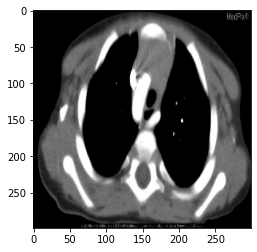

 21%|██        | 298/1434 [55:37<3:29:50, 11.08s/it]

ORIGINAL ----------------
core modality: an modality: cta - ct angiography plane: axial anatomy: pulmonary findings: demonstrates right-sided aortic arch with the left subclavian artery coursing behind esophagus .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: aberrant left subclavian artery .


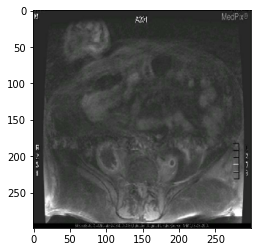

 21%|██        | 299/1434 [55:49<3:33:54, 11.31s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: musculoskeletal findings: axial [UNK] t1 weighted , postgadolinium mr image through the pelvis demonstrates a ring enhancing mass in the right psoas muscle . a small enhancing lesion incidentally noted on the left .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: genitourinary findings: multiple axial image through the lower pole of the left kidney demonstrates a large cystic mass with some associated soft tissue mass effect on the left ovary and the left testicle .


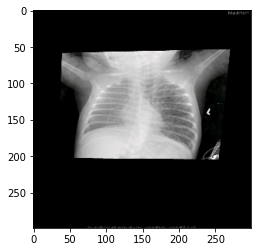

 21%|██        | 300/1434 [56:12<4:39:53, 14.81s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: hyperinflation of the left lung with streaky lucencies seen throughout the lung .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe consolidation as well as well as well as well as the right lung parenchyma . the mass is seen in the left upper lobe . there is a pleural effusion is also labeled: arrowheads - right upper lobe bronchus and left hemidiaphragm , and left upper lobe - left upper lobe , and right hilum as well as a pulmonary nodule in the left upper lobe pulmonary vasculature , left lung field , and right


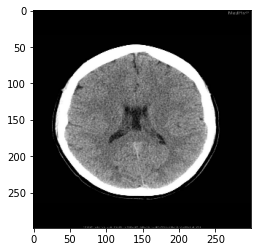

 21%|██        | 301/1434 [56:22<4:12:36, 13.38s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: this single noncontrast ct image of the brain demonstrates unfused laminae of the septum pellucidum with fluid filled cavity between the near parallel laminae , consistent with cavum septum pellucidum .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial noncontrast ct of the head demonstrates a hyperdense material in the right cerebral hemisphere with a hyperdense blood products extending into the suprasellar cistern .


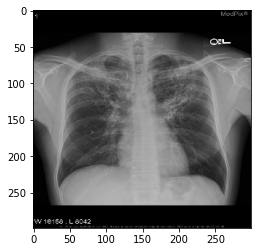

 21%|██        | 302/1434 [56:35<4:09:44, 13.24s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa view of the chest shows patchy alveolar opacities within the bilateral upper lobes .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large left lung zone of the mass effect on the left lung zone . there is no evidence of pleural effusion or pneumothorax .


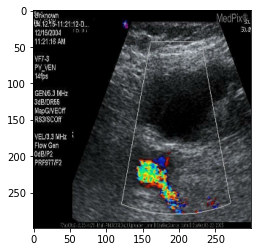

 21%|██        | 303/1434 [56:43<3:40:31, 11.70s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: cardiovascular findings: doppler ultrasound shows thrombosis of [UNK] . native common femoral artery is in far field .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal view of the left testicle demonstrates a tubular structure with a tubular structure within the left ovary .


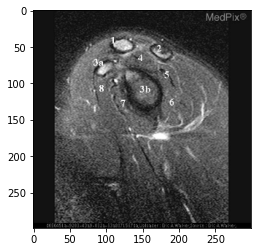

 21%|██        | 304/1434 [57:00<4:08:34, 13.20s/it]

ORIGINAL ----------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: sagittal oblique mr shoulder 03 1 . distal clavicle 2 . acromion 3a . coricoid process 3b . glenoid fossa 4 . supraspinatus muscle 5 . infraspinatus muscle 6 . teres minor muscle 7 . subscapularis muscle 8 . coracobrachialis short head of biceps muscles


AI GENERATED ------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: sagittal proton density weighted mr image demonstrates a tear of the medial meniscus with a high signal intensity lesion which is seen on the t2 weighted fat saturation images which is present within the medial meniscus with a small amount of the adjacent to the adjacent to the patellar tendon .


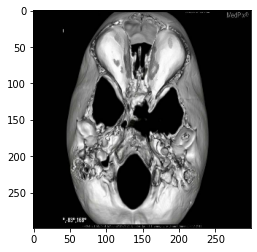

 21%|██▏       | 305/1434 [57:12<4:01:41, 12.84s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: 3d reconstruction anatomy: head and neck findings: notice the extensive bony destruction involving the left sphenoid bone , clivus , and dorsum [UNK] suggesting neoplastic destruction .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: ct of the neck and neck demonstrates a nondisplaced fracture of the left maxillary sinus which extends from the left maxillary sinus . the neck demonstrates a tooth suspended within the mass .


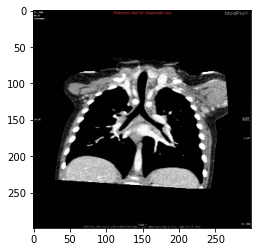

 21%|██▏       | 306/1434 [57:21<3:40:54, 11.75s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: cardiovascular findings: double aortic arch . right and left branches are visible on either side of the trachea . in this case , the arches are at a similar level .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: cardiovascular findings: coronal ct image with contrast demontrates enlargment of the proximal descending aorta with a large amount of the proximal descending aorta .


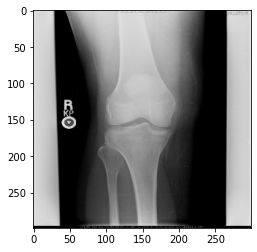

 21%|██▏       | 307/1434 [57:39<4:14:13, 13.53s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: irregularity of the medial tibial plateau with increased density seen on the lateral view .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap and lateral radiographs of the left knee demonstrate a well defined , well defined , well circumscribed , well circumscribed , homogeneous , irregular sclerotic lesions , which is present , which is present , which is present in the medullary continuity with the medullary continuity with the medullary continuity with the medullary continuity with the cortex .


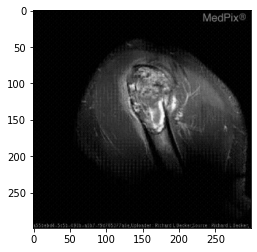

 21%|██▏       | 308/1434 [57:48<3:47:27, 12.12s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: musculoskeletal findings: heterogenous mild enhancement post contrast .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal mr of the shoulder 04 1 . coricoid process 2 . right clavicle 3 . deltoid muscle 5 . deltoid muscle


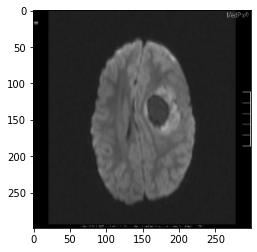

 22%|██▏       | 309/1434 [57:55<3:19:34, 10.64s/it]

ORIGINAL ----------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: large intra-axial mass involving the left frontal and parietal lobes . mass has a large cystic component , that does not have restricted diffusion - a differential feature vs . abscess .


AI GENERATED ------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: multiple lesions with restricted diffusion in the left parietal lobe .


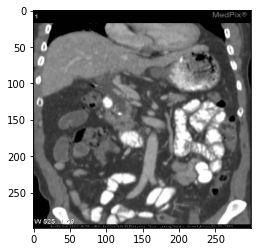

 22%|██▏       | 310/1434 [58:03<3:02:45,  9.76s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi contrast plane: coronal anatomy: abdomen findings: ct image coronal reconstruction demonstrating a stone in the common bile duct lumen with associated common and intrahepatic ductal dilation .


AI GENERATED ------------
core modality: an modality: cta - ct angiography plane: coronal anatomy: cardiovascular findings: filling defect in right pulmonary/segmental artery . right sided pleural effusion and right lobe .


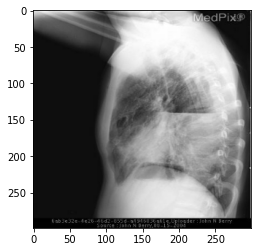

 22%|██▏       | 311/1434 [58:16<3:22:36, 10.83s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: lateral chest radiograph shows an air-fluid level , sillhouetting of the left hemidiaphram , compression of the gastric bubble , and air space disease in the left lower lobe and lingula .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: frontal radiograph of the chest demonstrates a large mass with calcifications in the right lower lobe . there is a large , pleural effusion , and air space narrowing of the right lower lobe , and left hemithorax .


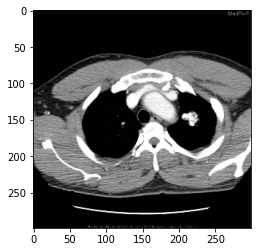

 22%|██▏       | 312/1434 [58:26<3:16:24, 10.50s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial contrast enhanced ct image of the thorax at the level of the aortic arch demonstrate a well circumscribed nodule in the lul , with multiple clumps of calcium or ‘popcorn’ calcifications dispersed throughout the lesion


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: axial ct images demonstrate a large , lobulated , lobulated , lobulated , mass arising from the esophagus and extending into the esophagus .


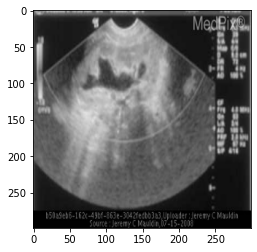

 22%|██▏       | 313/1434 [58:36<3:15:55, 10.49s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: ultrasound demonstrates hydronephrosis of the left kidney .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: right kidney with large heterogeneous mass with cystic components irregular contour . there is a large amount of the right kidney with a large amount of surrounding edema .


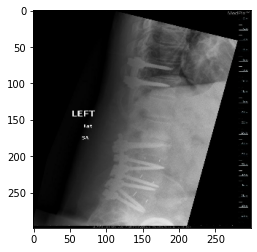

 22%|██▏       | 314/1434 [58:42<2:52:26,  9.24s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: figure demonstrating positioning of hardware of lumbar spine .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: spine findings: fusion of disc space at the level of l5 vertebral body


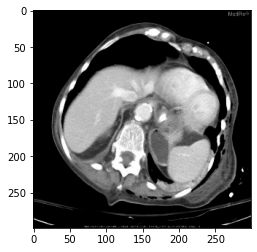

 22%|██▏       | 315/1434 [58:55<3:11:35, 10.27s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: small air-fluid level in a lesion adjacent to or contiguous with the stomach .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images through the lower abdomen demonstrate a large , mass , edematous pancreas with surrounding fat stranding , and surrounding the liver parenchyma . the mass is seen in the left renal vein .


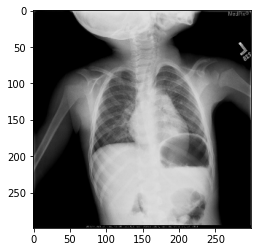

 22%|██▏       | 316/1434 [59:17<4:16:39, 13.77s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: frontal view of the chest with ill defined round left retrocardiac opacity with questionable air bronchograms .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: frontal radiograph of the chest radiograph demonstrates a large mass with a large mass arising from the left hemithorax . the mass is noted to the left upper lobe of the left lower lobe and demonstrates a large metallic coils present within the left hemithorax . the left hemithorax is seen in the left hemithorax is seen in the left upper lobe . there is a large body is no evidence of the left hemithorax .


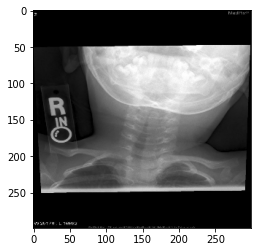

 22%|██▏       | 317/1434 [59:31<4:15:40, 13.73s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: head and neck findings: frontal radiograph demonstrates [UNK] narrowing .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left foot demonstrates a lytic lesion with a lytic lesion in the left femoral neck . there is a narrow zone of transition and lytic lesion with sclerotic margins are present . there is no periosteal reaction .


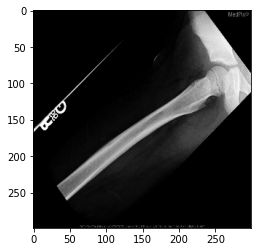

 22%|██▏       | 318/1434 [59:40<3:50:09, 12.37s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: musculoskeletal findings: frog leg view of the right femur demonstrates an oval cortical lucency with surrounding periosteal reaction in the lateral proximal aspect of metaphysis .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: there is a lytic lesion with sclerotic margin , which appears to the proximal tibia and periosteal reaction .


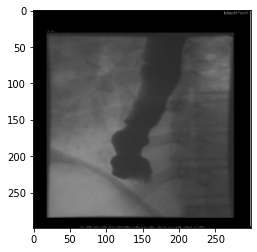

 22%|██▏       | 319/1434 [1:00:00<4:35:12, 14.81s/it]

ORIGINAL ----------------
core modality: bas modality: bas - barium swallow plane: oblique anatomy: abdomen findings: flouroscopic spot image demonstrates tertiary contractions . under realtime flouroscopic observation there was esophagus demonstrated [UNK] .


AI GENERATED ------------
core modality: bas modality: bas - barium swallow plane: oblique anatomy: abdomen findings: barium swallow study demonstrating a barium swallow study from a barium swallow study from a large extrinsic compressive atelectasis in the left upper quadrant with a large extrinsic mass . there is a large mass in the left kidney , which is a large amount of the left upper quadrant with a large mass . there is a large , punctate calcificaiton within which likely represents dystrophic calcification from fat necrosis .


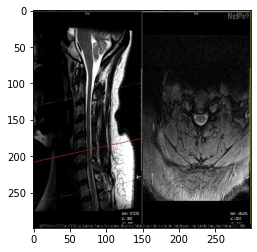

 22%|██▏       | 320/1434 [1:00:24<5:26:45, 17.60s/it]

ORIGINAL ----------------
core modality: mr modality: mr t2 gradient , gre , mpgr , swan , swi plane: sagittal anatomy: musculoskeletal findings: diffuse disc bulge with effacement of the anterior csf is present at the c5-c6 level with some deformity of the spinal cord . there is slight right foraminal narrowing .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a 1 . 1 cm osteolytic mass involving the right side of the right side of the right vertebral body which is a 2 . the 2 cm x 2 . the left paramedian bulge is a 1 x 1 . the left paramedian bulge is noted . there is mild compression there is mild compression there is mild compression of the right side of the spinal cord is a mild posterior disc bulge of the right facet joint . there is a small


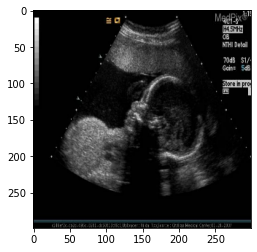

 22%|██▏       | 321/1434 [1:00:37<4:57:27, 16.04s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: musculoskeletal findings: [UNK] and [UNK] belly .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a large heterogeneous mass with a mass arising from the left ovary and the left ovary . the mass is seen within the lateral wall is not shown .


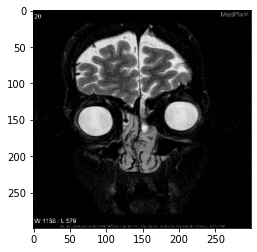

 22%|██▏       | 322/1434 [1:00:46<4:19:51, 14.02s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: generalized findings: coronal slice demonstrating lesion


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: brain findings: coronal t2 weighted image demonstrates a large mass in the left lateral ventricle with a large amount of surrounding edema in the right hemisphere .


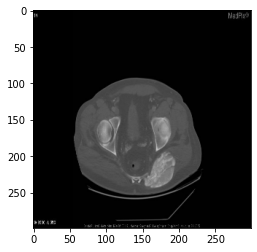

 23%|██▎       | 323/1434 [1:01:00<4:17:17, 13.89s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: musculoskeletal findings: a single axial ct image demonstrates a homogenously dense calcific density arising in the left gluteal muscles . there is no involvement of the underlying pelvic bones .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct images of the pelvis demonstrate a large , lobulated , lobulated , mass , irregular , irregular , irregular , enhancing , and mass , and , with areas of the soft tissue mass effect on the right ilium .


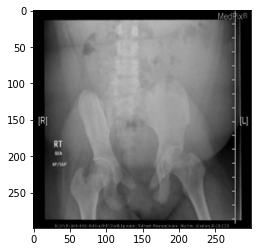

 23%|██▎       | 324/1434 [1:01:16<4:32:29, 14.73s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: generalized findings: pelvic [UNK] wide diastasis of the pubic symphysis , hypoplastic pubic [UNK] .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the pelvis demonstrates a large lytic lesion in the right femoral neck with a large mass , which is seen in the right femoral neck . there is mild amount of the mass effect on the right femoral neck . there is mild focal area of decreased perfusion to the right femoral head .


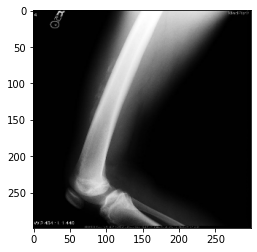

 23%|██▎       | 325/1434 [1:01:26<4:01:36, 13.07s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the right femur a [UNK] ossified mass in the soft tissues of the medial right thigh there is mature trabecular bone at the periphery with a lucent center . there is a clear zone between the ossification and the adjacent cortex .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the left knee demonstrates a well-defined geographic margined , with sclerotic margins and sclerotic border .


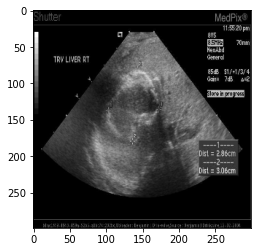

 23%|██▎       | 326/1434 [1:01:35<3:40:32, 11.94s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: abdomen findings: f/u us of hepatic liver abscess . the abscess wall has thickened further , with increased hyperechogenicity , suggesting calcification . the abscess contents appear to be [UNK] .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: the right kidney is a hyperechoic lesion with a hyperechoic area . no evidence of central canal is seen .


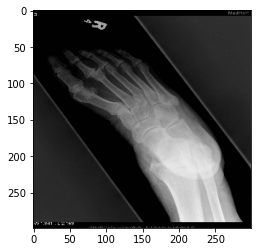

 23%|██▎       | 327/1434 [1:01:45<3:30:13, 11.39s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: sclerosis and collapse of the second metatarsal head . there is narrowing of the 2nd mtp joint space , expansion of the phalangeal base and widening of the second metatarsal shaft with cortical thickening . there is medial subluxation of the base of the proximal phalanx .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap and lateral radiographs of the left hand demonstrate a non-displaced fracture of the distal radius with ulnar styloid process fracture .


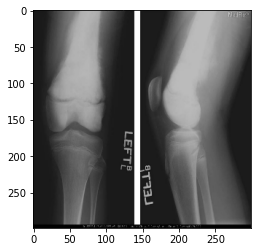

 23%|██▎       | 328/1434 [1:01:56<3:26:09, 11.18s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: the distal femur is visualized with marked sclerosis which also involves the epiphysis . there is periosteal elevation surrounding the lesion and new bone formation . .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left knee demonstrates a well-defined geographic , rounded density in the proximal tibia , with sclerotic margins , with sclerotic margins are present .


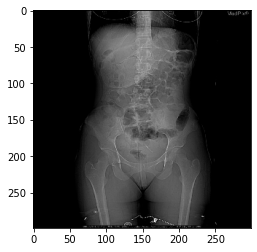

 23%|██▎       | 329/1434 [1:02:12<3:52:37, 12.63s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: ct scout view: markedly enlarged stomach . an intraluminal mottled mass similar in appearance to a [UNK] stomach . there is [UNK] iud device projected over the [UNK] . also visible metal [UNK] [UNK] hardware , [UNK] , and a metal [UNK] .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: abdomen findings: plain film shows a large , lobulated , lobulated , lobulated , lobulated , lobulated , lobulated , destructive mass arising from mass arising from the nasopharynx and extending from the mass extends into the body of the base of the nasopharynx , into the right upper quadrant .


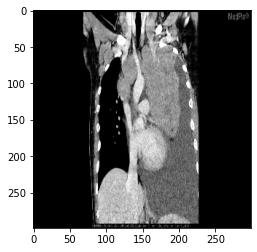

 23%|██▎       | 330/1434 [1:02:36<4:54:43, 16.02s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: generalized findings: the patient was found to have massive mediastinal lymphadenopathy and a large pleural effusion which caused his collapsed lung . in addition there was a small pericardial effusion .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: spine findings: there is a large heterogeneous mass arising from the left lower quandrant adjacent to the proximal esophagus , which is present . the aorta is not shown was seen to the ct images demonstrate a large amount of the left of the lumen of the left lower lobe , there is a large amount of the left lower lobe , and small bowel wall thickening of the adjacent to the aorta . there is a small amount of perinephric fluid collection are also present .


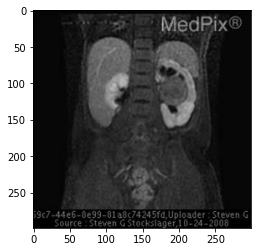

 23%|██▎       | 331/1434 [1:02:45<4:19:54, 14.14s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: coronal anatomy: genitourinary findings: coronal fame post contrast demonstrates a small right kidney with evidence of post-surgical changes to the inferior pole . the left kidney enlarged with dilated calyces and an obstructing mass in the interpolar region with heterogeneous composition .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: genitourinary findings: coronal t2 weighted mr image demonstrates a large mass in the right kidney with a large amount of surrounding edema .


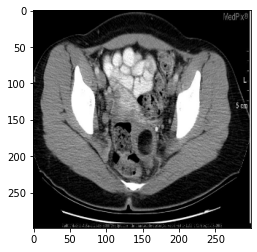

 23%|██▎       | 332/1434 [1:02:55<3:52:07, 12.64s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi contrast plane: axial anatomy: genitourinary findings: contrast enhanced ct scan of the pelvis . a smaller left ovarian teratoma , measuring 4 . 0x3 . 7 cm is seen to contain a larger fat content . other abdominopelvic organs are displaced , but otherwise normal .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: dilated appendix with periappendiceal fat stranding . small foci of extraluminal air and small bowel wall thickening .


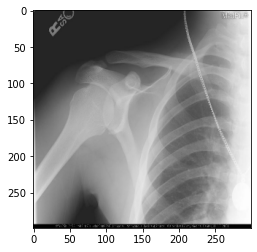

 23%|██▎       | 333/1434 [1:03:05<3:41:09, 12.05s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: there is a defect in the posterolateral humeral head . in addition , there is an osseous body anterior and inferior to the glenoid .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left shoulder demonstrates a large lytic lesion with a lytic lesion of the humeral head of the proximal tibia and proximal humerus .


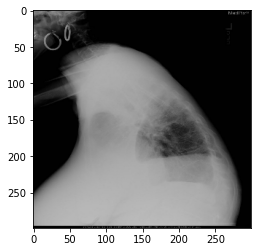

 23%|██▎       | 334/1434 [1:03:18<3:42:03, 12.11s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: lateral image demonstrates the pleural effusions . the extensive venous congestion likely [UNK] to the lack of penetration throughout the image . breast enlargement is [UNK] the patient's kyphosis .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: frontal and lateral radiographs of the chest demonstrate a large mass with associated soft tissue mass arising from the middle lobe of the middle lobe of the middle lobe of the heart border .


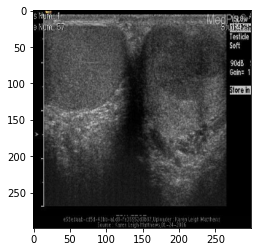

 23%|██▎       | 335/1434 [1:03:26<3:21:02, 10.98s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: homogeneous right testicle and heterogeneous left testicle


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the right testicle demonstrates a hypoechoic mass with a thin rim of the left testicle .


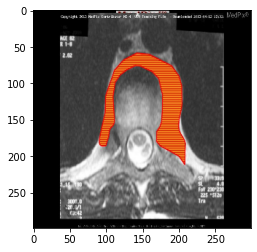

 23%|██▎       | 336/1434 [1:03:38<3:25:21, 11.22s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: the paraspinal mass shaded area can be seen in images 79-89 , showing vertebral destruction as well . the mass wraps completely around the vertebrae as it is followed down in the images . it is evident on these images that the abscess has not invaded the vessels .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: spine findings: multiple lesions with both sides of the spinal cord .


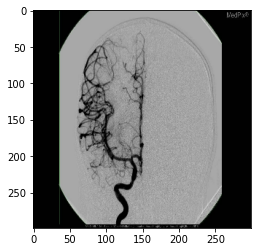

 24%|██▎       | 337/1434 [1:03:49<3:25:41, 11.25s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: coronal anatomy: generalized findings: angiography was requested by the rheumatologist to confirm findings of the mra .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: sagittal anatomy: brain findings: there is a 5 mm aneurysm arising from the right middle cerebral artery .


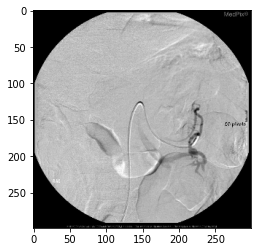

 24%|██▎       | 338/1434 [1:03:59<3:21:00, 11.00s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: sagittal anatomy: abdomen findings: super-selective superior mesenteric arteriogram demonstrating the high grade av fistula of a jejunal artery with a jejunal vein with an interconnecting aneurysm obliqued view .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: selective catheterization of right common carotid artery with an aneurysm


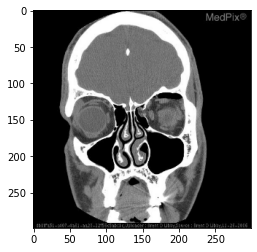

 24%|██▎       | 339/1434 [1:04:17<3:55:41, 12.91s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: direct coronal ct of the maxillofacial region demonstrates a fracture of the left lamina papyracea with herniation of orbital fat into the ethmoid air cells . there is a moderate amount of orbital air . there is no evidence of orbital floor fracture .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: coronal ct image of the head demonstrates a soft tissue mass in the left maxillary sinus , ethmoid sinuses and frontal sinus .


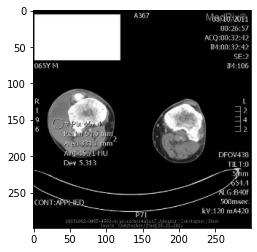

 24%|██▎       | 340/1434 [1:04:26<3:33:36, 11.71s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: musculoskeletal findings: focal fluid consolidation on the lateral aspect of the right knee , consistent with a hematoma .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: axial anatomy: musculoskeletal findings: multiple flow in the left knee


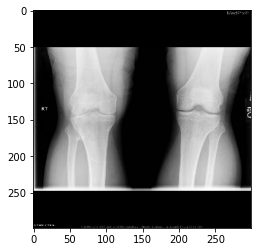

 24%|██▍       | 341/1434 [1:05:02<5:49:19, 19.18s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: musculoskeletal findings: [UNK] view of the knees shows uniform joint space narrowing without osteophyte formation . an erosion on the lateral aspect of the tibial plateau is shown . [UNK] osteoporosis is also present .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left knee demonstrates a large lytic lesion in the proximal tibia with a lytic lesion of the proximal tibia , with a narrow zone of transition . there is a lytic lesion is present within the proximal tibia , which is periosteal reaction , and lytic lesion . there is a thin sclerotic margin of the medial femoral metaphysis is mild endosteal scalloping of the distal femur .


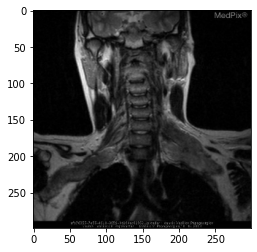

 24%|██▍       | 342/1434 [1:05:13<5:04:46, 16.75s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: brain findings: coronal t2-weighted image demonstrates multiple bilateral masses of the exiting cervical spine nerve roots and brachial plexus nerves , which are more consistent with schwannomas .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: spine findings: intramedullary mixed signal intensity mass


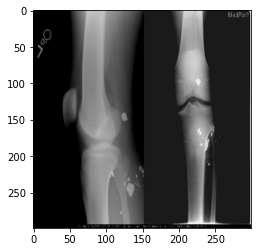

 24%|██▍       | 343/1434 [1:05:52<7:01:44, 23.19s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: cardiovascular findings: initial views of the left knee at 1420 hours on the day of injury in iraq . a large metallic fragment projects over the popliteal fossa on the knee radiograph .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a large lytic lesion with a lytic lesion in the distal femur , with a narrow zone of transition and a narrow zone of transition . the lesion is present within the lesion has a narrow zone of transition . there is no other fractures are evident . there is a focal , punctate calcificaiton within which likely represents dystrophic calcification within it .


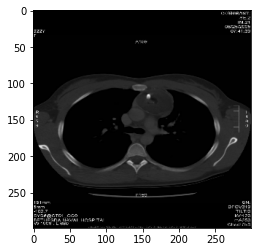

 24%|██▍       | 344/1434 [1:06:16<7:10:03, 23.67s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: well-circumscribed mass within anterior mediastinum containing solid tissue components as well as fat and calcium . tooth better defined within mass in this ct image . it has mass effect on adjacent structures .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: musculoskeletal findings: axial ct images of the chest demonstrate a large , lobulated , lobulated , lobulated , mass arising from the mass destroys the right lower lobe , and left upper lobe , and left lower lobe , and left lung nodule .


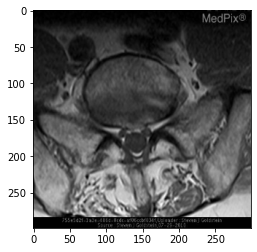

 24%|██▍       | 345/1434 [1:06:34<6:37:53, 21.92s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: spine findings: l5/s1


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: spine findings: extradural , extradural , mass producting significant mass is present in the mass is in the adjacent to the adjacent degenerated facet joint .


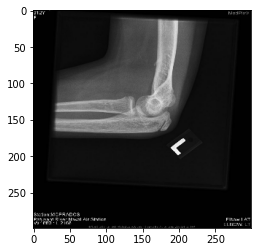

 24%|██▍       | 346/1434 [1:06:52<6:17:25, 20.81s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: small ossification extending from the anterior distal humerus toward the joint


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left knee demonstrates a well-defined lytic lesion with a lytic lesion in the proximal tibia and proximal tibia , which is present with a narrow zone of transition . there is a narrow zone of transition point of transition . there is no periosteal reaction , there is no evidence of fracture .


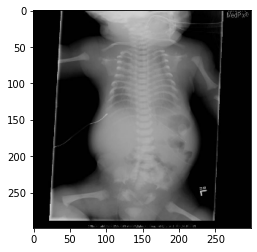

 24%|██▍       | 347/1434 [1:07:01<5:09:09, 17.06s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: long narrow chest and relatively short ribs anterior aspects of the ribs are bulbous and irregular clavicles have a [UNK] configuration


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: frontal radiograph of the abdomen demonstrates a large mass in the stomach , and gastric antrum .


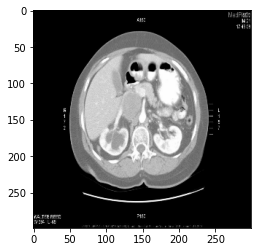

 24%|██▍       | 348/1434 [1:07:10<4:26:08, 14.70s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: [UNK]


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images through the lower abdomen demonstrate a large amount of surrounding inflammatory changes of the liver , with surrounding inflammatory changes .


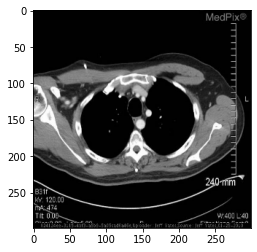

 24%|██▍       | 349/1434 [1:07:17<3:43:23, 12.35s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: axial ct image with contrast shows cystic and varicose bronchiectasis of the second order bronchi . minimal to no bronchial wall thickening is present . otherwise , lung parenchyma is normal . axial ct image with contrast shows incidental aberrant right subclavian artery .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: multiple filling defects in the right lower lobe .


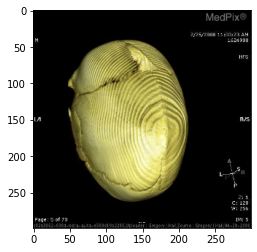

 24%|██▍       | 350/1434 [1:07:30<3:45:32, 12.48s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: 3d reconstruction anatomy: brain findings: 3-d reconstruction demonstrates closed sagittal suture


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: sagittal anatomy: brain findings: there is a 1 . 5 cm ap x 1 . 0 cm mass in the right lateral ventricle with the mass effect on the lateral ventricle . the mass has been resected and does not enhance .


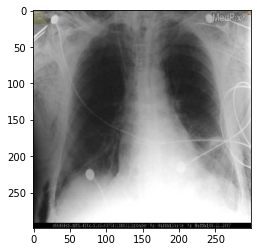

 24%|██▍       | 351/1434 [1:07:39<3:30:54, 11.68s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: final chest x-ray with small residual subcutaneous emphysema and full expansion of the lung .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: there is a large mass in the left upper lobe with air space and air space opacity in the left lower lobe .


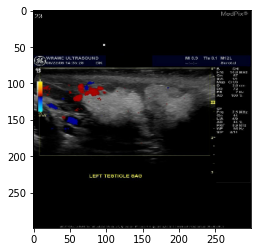

 25%|██▍       | 352/1434 [1:07:48<3:11:44, 10.63s/it]

ORIGINAL ----------------
core modality: us modality: us-d - doppler ultrasound plane: sagittal anatomy: genitourinary findings: sagittal color doppler ultrasound image of the left testis demonstrates a hyperechoic lesion without significant vascularity .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal view of the left testicle demonstrates a tubular structure with a tubular structure within the left testicle .


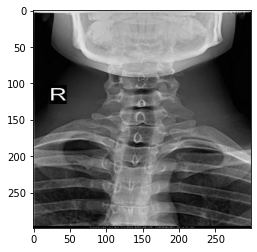

 25%|██▍       | 353/1434 [1:07:57<3:03:05, 10.16s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: cervical x-ray taken in ap view . cervical vertebral body heights are well maintained . there is congenital autofusion with intervertebral disc space narrowing at the c4-c5 level . prevertebral soft tissues are unremarkable .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: ap view of the chest demonstrates an abnormal vertebral bodies in the right vertebral bodies with sclerotic margins .


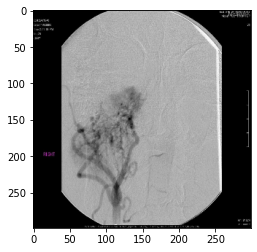

 25%|██▍       | 354/1434 [1:08:05<2:53:13,  9.62s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: pa anatomy: head and neck findings: ap common carotid angiogram reveal very vascular tumor fed only by external carotid branches .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: ap anatomy: cardiovascular findings: selective left renal artery injection , left ica , left ica , left mca , and angiography .


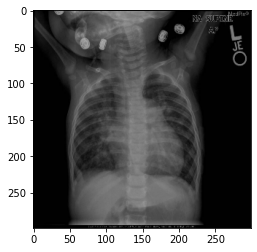

 25%|██▍       | 355/1434 [1:08:14<2:48:15,  9.36s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: cardiovascular findings: ap cxr . note mild cardiomegaly and atrial enlargment . there are prominent pulmonary veins noted with large indistinct vessels well beyond the hilum .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap radiograph of the abdomen demonstrates a large mass in the stomach , and gastric fundus .


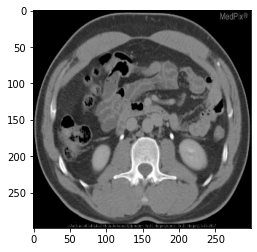

 25%|██▍       | 356/1434 [1:08:31<3:29:35, 11.67s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: delayed contrast axial ct image below the level of the renal vein demonstrates the left ivc as it is about to communicate with the left renal vein .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: genitourinary findings: axial ct image of the abdomen demonstrates a large , rounded , enhancing , enhancing , round , in the right kidney , enhancing , with a mass effect on the left renal vein , and , there is a large retroperitoneal chains , as well as well as well as the right kidney .


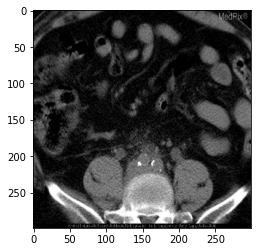

 25%|██▍       | 357/1434 [1:08:45<3:43:51, 12.47s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: bilateral ureteral dilation


AI GENERATED ------------
core modality: an modality: cta - ct angiography plane: coronal anatomy: abdomen findings: large , rounded mass in the right hepatic lobe , measuring approximately 7 cm . 7 cm . there is no evidence of contrast . there is a large amount of surrounding inflammatory change in the liver is associated soft tissue stranding .


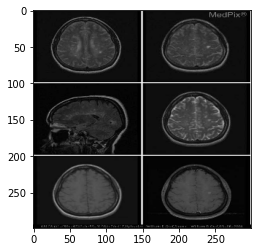

 25%|██▍       | 358/1434 [1:08:53<3:18:11, 11.05s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: brain findings: axial t2w images demonstrate areas of high signal in the subcortical white matter . on the sagittal images , the areas of high signal are arranged radial to the corpus callosum . on the axial t1w post-gadolinium images , a single area seen on the t2w images shows intense enhancement .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: large , heterogeneous mass with surrounding edema and parietal lobes .


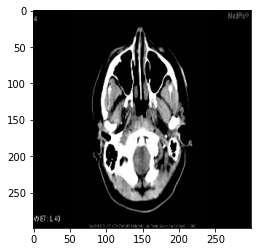

 25%|██▌       | 359/1434 [1:09:03<3:13:05, 10.78s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: noncontrast axial ct image of the brain demonstrates downward herniation .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: axial ct images through the neck demonstrate a lobulated , lobulated , mass arising from the mass arising from the nasopharynx of the sphenoid sinus .


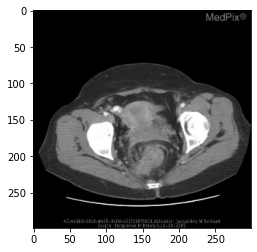

 25%|██▌       | 360/1434 [1:09:09<2:45:48,  9.26s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: significant presacral and pelvic lymphadenopathy . mucosal thickening .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: dilated appendix with periappendiceal fat stranding .


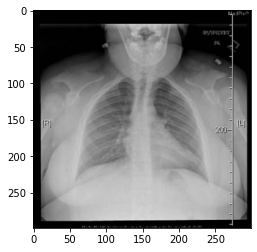

 25%|██▌       | 361/1434 [1:09:21<3:01:48, 10.17s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: generalized findings: chest [UNK] absent left clavicle , hypoplastic or absent right clavicle . cone shaped thoracic cavity . hypoplastic scapula


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: pa and lateral chest radiographs demonstrate a large mass in the right upper lobe , lingula and right lower lobe . peripherally based pulmonary parenchymal opacities are present with bilateral pleural effusions are present .


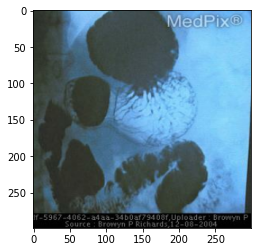

 25%|██▌       | 362/1434 [1:09:34<3:18:28, 11.11s/it]

ORIGINAL ----------------
core modality: bas modality: bas - barium swallow plane: coronal anatomy: abdomen findings: contrast filled [UNK] diverticulum in the second part of the [UNK] . no filling defects are present .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: abdomen findings: spot image from a barium swallow study from a barium swallow study from a barium swallow study from a second smaller v3 segment of the right posterior communicating with a left upper quadrant mass .


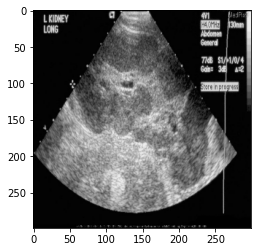

 25%|██▌       | 363/1434 [1:09:41<2:56:13,  9.87s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: diffusely enlarged , lobulated contour and multiple hypoechoic peripheral masses


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal image of the left kidney demonstrates normal appearing to the renal parenchyma .


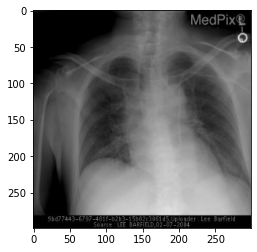

 25%|██▌       | 364/1434 [1:09:52<3:02:40, 10.24s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: cardiovascular findings: an ap portable radiograph of the chest shows a new left subclavian line with its [UNK] and tip to the left of the midline .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: pa radiograph of the chest demonstrates a large mass in the left lower lobe with a left upper lobe mass . there is mediastinal lymphadenopathy .


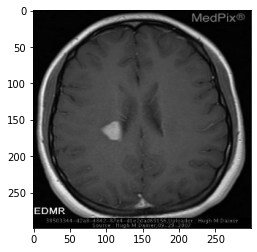

 25%|██▌       | 365/1434 [1:10:02<3:01:14, 10.17s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: within the right corona radiata , there is smooth post-contrast enhancement of the previously noted lesion .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: multiple lesions with some of the basal ganglia . the lesions are hyperintense on t2 and flair and flair sequences . no restricted diffusion .


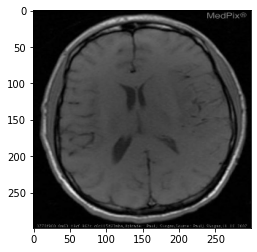

 26%|██▌       | 366/1434 [1:10:10<2:49:20,  9.51s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: axial t1 weighted image demonstrates low signal intensity in the left greater than right insula secondary to surrounding edema , with no evidence of hyperintensity to suggest the presence of subacute blood products .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: multiple enhancing lesions with some of the basal ganglia . no restricted diffusion .


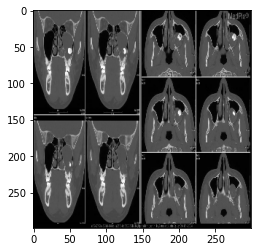

 26%|██▌       | 367/1434 [1:10:20<2:48:16,  9.46s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: head and neck findings: companion case of a [UNK] [UNK] that contains a molar tooth . the [UNK] is located within the left maxillary sinus , extending cephalad to abut the inferior orbital floor . there is mild expansion of the posterolateral , inferior sinus cavity with associated marked cortical thinning .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: musculoskeletal findings: noncontrast ct images demonstrate a large lytic lesion with sclerotic margins with sclerotic margins and associated soft tissue mass


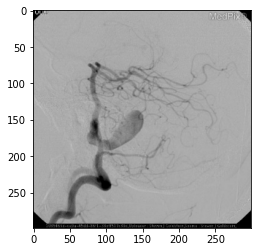

 26%|██▌       | 368/1434 [1:10:27<2:35:29,  8.75s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: sagittal anatomy: brain findings: giant fusiform aneurysmdolichoectasia , left vertebral artery , partially coiled .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: sagittal anatomy: brain findings: right frontal lobe mass with edema in the frontal sinus . no restricted diffusion .


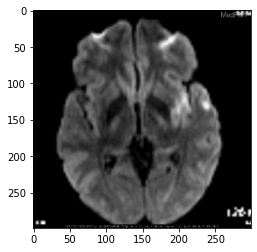

 26%|██▌       | 369/1434 [1:10:36<2:38:26,  8.93s/it]

ORIGINAL ----------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: cardiovascular findings: dwi image confirms acute infarction


AI GENERATED ------------
core modality: mr modality: mr - dwi diffusion weighted plane: axial anatomy: brain findings: multiple ring enhancing lesions in the basal ganglia . minimal mass effect and restricted diffusion on dwi images .


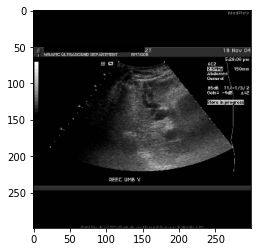

 26%|██▌       | 370/1434 [1:10:44<2:34:43,  8.72s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: abdomen findings: recannalized paraumbilical vein is a hypoechoic serpiginous tubular structure in the region of the ligamentum teres between the left medial and left lateral segments of the liver .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: transverse sonographic image of the left kidney demonstrates a normal appearing to the left kidney .


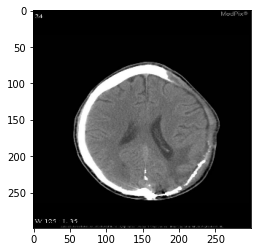

 26%|██▌       | 371/1434 [1:10:53<2:33:36,  8.67s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: a large portion of the left side of this patient's skull was removed to [UNK] intracranial hypertension .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct image demonstrates a large mass in the right frontal lobe with associated edema and parietal lobes .


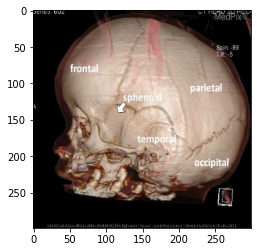

 26%|██▌       | 372/1434 [1:11:12<3:28:07, 11.76s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: 3d reconstruction anatomy: musculoskeletal findings: synostosis of the sagittal suture with ridging along the closed suture line . elongation of the skull in the sagittal anterior-posterior direction . labels: frontal bone sphenoid bone lateral portion temporal bone squamous portion occipital bone


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: 3d reconstruction anatomy: head and neck findings: 3d reconstruction of the right side of the head of the head demonstrates a large , lobulated , lobulated , enhancing , lobulated , lobulated , mass arising from the floor of the floor of the skull base of the right middle cranial fossa , petrous apex and extending into the middle cranial fossa .


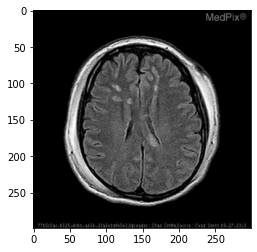

 26%|██▌       | 373/1434 [1:11:23<3:24:12, 11.55s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: brain 10/08 mri flair – bilateral scalp swelling and hemorrhage . abnormal signal hyperintensity within bilateral frontal lobes and body of corpus callosum .


AI GENERATED ------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial flair image demonstrates a large mass in the right frontal lobe with associated edema in the right frontal lobe . mass is hyperintense on t2 and flair sequences .


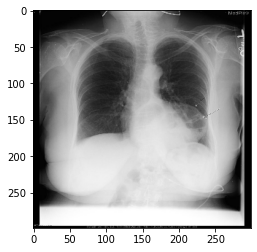

 26%|██▌       | 374/1434 [1:11:33<3:14:39, 11.02s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: abdomen findings: the fundus projects over the left thorax and mediastinum . an air fluid level is within the fundus of the stomach . as an incidental finding , the patient has an intrathecal [UNK] pump for chronic back pain and muscle spasms .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa chest radiograph demonstrates a large mass in the left upper lobe with a large left lung nodule .


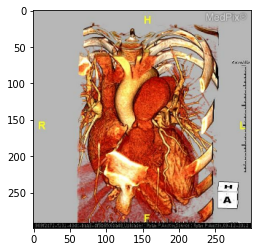

 26%|██▌       | 375/1434 [1:11:44<3:16:22, 11.13s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: 3d reconstruction anatomy: cardiovascular findings: 3d reconstruction of dilated main pulmonary artery


AI GENERATED ------------
core modality: gr modality: gr - gross photograph plane: photograph anatomy: brain findings: there is a large left frontal lobe mass with evidence of necrosis . the lesion has a large flow voids in the right middle lobe with a large amount of surrounding hematoma .


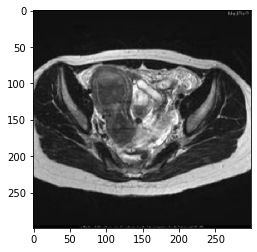

 26%|██▌       | 376/1434 [1:11:53<3:02:43, 10.36s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: genitourinary findings: [UNK] in right uterine horn with hematocrit effect


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: axial anatomy: genitourinary findings: axial t2 weighted images demonstrate a mass in the right kidney with a large amount of surrounding edema .


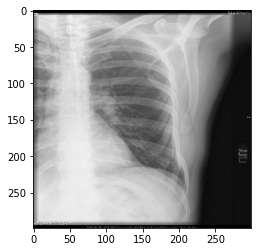

 26%|██▋       | 377/1434 [1:12:01<2:51:39,  9.74s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: coned down view shows opacity in left lung base , with [UNK] extensions connecting toward the hilum


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large left pleural effusion .


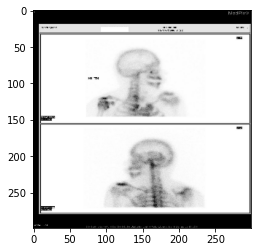

 26%|██▋       | 378/1434 [1:12:10<2:48:13,  9.56s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: sagittal anatomy: musculoskeletal findings: tc-99m hdp delayed bilateral lateral views of the skull . left lateral image demonstrates typical pattern of paget in the skull osteoporosis circumscripta , with increased radiotracer uptake at the edges of a round lesion affecting the temporal bone .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: delayed images of the left hip demonstrate a focal area of increased uptake in the right femoral neck .


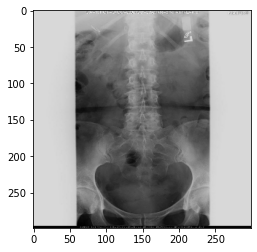

 26%|██▋       | 379/1434 [1:12:20<2:47:49,  9.54s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: bone lesions are not well visualized on the frontal exam


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap radiograph of the abdomen demonstrates a small bowel wall thickening of the stomach with a small bowel wall and gas to the abdomen .


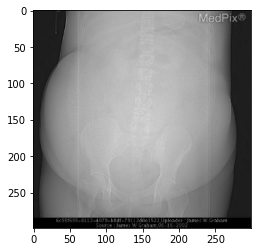

 26%|██▋       | 380/1434 [1:12:36<3:20:40, 11.42s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: abdomen findings: [UNK] of bowel , [UNK] abdomen , and increased opacity consistent with ascites .


AI GENERATED ------------
core modality: int modality: interventional procedure plane: coronal anatomy: abdomen findings: fluoroscopic image demonstrates a single catheter in the left ureter . the left ureter is consistent with a single fluoroscopic images demonstrate a single single thin walled cysts within the left kidney is seen in the left ureter is consistent with the left of the left kidney . the left kidney .


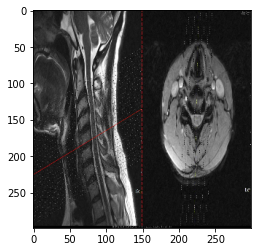

 27%|██▋       | 381/1434 [1:12:45<3:11:42, 10.92s/it]

ORIGINAL ----------------
core modality: mr modality: mr - montage plane: multiple or montage anatomy: spine findings: slight retrolisthesis of c5 over c6 disc herniation with protrusion and posterior spurring [UNK] mm . [UNK] bilateral foraminal stenosis on right


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a large heterogeneous mass with central canal stenosis with mild central canal stenosis . no evidence of abscess or foraminal stenosis .


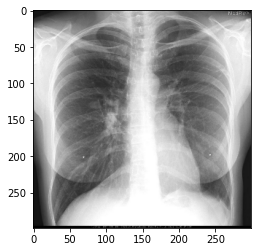

 27%|██▋       | 382/1434 [1:13:00<3:34:01, 12.21s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a well marginated oval shaped opacity overlying the right 7th posterior rib interspace , in mid-clavicular line . this opacity is within the anterior segment of the right upper lobe and represents a mucus-plugged bronchi . also there are linear “tram-track” markings radiating from left hilar region peripherally towards the axilla . these markings are consistent with tubular markings of bronchiectasis . note: because of her pectus excavatum sternum the heart is shifted and rotated - making the left heart border main pulmonary artery look more prominent .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa chest radiograph demonstrates a large mass in the left upper lobe with a left lung zone of the mass effect on the left lung zone . there is no evidence of pleural effusion or pneumothorax .


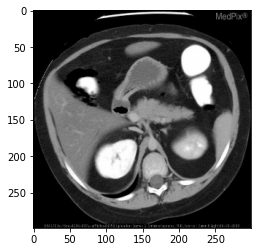

 27%|██▋       | 383/1434 [1:13:21<4:17:09, 14.68s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: musculoskeletal findings: note: patient was scanned prone . [UNK] of the ascending colon is likely related to vasculopathy as is the assymetric renal perfusion .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: abdomen findings: ct images through the lower abdomen demonstrate a large mass , irregular contour of the liver , which measures 2 . 5 cm in the left lower lobe , and abdominal aorta . there is a 5 . 5 cm mass in the left lower lobe . the left lower lobe , there is a large amount of the liver , punctate calcificaiton within which likely represents dystrophic calcification within fat necrosis .


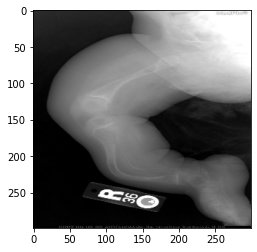

 27%|██▋       | 384/1434 [1:13:30<3:45:14, 12.87s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: the tibia and fibula are thin and bowed . all bones are severely osteopenic . old fracture of the femur is noted .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left shoulder demonstrates a large lytic lesion with sclerotic margins with a lytic lesion .


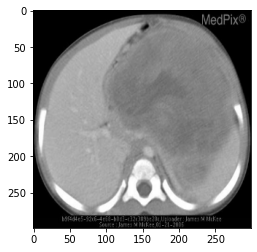

 27%|██▋       | 385/1434 [1:13:40<3:30:08, 12.02s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: genitourinary findings: large solid left renal fossa mass which has significant mass effect upon the spleen and liver . there is heterogenous enhancement .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial ct image through the liver demonstrates a large , rounded , rounded , rounded , and peripheral enhancement of the liver lesion .


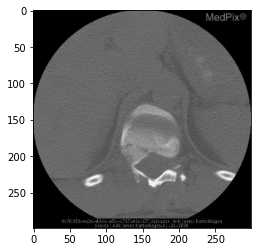

 27%|██▋       | 386/1434 [1:13:49<3:16:16, 11.24s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: spine findings: fracture of t11 – ct image 5 of 6


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: spine findings: fracture through the right pedicle of right lateral recess and right pedicle at c4 . dysmorphic lateral mass , and ventral paraspinal rim enhancing lesion .


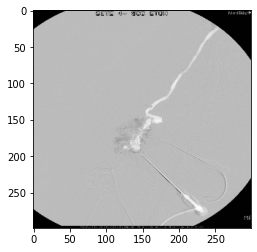

 27%|██▋       | 387/1434 [1:13:57<2:58:30, 10.23s/it]

ORIGINAL ----------------
core modality: int modality: interventional procedure plane: sagittal anatomy: musculoskeletal findings: digitally subtracted image during injection of absolute ethanol reveals negative contrast within the venous malformation .


AI GENERATED ------------
core modality: an modality: an - angiogram plane: coronal anatomy: cardiovascular findings: selective left subclavian artery , left subclavian artery arising from the esophagus and coursing from the esophagus .


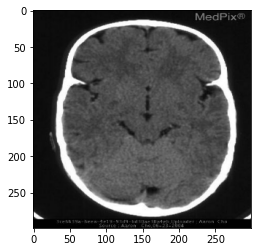

 27%|██▋       | 388/1434 [1:14:02<2:32:25,  8.74s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct image demonstrates normal intracranial contents without brain dysgenesis .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct- dense right frontal convexity meningioma


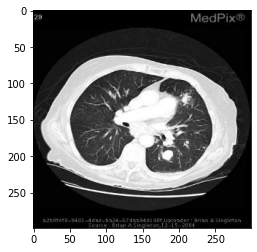

 27%|██▋       | 389/1434 [1:14:13<2:45:00,  9.47s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: genitourinary findings: chest ct shows there are multiple pulmonary metastatic lesions .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: axial ct images demonstrate a large , lobulated , lobulated , mass arising from the right upper lobe of the lung base of the lung with mediastinal adenopathy and upper lobe .


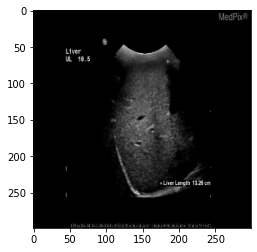

 27%|██▋       | 390/1434 [1:14:25<2:54:59, 10.06s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: coronal anatomy: generalized findings: the liver length is 13 . 26 cm and the upper limit of normal is 10 . 5 cm .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: sagittal anatomy: genitourinary findings: sagittal sonographic image of the left kidney demonstrates a large heterogeneous mass with a mass arising from the left ovary . the mass is seen within the lumen of the bladder wall .


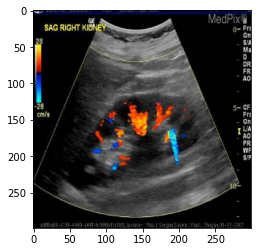

 27%|██▋       | 391/1434 [1:14:41<3:24:42, 11.78s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: color doppler longitudinal view of the lower pole of the right kidney demonstrates a [UNK] artifact confirming this echogenic focus is a renal calculi .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal ultrasound of the left kidney demonstrates a hypoechoic mass with a large cystic mass extending into the left ovary . the mass is seen within the left ovary and measures approximately 2 . there is no evidence of hydronephrosis and no evidence of blood flow within normal .


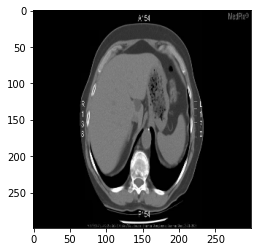

 27%|██▋       | 392/1434 [1:14:48<3:02:52, 10.53s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial image 1


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial ct images through the lower thorax and pelvis following administration of the administration of the gastroesophageal junction .


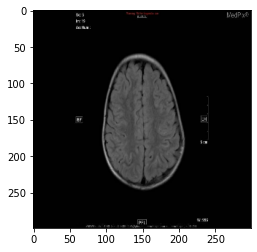

 27%|██▋       | 393/1434 [1:14:56<2:50:48,  9.84s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: generalized findings: this slide is included as a comparison for the post-treatment images which will be shown later .


AI GENERATED ------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial flair image demonstrates a lesion in the left parietal lobe with a large cystic lesion with surrounding edema .


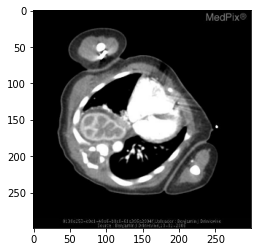

 27%|██▋       | 394/1434 [1:15:10<3:09:01, 10.91s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: contrast enhanced axial ct of the chest shows the right kidney in a suprahepatic location , within the right hemithorax .


AI GENERATED ------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: cardiovascular findings: contrast enhanced axial ct images through the chest demonstrate a large , lobulated , lobulated , lobulated , lobulated , mass arising from the mass extending into the left upper lobe of the left hemithorax , and body and mediastinal adenopathy .


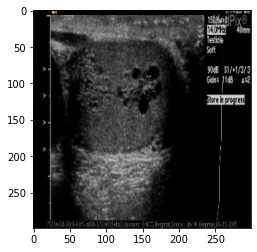

 28%|██▊       | 395/1434 [1:15:18<2:55:01, 10.11s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: multiple [UNK] structures in mediastinum of testis without color flow .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: axial anatomy: genitourinary findings: transverse sonographic image of the right testicle demonstrates a hypoechoic mass with a thin rim of the left testicle .


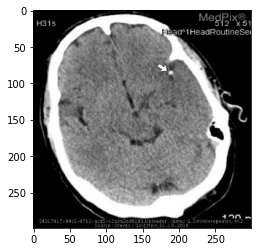

 28%|██▊       | 396/1434 [1:15:30<3:04:04, 10.64s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: hyperdense middle cerebral artery on left . extensive low [UNK] area of cerebral infarction in the mca territory . there is loss of gray-white distinction and subtle effacement of the sulci .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct scan hemorrhagic infarct right frontal lobe . no evidence of hemorrhage . mri reveals brain edema in the right frontal lobe of brain with venous infarct . no evidence of hemorrhage .


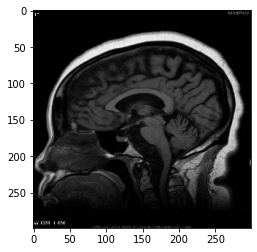

 28%|██▊       | 397/1434 [1:15:40<3:01:58, 10.53s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: sagittal anatomy: brain findings: sagittal t1-weighted flair image demonstrates a low intensity mass similiar to csf in signal , which is anterior to the brainstem and posterior to the clivus . the mass extends from the optic nerve , superiorly , to below the craniocervical junction , inferiorly .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: sagittal t1 weighted image demonstrates a large mass in the right cerebellum with a large amount of surrounding edema .


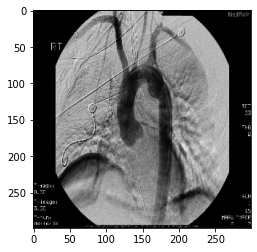

 28%|██▊       | 398/1434 [1:15:49<2:53:53, 10.07s/it]

ORIGINAL ----------------
core modality: an modality: an - angiogram plane: oblique anatomy: cardiovascular findings: digitally subtracted thoracic aortogram in lao [UNK] irregular wall contours on both sides of the proximal descending thoracic aorta at level of the aortic isthmus with associated outpouching pseudoaneurysm anteriorly


AI GENERATED ------------
core modality: int modality: interventional procedure plane: coronal anatomy: cardiovascular findings: fluoroscopic and delayed images demonstrate a large filling defects in the right lower lobe of the left lower lobe pulmonary artery .


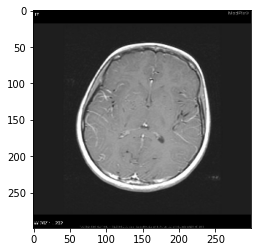

 28%|██▊       | 399/1434 [1:15:57<2:42:26,  9.42s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: t1 ax post gad: ivy sign . bright signal in engorged collateral vessels of the leptomeninges .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: there is a large mass in the left frontal lobe with associated edema and cystic component .


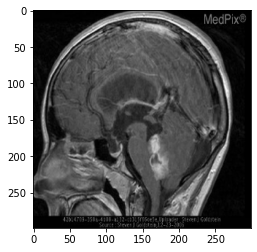

 28%|██▊       | 400/1434 [1:16:07<2:42:17,  9.42s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: fourth ventricular mass causing hydrocephalus . the mass enhances irregularly with both fluid cystic and solid components . it extends towards and widens the aqueduct confirming its intraventricular location .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: sagittal anatomy: brain findings: enhancing mass in the third ventricle extending into suprasellar cistern . mass has both cystic and solid components . no hydrocephalus .


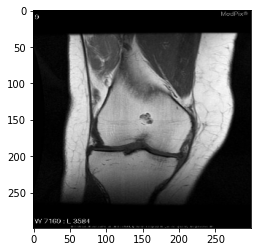

 28%|██▊       | 401/1434 [1:16:19<2:59:34, 10.43s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal t1 image of the knee shows a lobular lesion of intermediate signal intensity centered at the level of the physeal scar . the lesion has punctate areas of low signal consistent with calcifications , as well as interspersed areas of high signal consistent with fat . the appearance and location are typical for enchondroma .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal mr image demonstrates a well defined , rounded lesion in the medial meniscus with a high signal intensity on the medial meniscus , which is seen on the mr images .


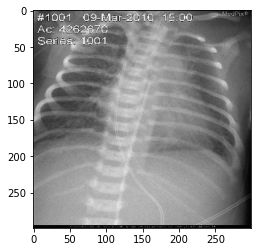

 28%|██▊       | 402/1434 [1:16:42<4:04:13, 14.20s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: cardiovascular findings: cardiomegaly with pulmonary edema


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: pa radiograph of the chest demonstrates a large mass with a large mass arising from the left upper lobe of the left hemithorax that is mediastinal adenopathy . the mass is noted is present . there is a large amount of the left lower lobe of the mass is evidence of the pulmonary vasculature and there is mediastinal lymphadenopathy . there is no evidence of the left hemithorax that are clear . there is evidence of consolidation is evidence of the left hemidiaphragm .


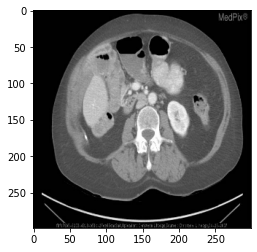

 28%|██▊       | 403/1434 [1:16:58<4:09:35, 14.53s/it]

ORIGINAL ----------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images with contrast show the inversion of smv-sma relationship with the smv rotating from the right of sma to the left of the sma . the small bowel is noted to be in the right side of abdomen , large bowel is noted to be in left side of abdomen .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: axial ct images through the lower pelvis demonstrate a large , mass , enhancing , heterogeneously enhancing , lobulated , enhancing , lobulated , lobulated , and mass arising from the mass arising from the left hemipelvis without evidence of the left kidney .


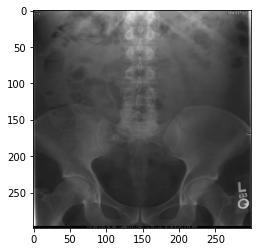

 28%|██▊       | 404/1434 [1:17:05<3:30:54, 12.29s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: abdomen findings: kub showing calcification in right lower quadrant


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: multiple small bowel loops of small bowel loops of small bowel in the abdomen


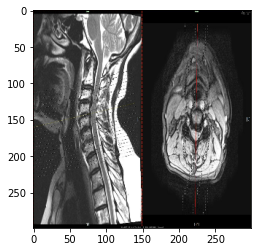

 28%|██▊       | 405/1434 [1:17:16<3:25:31, 11.98s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: multiple or montage anatomy: spine findings: sagittal and corresponding transverse views of t2 mri at the c4-5 level


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: sagittal anatomy: spine findings: there is a large fluid collection in the posterior aspect of the left vertebral body with mild compression of the left vertebral body . there is a small amount of hemorrhage .


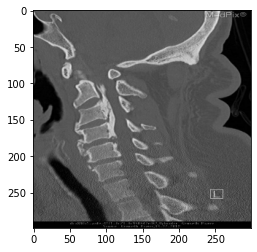

 28%|██▊       | 406/1434 [1:17:25<3:10:19, 11.11s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: spine findings: ct sagittal with opll at the c2-6 levels


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: musculoskeletal findings: fracture dislocation at c6-7 locked facets on left side perched facets on left side of left side of left side of c6 body .


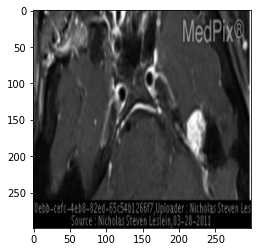

 28%|██▊       | 407/1434 [1:17:34<3:00:43, 10.56s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: head and neck findings: axial fat-sat t1 post-contrast . avidly enhancing , well-demarcated , ovoid lesion in the left geniculate ganglion . perineural spread along facial nerve probably present .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: musculoskeletal findings: coronal t2 weighted image demonstrates a high signal intensity mass in the left femoral neck with a lesion .


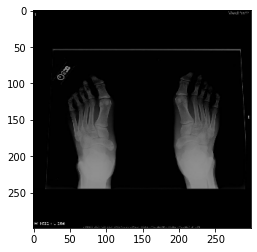

 28%|██▊       | 408/1434 [1:17:55<3:53:24, 13.65s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: plain radiograph of the feet shows bilateral accessory navicular bones without other bony abnormality .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left hand demonstrates a lytic lesion in the proximal phalanx of the proximal phalanx . there is a non-displaced spiral fracture lucency at the proximal phalanx . there is a narrow zone of the base of the base of the left femur with a narrow zone of the soft tissue mass is a narrow zone of the remainder of the soft tissue density is a joint space is present .


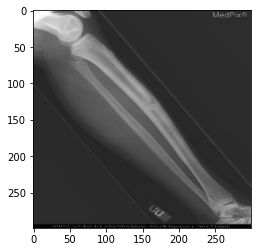

 29%|██▊       | 409/1434 [1:18:04<3:28:51, 12.23s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: mixed lytic and sclerotic osseous lesion , anterior tibial diaphysis . lesion is predominantly cortical .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: musculoskeletal findings: lateral radiograph of the left hand demonstrates a vertical trabeculae and a large soft tissue mass in the left humerus .


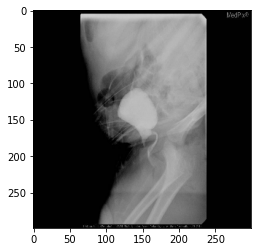

 29%|██▊       | 410/1434 [1:18:13<3:12:25, 11.27s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: spine findings: image : [UNK] showing the [UNK] origin from the distended bladder . also note the hypoplasia of the femurs and increased soft tissue surrounding the diaphyses of the femurs .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap radiograph of the abdomen demonstrates a small bowel wall thickening of the stomach and gas to the abdomen .


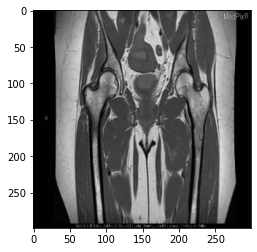

 29%|██▊       | 411/1434 [1:18:34<4:03:14, 14.27s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: circumscribed isointense mass witin the medullary canal of the proximal left femur . mild thinning of the cortex .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal t1 weighted image demonstrates a large heterogeneously enhancing mass with associated soft tissue mass arising from the femoral neck . the mass is present in the body of the region of the femoral head of the neck . there is a large body and the left hemipelvis without evidence of the mass is no evidence of the left femoral neck . there is some associated soft tissue mass effect or edema .


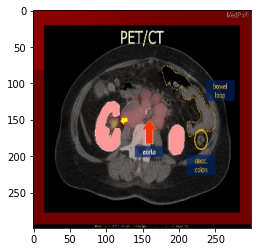

 29%|██▊       | 412/1434 [1:18:50<4:11:49, 14.78s/it]

ORIGINAL ----------------
core modality: pet/nm modality: pet-ct fusion plane: axial anatomy: abdomen findings: bulky retroperitoneal and iliac adenopathy with increased fdg metabolic activity in pink . also labeled: aorta with intimal calcification in the rim bowel loop descending colon kidneys pink renal pelvis yellow arrow with high activity urine


AI GENERATED ------------
core modality: pet/nm modality: pet-ct fusion plane: axial anatomy: abdomen findings: axial image through the liver demonstrates a large , rounded , rounded , rounded , and heterogeneous enhancement of the gallbladder wall , with an area of the lumen of the appendix fails to opacify with enteric contrast . there is prominent peri-appendiceal fat stranding without peri-appendiceal fluid collection or free air .


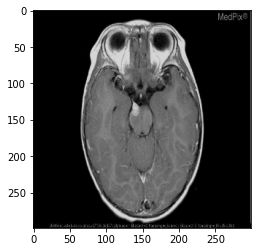

 29%|██▉       | 413/1434 [1:18:59<3:37:59, 12.81s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: axial anatomy: brain findings: axial t1 flair , post contrast , demonstrates a fusiform enhancing mass extending into the dorsal midbrain and interpenduncular cistern measuring 10 x 16 x 6 mm


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gadolinium plane: axial anatomy: brain findings: multiple enhancing lesions with some of the basal ganglia . no mass effect or pathologic enhancement .


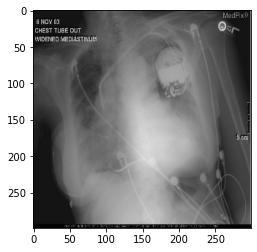

 29%|██▉       | 414/1434 [1:19:10<3:29:13, 12.31s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: an anterior chest tube was placed , the pneumothorax was reduced . this image was taken shortly after the removal of the chest tube . the patient was [UNK] , [UNK] , and hypotensive . note the opacification of the left lung apex , shift of mediastinum to right , and bowing of the trachea to the right . the image demonstrates an acute hemothorax .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: abdomen findings: ap view of the chest demonstrates a large mass in the left lower lobe with a large amount of surrounding soft tissue mass .


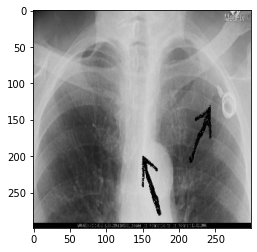

 29%|██▉       | 415/1434 [1:19:33<4:24:56, 15.60s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: cardiovascular findings: fracture of the port catheter . the distal tip is located in the right atrium .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: pulmonary findings: frontal view of the chest demonstrates a large mass with a large mass arising from the left upper lobe of the left hemithorax that is mediastinal adenopathy and thoracic inlet . the mass is noted . the mass is seen in the left upper and the left upper lobe posteriorly . the patient was seen . the thoracic inlet . the thoracic aortography . the mass is normal in the left upper lobe posteriorly , there is seen . there is no evidence of contrast infusion


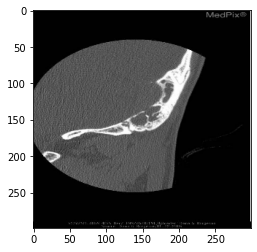

 29%|██▉       | 416/1434 [1:19:45<4:08:37, 14.65s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: coronal anatomy: head and neck findings: ct image at different level exhibits boney erosion of the left mastoid process with possible extension of infection into the posterior fossa .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: sagittal anatomy: head and neck findings: there is a soft tissue mass arising from the left maxillary sinus which extends into the left maxillary sinus . there is extension into the left maxillary sinus tract extending into left maxillary sinus .


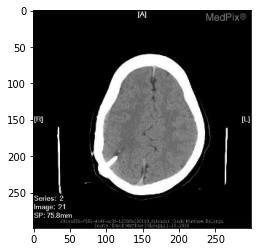

 29%|██▉       | 417/1434 [1:19:56<3:47:03, 13.40s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: note interdigitation cerebral hemispheres at the interhemispheric fissure


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: there is a large extra-axial mass with associated hemorrhage in the right frontal lobe and hyperdense blood . there is a large amount of surrounding edema in the right lateral ventricles .


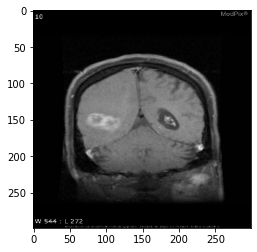

 29%|██▉       | 418/1434 [1:20:04<3:21:44, 11.91s/it]

ORIGINAL ----------------
core modality: mr modality: mr - flair plane: coronal anatomy: brain findings: coronal t1 post-gadolinium demonstrating a left posterior neck mass with similar appearance and enhancement to the intraaxial mass .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: coronal t1 weighted mr image demonstrates a large cystic lesion in the right frontal lobe with cystic component .


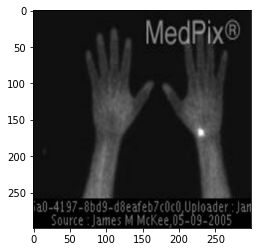

 29%|██▉       | 419/1434 [1:20:16<3:18:00, 11.71s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: tc-99m mdp bone scan shows intense focal [UNK] pool activity at the left scaphoid .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap and lateral radiographs of the left knee demonstrate a lytic lesion of the proximal tibia , and cortical destruction of the distal femur , which is a narrow zone of transition .


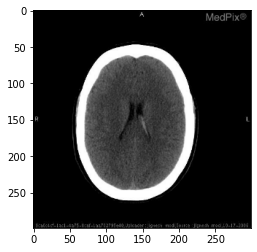

 29%|██▉       | 420/1434 [1:20:26<3:11:39, 11.34s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: hyperdense material in the left lateral ventricle


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial noncontrast ct of the head demonstrates a hyperdense lenticular extraaxial fluid collection of the right frontal lobe with a mass effect with a thin septation present about the lateral ventricles .


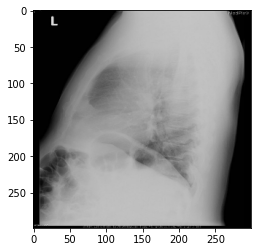

 29%|██▉       | 421/1434 [1:20:35<2:57:31, 10.51s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: head and neck findings: soft tissue density in superior aspect [UNK] clear space


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: sagittal anatomy: pulmonary findings: frontal radiograph of the chest demonstrates a large mass with multiple pulmonary nodule in the right lower lobe .


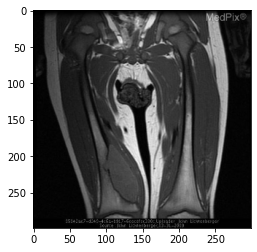

 29%|██▉       | 422/1434 [1:20:43<2:46:49,  9.89s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: coronal t1w precontrast mr image demonstrates an [UNK] intensity mass in the distal femoral metaphysis with overlying cortical erosion .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: musculoskeletal findings: coronal t2 weighted image demonstrates a large heterogeneous lesion with low signal intensity rim of low signal intensity .


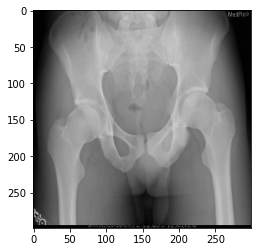

 29%|██▉       | 423/1434 [1:20:56<3:02:44, 10.85s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: bilateral osseous [UNK] at femoral head neck junction with increased radius at the waist . the patient is slightly rotated and [UNK] assessment of cross over sign is limited however , there is prominent anterior acetabulum lateral to the posterior rim bilaterally . note osseous density adjacent to lateral acetabulum .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hip demonstrates a lytic lesion in the left femoral head of the left femoral neck with a narrow zone of transition . there is mild sclerosis is mild periosteal reaction .


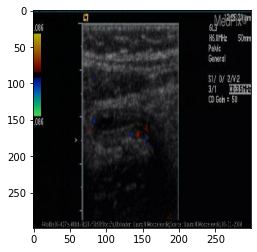

 30%|██▉       | 424/1434 [1:21:04<2:46:42,  9.90s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: thickened blind-ending pouch - appendix .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: genitourinary findings: longitudinal view of the left testicle demonstrates a hypoechoic mass with a tubular structure with a cystic structure .


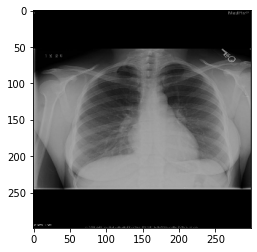

 30%|██▉       | 425/1434 [1:21:18<3:09:26, 11.26s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: pa chest radiograph demonstrates clear lungs with normal mediastinum and pulmonary vasculature . a cervical rib is [UNK] on the right side at the c7 level .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large mass effect on the left heart border on the left . there is a large left pleural effusion is present . there is also a mass in the left pleural effusion .


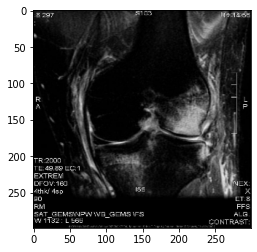

 30%|██▉       | 426/1434 [1:21:28<2:59:31, 10.69s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: musculoskeletal findings: this coronally oriented t2 fat supressed image again shows the marrow edema in the lateral femoral condyle and in the lateral tibial plateau . this is the classic kissing contusion associated with a valgus injury and acl tears . there is also edema in the medial tibial plateau and increased signal around the mcl additional evidence of a valgus injury .


AI GENERATED ------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: sagittal proton density image demonstrates multiple low signal intensity within the lesions of the medial meniscus .


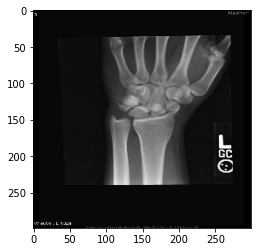

 30%|██▉       | 427/1434 [1:21:38<2:56:03, 10.49s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: the ap radiograph demonstrated [UNK] fractures of both the [UNK] and the scaphoid at the waist .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap view of the left hand demonstrates a non-displaced fracture lucency extending from the proximal tibia and proximal tibia with a non-displaced fracture lucency .


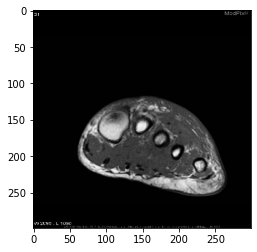

 30%|██▉       | 428/1434 [1:21:47<2:52:27, 10.29s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: notice the abnormal hypointense bone marrow signal within the third metatarsal .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: musculoskeletal findings: axial t1-weighted image demonstrates a large mass lesion with intermediate signal intensity rim enhancement in the adjacent to the proximal aspect of the left femur .


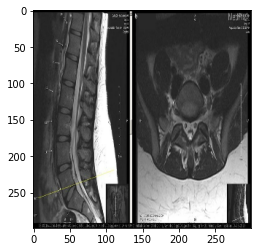

 30%|██▉       | 429/1434 [1:22:04<3:23:46, 12.17s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: multiple or montage anatomy: musculoskeletal findings: at l5-s1 , the canal tapers in diameter due to increased deposition of epidural fat . the disc remains well hydrated and the neural foramina are patent .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: spine findings: there is a 2 cm osteolytic mass involving the right side of the right side of the right side of the spine . the lesion has a large body is slightly heterogeneous enhancement of the right psoas muscle measuring approximately 3 cm in diameter . there is mild adjacent to the right foraminal stenosis .


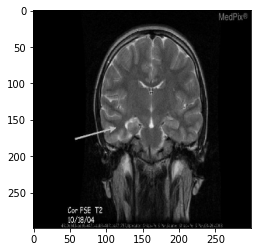

 30%|██▉       | 430/1434 [1:22:12<3:04:06, 11.00s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: brain findings: the right temporal horn is larger than the left arrow and there is reduced hippocampal volume .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: coronal anatomy: brain findings: coronal t2 weighted mr image demonstrates a large mass in the right frontal lobe of the corpus callosum .


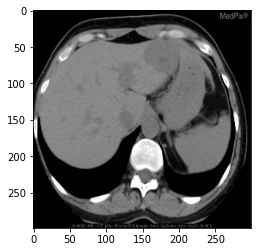

 30%|███       | 431/1434 [1:22:24<3:05:48, 11.12s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial non-contrast ct shows a left lateral hepatic lobe well-circumscribed mass .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: abdomen findings: axial ct image through the liver demonstrates a large , rounded mass in the left lower lobe , which is seen in the left lower lobe , and a large amount of peripheral enhancement .


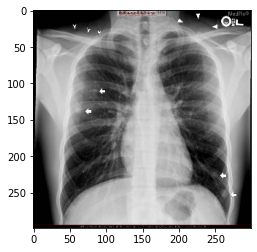

 30%|███       | 432/1434 [1:22:39<3:27:05, 12.40s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: pa anatomy: genitourinary findings: screening chest radiogram shows multiple pulmonary nodules arrows . there is asymmetry of the soft-tissues over the left clavicle arrowheads compared to the right side with a normal clavicular companion shadow [UNK] . this could be caused by a supraclavicular mass or lymphadenopathy .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa chest radiograph demonstrates a large mass in the left upper lobe with a left lung zone of the mass effect on the left hemithorax . the chest wall is noted is present . there is a spiculated 2 cm in the left pleural effusion .


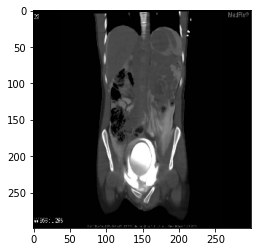

 30%|███       | 433/1434 [1:22:49<3:15:43, 11.73s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: coronal anatomy: genitourinary findings: combined intraperitoneal and extraperitoneal bladder rupture . study [UNK] with iv , but no oral contrast . contrast leaking from bladder fills into a variety of intraperitoneal recesses , and outlines bowel loops intaperitoneal rupture , and fills the prevesical space of retzius and lateral paravesical spaces .


AI GENERATED ------------
core modality: ct modality: ct - gi iv contrast plane: axial anatomy: abdomen findings: coronal ct of the abdomen and pelvis demonstrate a large mass arising from the left kidney with associated soft tissue mass .


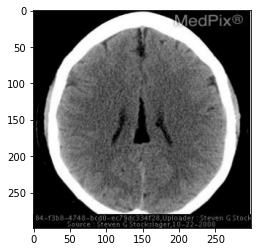

 30%|███       | 434/1434 [1:22:58<3:01:51, 10.91s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial image of non-contrast head ct showing a midline hypoattenuation equivalent to fat that is consistent with corpus callosum lipoma . no evidence of displacement or altered attenuation of the surrounding cerebral parenchyma or skull . no evidence of an ischemic or hemorrhagic insult .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: ct of the brain demonstrates a large left frontal lobe mass with surrounding edema in the right frontal lobe .


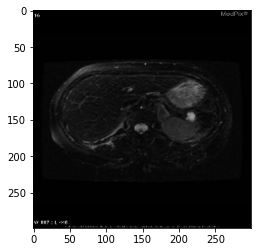

 30%|███       | 435/1434 [1:23:07<2:53:10, 10.40s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: abdomen findings: axial t2 weighted image at the level of the pancreas shows a lobulated high intensity lesion in the tail of the pancreas .


AI GENERATED ------------
core modality: mr modality: mr - t2 weighted plane: axial anatomy: musculoskeletal findings: axial t2 weighted mr image demonstrates a high signal intensity lesion in the left femoral neck consistent with a large cystic lesion .


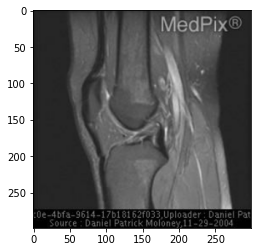

 30%|███       | 436/1434 [1:23:19<2:56:37, 10.62s/it]

ORIGINAL ----------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: the pcl demonstrates a [UNK] appearance . the acl fibers proximally are not connecting to the femur and have an orientation where they appear to arise from the proximal pcl , a location the acl not [UNK] will scar down to . overall the findings are those of complete rupture of the acl


AI GENERATED ------------
core modality: mr modality: mr - pdw proton density plane: sagittal anatomy: musculoskeletal findings: sagittal proton density weighted images demonstrate a small , rounded mass in the medial meniscus with a tear of the intercondylar notch .


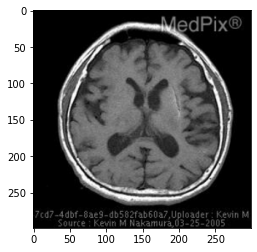

 30%|███       | 437/1434 [1:23:27<2:47:52, 10.10s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: axial t1w mri appearance of left basal ganglia hemorrhage .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: multiple lesions with some of the cerebral hemispheres except for a large ventricles . no mass effect . no restricted diffusion .


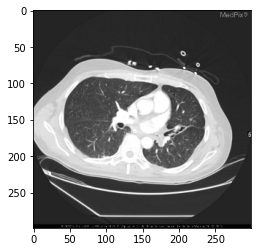

 31%|███       | 438/1434 [1:23:48<3:38:32, 13.17s/it]

ORIGINAL ----------------
core modality: ct modality: ct w/contrast iv plane: axial anatomy: pulmonary findings: again , note the calcifications lying within the left bronchus .


AI GENERATED ------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: pulmonary findings: there is a large , rounded mass in the right upper lobe , lingula and right upper lobe . middle lobe with central necrosis . the right lower lobe are clear . these lesions are present . these are clear . these are clear space disease . the lung fields are present , and the right lower lobe are present , punctate calcificaiton within which likely represents dystrophic calcification from fat necrosis .


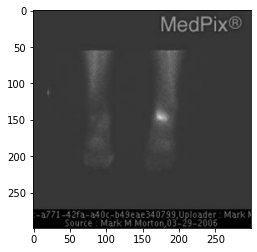

 31%|███       | 439/1434 [1:24:00<3:31:33, 12.76s/it]

ORIGINAL ----------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: frontal blood pool spot view of the left foot and ankle of a tc-99m mdp bone scan . plain radiographs of the left ankle and foot were completed at an outside institution and are unavailable for review . however , they are normal per report . blood pool and delayed images of a tc-99m mdp bone scan demonstrate focal intense uptake at the left tarsal navicular bone .


AI GENERATED ------------
core modality: pet/nm modality: nm - nuclear medicine plane: coronal anatomy: musculoskeletal findings: delayed images of the left hip demonstrate a tc-99m mdp bone scan demonstrate a focal uptake in the right femoral neck , left femur and delayed images .


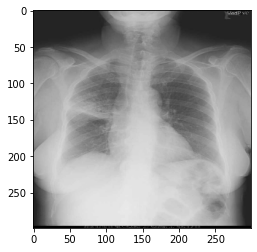

 31%|███       | 440/1434 [1:24:08<3:11:19, 11.55s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: pulmonary findings: frontal radiograph of the chest shows confluent air space opacity within the right upper lobe .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: pa anatomy: pulmonary findings: pa radiograph demonstrates a large mass in the left upper lobe with a large left lung zone , pleural effusion .


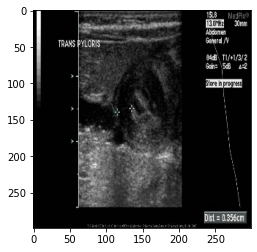

 31%|███       | 441/1434 [1:24:17<2:56:34, 10.67s/it]

ORIGINAL ----------------
core modality: us modality: us - ultrasound plane: axial anatomy: abdomen findings: thickened pyloric channel in transverse plane measuring 3 . 5 mm .


AI GENERATED ------------
core modality: us modality: us - ultrasound plane: longitudinal anatomy: abdomen findings: longitudinal view of the right common bile duct demonstrates a tubular structure with a tubular structure with surrounding the left ovary .


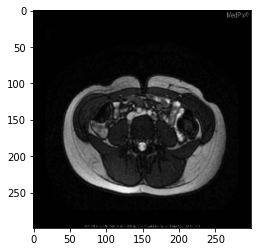

 31%|███       | 442/1434 [1:24:28<3:00:02, 10.89s/it]

ORIGINAL ----------------
core modality: mr modality: mr - fiesta plane: axial anatomy: abdomen findings: free fluid is present along the right paracolic gutter , and in the pelvis . the pancreatic duct does not appear to be enlarged . the pancreas appears normal with no peripancreatic fluid .


AI GENERATED ------------
core modality: mr modality: mr - t1w w/gd fat suppressed plane: axial anatomy: genitourinary findings: axial t2 weighted images demonstrate a large mass in the right kidney , with a large amount of surrounding edema , low signal intensity of the right kidney .


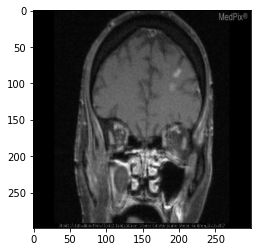

 31%|███       | 443/1434 [1:24:39<2:56:54, 10.71s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w w/gadolinium plane: coronal anatomy: brain findings: left frontal lesions without mass effect and positive contrast enhancement .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: coronal anatomy: brain findings: large , non-enhancing , left frontal lobe mass with surrounding edema in the right lateral ventricle . mass is hyperintense on t2 and flair sequences .


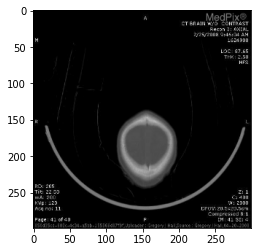

 31%|███       | 444/1434 [1:24:46<2:41:37,  9.80s/it]

ORIGINAL ----------------
core modality: ct modality: ct - noncontrast plane: axial anatomy: brain findings: axial ct demonstrates closure of the sagittal suture


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: axial anatomy: brain findings: axial t1 and t2 images demonstrate a large cystic mass with cystic and solid components .


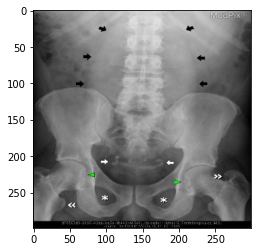

 31%|███       | 445/1434 [1:24:56<2:40:19,  9.73s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: ap anatomy: genitourinary findings: the is a pair of serpentine calcified structures , relatively symmetrical and bilateral in the pelvis white arrows these are the vas deferens . black arrows - psoas muscle green arrowhead - [UNK] [UNK] of femoral head ligament insertion - obturator foramen [UNK] - marks the greater trochanter of femur gluteus medius and minimus insertion [UNK] - marks the lesser trochanter of femur iliopsoas insertion


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: ap radiograph of the left hip demonstrates a lytic lesion with sclerotic margins with sclerotic margins .


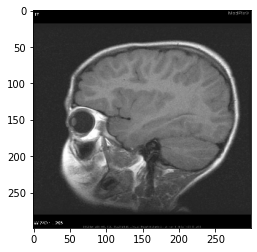

 31%|███       | 446/1434 [1:25:05<2:35:28,  9.44s/it]

ORIGINAL ----------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: head and neck findings: compare the rounded contour of this [UNK] globe to the elongated left globe seen on the sag t1 image of the left .


AI GENERATED ------------
core modality: mr modality: mr - t1w - noncontrast plane: sagittal anatomy: brain findings: there is a large , rounded mass in the right frontal lobe with surrounding edema and parietal lobes .


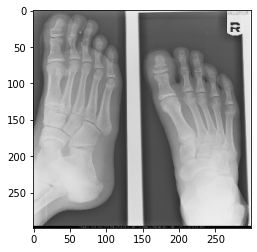

 31%|███       | 447/1434 [1:25:15<2:41:23,  9.81s/it]

ORIGINAL ----------------
core modality: xr modality: xr - plain film plane: coronal anatomy: musculoskeletal findings: ap view – there is widening of the great toe distal phalangeal physes consistent with a salter-harris i .


AI GENERATED ------------
core modality: xr modality: xr - plain film plane: ap anatomy: musculoskeletal findings: there is a lytic lesion in the distal femur , with a lytic lesion of the proximal tibia , with a narrow zone of transition and periosteal reaction .


In [ ]:
# prepare empty lists to hold the resulting captions and tokens
# as well as their true counterparts. 
true_captions_records =[]
true_tokens_records = []

predicted_captions_records= []
predicted_tokens_records = []

for i in tqdm(data_pipeline['captioning']['test']):
# For every sample in the test set:
    # Get the true tokens -----------------------
    text=i['text'] # select text sequence
    tokenized_sequences=model.text_encoder.tokenize(text) # Tokenize the text sequence
    # Change to list format and eliminate <start token>
    tokenized_sequences=list(tokenized_sequences.numpy()[:]) # Convert to list format and
    # Initialize empty lists for all token_sequences/true_captions in a row.
    tokenized_sequences_row=[]
    true_captions_row=[]
    for tokenized_sequence in tokenized_sequences:
        tokenized_sequence = [t for t in tokenized_sequence if t!=0] # Eliminate empty tokens
        tokenized_sequence = tokenized_sequence[1:-1] # Eliminate <start> and <end> tokens.
        tokenized_sequences_row.append(tokenized_sequence)

        # Get true captions ---------------------------
        # Convert each token in the sequence to a word and make a sentence
        true_caption= [model.text_encoder.vocabulary_dict[t] for t in tokenized_sequence]
        true_caption= ' '.join(true_caption)
        true_captions_row.append(true_caption)
        
    true_captions_records.append(true_captions_row) # Save true captions row to records.
    true_tokens_records.append(tokenized_sequences_row) # Save true tokens sequence row to records.
    # Caption prediction process------------------------------------
    # Initialize input data to start caption.
    img=i['image'] # select image
    img=tf.expand_dims(img,0) # Add batch dimension to image
    # Make an image text pair with empty text to begin captioning. 
    batch_data={'image':img,'text':tf.constant('<start> ', shape=(1,))}

    # Iteratively predict next word in the sequence.
    predicted_tokens_sequence=[] # Prepare list to save predicted tokens for this sample. 
    for i in range(99):
    # For every word prediction step up to the sequence length-1:
        # Calculate vocab probabilities for next words. (1,seq_len-1,vocab_size)
        probs = test_step(batch_data)  
        
        # Select the vocabulary indexes with highest probability 
        selection = np.argmax(probs,axis=-1) # predictions for full sequence (1,seq_len-1) 
        # Getting the index for the current prediction step in the full sequence.
        selection = selection[0,i]  # scalar
        
        # If the last predicted token is the '<end>' token
        # then stop the prediction process. 
        if selection==list(model.text_encoder.vocabulary_dict.values()).index('<end>'):
            break
        # Append the token index that corresponds to the 
        # next word in this prediction step to this_tokens.
        predicted_tokens_sequence.append(selection)
        
        # Get the next word in the sequence
        word=model.text_encoder.vocabulary_dict[selection]
        
        # Append the word to the predicted squence
        batch_data['text']=batch_data['text']+' '+word

    # Append predicted token sequence to records.
    predicted_tokens_records.append(predicted_tokens_sequence)
    # Convert predicted caption tokens to string and save to records.
    predicted_caption= [model.text_encoder.vocabulary_dict[t] for t in predicted_tokens_sequence]
    predicted_caption=' '.join(predicted_caption)
    predicted_captions_records.append(predicted_caption)
    
    # Plot image and print captions-------------------------------------------------------
    plt.figure()
    plt.imshow(img.numpy()[0].astype(int))
    plt.show()
    
    # Print original caption
    print('ORIGINAL ----------------')
    for capt in true_captions_row:
        print(capt)
    print('\n')
    
    # Print predicted caption
    print('AI GENERATED ------------')
    print(predicted_caption)

    # Building the results dataframe-------------------------------------------------
    d={}
    # Make a column for each caption within the same row.
    for j,captions_row in enumerate(true_captions_records):
    # For every row
        for i,caption in enumerate(captions_row):
        # for each caption in the row.     
            col_name='true_caption_'+str(i+1) # Generate column name
            if j==0:
            # If this is the first row to process
                d[col_name]=[caption]  
            else:
                d[col_name].append(caption)               
                
    # Make a column for predicted_captions.
    d['predicted_captions']=predicted_captions_records
    
    # Make a column for each token_sequence within the same row.
    for j,token_sequences_row in enumerate(true_tokens_records):
        for i,token_sequence in enumerate(token_sequences_row):
            col_name='true_tokens_'+str(i+1)
            if j==0:
                d[col_name]=[token_sequence]       
            else:
                d[col_name].append(token_sequence)
                
    # Make a column for predicted tokens
    d['predicted_tokens']=predicted_tokens_records
    
    results=pd.DataFrame(d)
    os.makedirs(f'../results/{date_str}/',exist_ok=True)
    results.to_csv(f'../results/{date_str}/results_'+date_str+'.csv',index=False)

# TENSORBOARDS

In [16]:
%load_ext tensorboard 

In [17]:
logdir='../model_logs/pretraining/captioning/'

In [84]:
%tensorboard --logdir {logdir}

# LOAD A SAVED MODEL

## Instantiating the model
You need to use the same parameters that the model had at training. 
You must also use the same pipeline to call the model on some data. 

In [93]:

#Settings
params={
    'IMG_SIZE':(299,299),
    'IMG_BACKBONE':'efficientnetb0',
    'IMG_TRAINABLE':False,
    'EMBEDDING_DIM':300,
    'SEQ_LEN':178 ,
    'NUM_HEADS':2,
    'DROPOUT':0.01,
    'DATA_PATH':'../data/intermediate/inter_medpix.csv',
    'DATA_SPLIT':[0.9,0.05,0.05],
    'DATA_DOWNSCALE':False,               
    'LEARNING_RATE': 0.000135,
}



data_pipeline= build_pipeline(inter_dataset_path=params['DATA_PATH'],
                              image_size=params['IMG_SIZE'],
                              train_val_test_split=params['DATA_SPLIT'])

model= instantiate_captioner(params,data_pipeline)  # Instantiate the model

Building text encoder
Building rest of the model
input images must be floats from 0 to 255 and have (299,299,3) format.



We need to call the model on some data before loading weights

In [94]:
train_data=data_pipeline['captioning']['train'].batch(32)
validation_data=data_pipeline['captioning']['val'].batch(32)
loss=tf.keras.losses.SparseCategoricalCrossentropy(reduction='none',from_logits=False)
opt = keras.optimizers.Adam(learning_rate=params['LEARNING_RATE'])
model.compile(loss=loss, optimizer=opt)
model.fit(train_data.take(1),epochs=1)

1/1 [==============================] - 8s 8s/step - loss: 9.3657 - acc: 0.0000e+00


In [96]:
# Load the weights
model_name='20230120-003903'
model.load_weights('../models/pretraining/captioning/'+model_name) 
date_str=model_name